# Documentation

Data analysis workflow using data inputs from AndroSensor (ver 1.9.6.3) captured at 20Hz (0.05s) interval. Unlike other sensor logger apps, most of the readings from AndroSensor has already been partially processed, thus minimal processing is required from here. Smartphone models used:

1.   Zones 0 to 11: Samsung S7 (Android 8)
2.   Zones 12 and above: Samsung S20+ (Android 10)

Data was taken on a bicycle on various roads and Park Connector Networks (PCN) in Singapore. PCNs are paved with asphalt paths too, making them analogous to roads for testing and also safer for the experimenter due to the lack of motorised traffic. Ideally, the sensors used (phone) should be placed as close to the centre of mass of the vehicle used as possible, and extra care should be taken to measure the exact location of each pothole, making verification easier. Also, it is recommended to used multiple duplicate sensor loggers (phones) to make generalisations between phone models and individual phones possible, and also as a redundancy backup.

Key Target Variables

1.   Linear Acceleration (Z-Axis; rotated to world coordinates; m/s^2)
2.   Horizontal Linear Acceleration (XY-Axes; rotated to world coordinates; m/s^2)
3.   Gyroscope Rotation (X axis; rotated to world coordinates; rad/s)
4.   GPS coordinates (longitude and latitude; degrees)
5.   GPS Accuracy (m)

Quaternion rotation of the linear acceleration and gyroscope values to world coordinates using rotation vector is important in allowing across comparison of sensor data acress different orientations and also to prevent cases of gimbal lock which would cause inconsistent results.

**Initial Findings:**

1.   Separation of the pothole events from non-pothole events Principal Components 
2.   HDBSCAN when applied directly on principal components was ineffective in detecting pothole events

**Change Log:**

Version 2 (Analysis_02):

1.   Instead of using short splices of pothole and non-pothole data, the full record length of the record was used instead (albeit with some noise regions removed) in order the better caption the transition from normal movement to a pothole encounter better and also for data rebalancing issues. Tagging of different event types remained.
2.   Tagging in different event types of the compiled data has been applied directly to the dataset, so tagging in post (as was done for version 1) is no longer required.
3.   The wavelet family used has been changed from cgau1 and gaus1 to cgau8 (final version chosen) and cgau4 (trial) as they produced a higher amplitude signal
4.   The bandpass filter was also adjusted to drop the settings for the more aggressive filter in order to retain more usable data and improve computational speed.
5.   There has also been some optimisation with the calling of variables to make them more dynamic too. However, the selection of wavelet scales and threshold cut off points of the PCs are still manual processes as those steps need manual visual inspection.

Version 3 (Analysis_03):

1.   Threshold suprression applied to CWT Coefficients
2.   Only CWT coeefficients from scales 1 to 10 were used for modelling to capture higher frequency changes
3.   Additional optimisation of the codes to make thresholding more dynamic
4.   More PCs generated
5.   Attempted the use of LOF to detect potholes, but the results were poor
6.   Attempted the use of weighted thresholding to generate the pothole probability with promising results

Version 4 (Analysis_04):

1.   Instead of using all the PCs, only the first 10 were used as they had the best separation of results - this resulted in a speed performance boost and better clustering results (albeit not much)
2.   Added K-means clustering (best performer) on PCs
3.   Additional thresholding was applied to suppress CWT coefficients with lower amplitudes to better clean up the signals
4.   Thresholding to determine variance has been swapped the use of the 75th percentile value for the upper outlier boundary point of the tagged pothole events (median + 1.5 * IQR)

Version 5 (Analysis_05):

1.   Tested DBSCAN methpd on PCs, but results were poor
2.   Reimplemented HDBSCAN on PCs, but results remained poor
3.   Assigned cutoff to pothole probabilities from thresholding to detect potholes
4.   Used an ensemble voting method to determine the existence of suspected potholes using results from k-means clustering and pothole probabilities from thresholding
5.   Applied a hybrid HDBSCAN + DBSCAN geospatial clustering of suspected potholes to mimic crowdsensing application
6.   Added validation of K-means clustering
7.   Added additional validation test of pothole prediction against known pothole ground of truth point (estimated coordinates used). This test does not factor in the model's ability to detect non-potholes. Also, the ground of truth points were not taken exactly over each individual pothole, making this test more of a rough estimate only. GPS precision is also another factor reducing the accuracy of the points.

**Key Findings**

Based on our analysis here, we managed to achieve moderate success in detecting possible potholes through unsupervised learning methods through a combination of:
1.    signal processing (filtering and wavelet transform)
1.    sliding window descriptive stats
1.    weighted thresholding
1.    k-means clustering
1.    geospatial clustering using a hybrid HDBSCAN + DBSCAN

Balancing sensitivity and specificity descrimination of potholes and non-pothole events is a key concern, since many non-pothole events may result in behaviour similar to potholes.

The suspected potholes have been mapped against known potholes via Google Maps:

https://www.google.com/maps/d/edit?mid=1QEkC2QL8fVG3Dh1wiQY0WLXG1IlYsgti 

This could also be done via Excel's 3D Map function, especially if continuous points are to be plotted, most notably to plot the route sections where measurements where taken. This is important since non-pothole regions lack a geotagged image of the zone.

**References**

1.   https://digital.hbs.edu/platform-digit/submission/street-bump-crowdsourcing-better-streets-but-many-roadblocks-remain/
2.   https://dl.acm.org/doi/10.1145/1378600.1378605
3.   https://www.hyd.gov.hk/en/publications_and_publicity/publications/technical_document/guidance_notes/index.html
4.   https://developers.google.com/web/fundamentals/native-hardware/device-orientation
5.   https://doi.org/10.3390/ijgi8090412
6.   https://ieeexplore.ieee.org/document/7522334 
7.   https://www.researchgate.net/publication/328838759_Road_Surface_Monitoring_Using_Smartphone_SensorsA_Review
8.   https://doi.org/10.1061/(ASCE)0733-947X(2005)131:2(120)



# Initialisation

## Install and Load Libraries

In [ ]:
# Install libraries
!pip install pandas --upgrade
!pip install pyxlsb
!pip install PyWavelets
!pip install hdbscan

Requirement already up-to-date: pandas in /usr/local/lib/python3.6/dist-packages (1.0.3)


In [ ]:
# Load libraries
import pandas as pd
import numpy as np
import pywt
from sklearn.decomposition import PCA
from sklearn import preprocessing
import seaborn as sns
import matplotlib.pyplot as plt
import time
from sklearn.neighbors import LocalOutlierFactor
import hdbscan
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from sklearn.model_selection import train_test_split
from geopy import Point
from geopy import distance

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


## Mount Google Drive

In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Define root file directory folder where the files are being stored
# set the root directory as the string following "/content/" where you mounted the google drive
# For the top most folder "gdrive", change it to "drive"
%cd /content/drive/My Drive/Colab Notebooks/LTA_MobSense/roadAnomaly_detect/Module_Import/

# Check directory location
!pwd

/content/drive/My Drive/Colab Notebooks/LTA_MobSense/roadAnomaly_detect/Module_Import
/content/drive/My Drive/Colab Notebooks/LTA_MobSense/roadAnomaly_detect/Module_Import


In [ ]:
# Inspect files in directory
!ls 

iirFilter_butterworth.py  __pycache__		  rotation_quaternion.py
processedPCData_A2.xlsx   rotation_eulerAngle.py


## Load Custom Python Modules

The values we are using from AndroSensor has already been rotated to World Coordinates, so we don't need to perform quaternion rotation here.

In [ ]:
import iirFilter_butterworth as irrFilter

## Load Data Files

This dataset contain wavelets from multiple roadpotholes collected in a survey, spliced together with buffer data added as spacers in between. The data collected was done on a bicycle with front tire suspension. A mixture of roads
and park connectors were chosen for this exercise. It should be noted that the pothole data taken from roads then to be noisier due to safety restrictions in getting sufficient space to accelerate and cruise through a pothole on a busy road. DO NOT TRY THIS AT HOME!

Overview of data loaded:

1. Zone 0 = buffer data (stationary)
2. Zones 1-11 = pothole zones on roads
3. Zones 12-17 = pothole zones on Park Connectors
4. Zone 18 = speed stripes on Park Connectors
5. Zone 19 Run 1 = cycling data (mostly downhill) on road
6. Zone 19 Run 2 = hump data
7. Zone 20 = hump data @ Springside Estate
8. Zone 21 = normal cycling @ Lower Seletar Reservoir Park Connector
9. Zone 22 = speed stripes @ Lower Seletar Reservoir Park Connector


### Load Data

In [ ]:
# File info
#xlsfile = "../MainData/pothole_records_20200316_bike/AndroSensor_S7/combinedWaveletData_v3b.xlsb" # alternative file location
xlsfile = "../MainData/pothole_records_20200316_bike/AndroSensor_Consolidated/combinedWaveletData_v3b.xlsb" # file location
ws = "Data" # name of worksheet

# Load dataframe
df = pd.read_excel(io = xlsfile, sheet_name = ws, engine = 'pyxlsb')

# Inspect Data
df.head()

,SN,ACCELEROMETER X (m/sÂ²),ACCELEROMETER Y (m/sÂ²),ACCELEROMETER Z (m/sÂ²),LINEAR ACCELERATION X (m/sÂ²),LINEAR ACCELERATION Y (m/sÂ²),LINEAR ACCELERATION Z (m/sÂ²),GYROSCOPE X (rad/s),GYROSCOPE Y (rad/s),GYROSCOPE Z (rad/s),LOCATION Latitude :,LOCATION Longitude :,LOCATION Altitude ( m),LOCATION Altitude-google ( m),LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Satellites in range,Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event
0,0,NaN,NaN,NaN,-0.020885,-0.054002,-0.067950,0.000324,-0.002306,0.001333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,115005,2020-03-16 12:35:01:128,NaN,NaN,5.0,0.0,0.0,0
1,1,NaN,NaN,NaN,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,115055,2020-03-16 12:35:01:178,NaN,NaN,5.0,0.0,1.0,0
2,2,NaN,NaN,NaN,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,115104,2020-03-16 12:35:01:227,NaN,NaN,5.0,0.0,2.0,0
3,3,NaN,NaN,NaN,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,115154,2020-03-16 12:35:01:277,NaN,NaN,5.0,0.0,3.0,0
4,4,NaN,NaN,NaN,-0.018470,-0.057635,-0.056414,0.003379,0.000748,0.000111,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,115204,2020-03-16 12:35:01:327,NaN,NaN,5.0,0.0,4.0,0


### Rename Pseudo Index

Not required, as this version's dataset has been indexed before hand

In [ ]:
# Rename first column as a pseudo index col
#df.rename(columns={"Unnamed: 0":'SN'}, inplace=True)

# Inspect Data
df.head()

,SN,ACCELEROMETER X (m/sÂ²),ACCELEROMETER Y (m/sÂ²),ACCELEROMETER Z (m/sÂ²),LINEAR ACCELERATION X (m/sÂ²),LINEAR ACCELERATION Y (m/sÂ²),LINEAR ACCELERATION Z (m/sÂ²),GYROSCOPE X (rad/s),GYROSCOPE Y (rad/s),GYROSCOPE Z (rad/s),LOCATION Latitude :,LOCATION Longitude :,LOCATION Altitude ( m),LOCATION Altitude-google ( m),LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Satellites in range,Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event
0,0,NaN,NaN,NaN,-0.020885,-0.054002,-0.067950,0.000324,-0.002306,0.001333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,115005,2020-03-16 12:35:01:128,NaN,NaN,5.0,0.0,0.0,0
1,1,NaN,NaN,NaN,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,115055,2020-03-16 12:35:01:178,NaN,NaN,5.0,0.0,1.0,0
2,2,NaN,NaN,NaN,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,115104,2020-03-16 12:35:01:227,NaN,NaN,5.0,0.0,2.0,0
3,3,NaN,NaN,NaN,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,115154,2020-03-16 12:35:01:277,NaN,NaN,5.0,0.0,3.0,0
4,4,NaN,NaN,NaN,-0.018470,-0.057635,-0.056414,0.003379,0.000748,0.000111,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,115204,2020-03-16 12:35:01:327,NaN,NaN,5.0,0.0,4.0,0


### Drop Redundant Cols

In [ ]:
# Drop redundant acceleration values
df = df.drop(['ACCELEROMETER X (m/sÂ²)', 'ACCELEROMETER Y (m/sÂ²)', 'ACCELEROMETER Z (m/sÂ²)', 'Satellites in range', 'LOCATION Altitude-google ( m)', 'LOCATION Altitude ( m)'], axis=1)

# Inspect Data
df.head()

,SN,LINEAR ACCELERATION X (m/sÂ²),LINEAR ACCELERATION Y (m/sÂ²),LINEAR ACCELERATION Z (m/sÂ²),GYROSCOPE X (rad/s),GYROSCOPE Y (rad/s),GYROSCOPE Z (rad/s),LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event
0,0,-0.020885,-0.054002,-0.067950,0.000324,-0.002306,0.001333,NaN,NaN,NaN,NaN,NaN,115005,2020-03-16 12:35:01:128,NaN,NaN,5.0,0.0,0.0,0
1,1,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115055,2020-03-16 12:35:01:178,NaN,NaN,5.0,0.0,1.0,0
2,2,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115104,2020-03-16 12:35:01:227,NaN,NaN,5.0,0.0,2.0,0
3,3,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115154,2020-03-16 12:35:01:277,NaN,NaN,5.0,0.0,3.0,0
4,4,-0.018470,-0.057635,-0.056414,0.003379,0.000748,0.000111,NaN,NaN,NaN,NaN,NaN,115204,2020-03-16 12:35:01:327,NaN,NaN,5.0,0.0,4.0,0


### Tag Events

Tagging is not required as tagging as it has been done beforehand. 

Tags:

1.   Event 0: Stationary
2.   Event 1: Potholes
3.   Event 2: Speed Stripes
4.   Event 3: Normal cycling
5.   Event 4: Road hump
6.   Event 9: Uneven surface (misc noise, including uneven pavements, going up and down curbs, grass patches etc.)


In [ ]:
# Define Event Conditions
#cond_buffer = (df["Zone"] == 0) # event code 0
#cond_ss = (df["Zone"] == 18) # event code 2
#cond_cycling = (df["Zone"] == 19) & (df["Run"] == 1) # event code 3
#cond_hump = (df["Zone"] == 19) & (df["Run"] == 2) # event code 4
                                  
# Tag events
# Steps must be done sequentially due to the conditions set for potholes, where a range cannot be passed
#df["Event"] = np.select([cond_ss, cond_cycling, cond_hump], [2, 3, 4], default = 1) # defaults to pothole; event type 1 
#df.loc[cond_buffer, "Event"] = 0 # retag buffer zones

# inspect results
df.head()

,SN,LINEAR ACCELERATION X (m/sÂ²),LINEAR ACCELERATION Y (m/sÂ²),LINEAR ACCELERATION Z (m/sÂ²),GYROSCOPE X (rad/s),GYROSCOPE Y (rad/s),GYROSCOPE Z (rad/s),LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event
0,0,-0.020885,-0.054002,-0.067950,0.000324,-0.002306,0.001333,NaN,NaN,NaN,NaN,NaN,115005,2020-03-16 12:35:01:128,NaN,NaN,5.0,0.0,0.0,0
1,1,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115055,2020-03-16 12:35:01:178,NaN,NaN,5.0,0.0,1.0,0
2,2,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115104,2020-03-16 12:35:01:227,NaN,NaN,5.0,0.0,2.0,0
3,3,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115154,2020-03-16 12:35:01:277,NaN,NaN,5.0,0.0,3.0,0
4,4,-0.018470,-0.057635,-0.056414,0.003379,0.000748,0.000111,NaN,NaN,NaN,NaN,NaN,115204,2020-03-16 12:35:01:327,NaN,NaN,5.0,0.0,4.0,0


In [ ]:
# Check results

# Event 0 - Buffer
#df.loc[(df['Event'] == 0)][0:3]

# Event 1 - Pothole
df.loc[(df['Event'] == 1)][0:3]

# Event 2 - Speed Stripes
#df.loc[(df['Event'] == 2)][0:3]

# Event 3 - Normal Cycling
#df.loc[(df['Event'] == 3)][0:3]

# Event 4 - Hump
#df.loc[(df['Event'] == 4)][0:3]

# Event 5 - Uneven surfaces
#df.loc[(df['Event'] == 9)][0:3]

,SN,LINEAR ACCELERATION X (m/sÂ²),LINEAR ACCELERATION Y (m/sÂ²),LINEAR ACCELERATION Z (m/sÂ²),GYROSCOPE X (rad/s),GYROSCOPE Y (rad/s),GYROSCOPE Z (rad/s),LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event
12433,12433,-1.5166,1.2564,-0.6382,0.1256,-0.5081,-0.1526,1.379922,103.73149,0.03,3.0,118.38,240519,2020-03-16 09:30:03:225,26.0,26.0,1.0,1.0,0.0,1
12434,12434,-1.5166,1.2564,-0.6382,0.1256,-0.5081,-0.1526,1.379922,103.73149,0.03,3.0,118.38,240570,2020-03-16 09:30:03:276,26.0,26.0,1.0,1.0,1.0,1
12435,12435,-1.5166,1.2564,-0.6382,0.3144,-0.1343,-0.1606,1.379922,103.73149,0.03,3.0,118.38,240619,2020-03-16 09:30:03:325,26.0,26.0,1.0,1.0,2.0,1


In [ ]:
# Check event distribution in percentage

print("Event Type Distribution (%)")
print("Total number of observations: " + str(len(df["SN"])))


# Event 0
eventCode = 0
distribution = round(len(df.loc[(df['Event'] == eventCode)]) / len(df["SN"]) * 100, 3)
print("Event " + str(eventCode) + ": " + str(distribution) + "%")

# Event 1
eventCode = 1
distribution = round(len(df.loc[(df['Event'] == eventCode)]) / len(df["SN"]) * 100, 3)
print("Event " + str(eventCode) + ": " + str(distribution) + "%")

# Event 2
eventCode = 2
distribution = round(len(df.loc[(df['Event'] == eventCode)]) / len(df["SN"]) * 100, 3)
print("Event " + str(eventCode) + ": " + str(distribution) + "%")

# Event 3
eventCode = 3
distribution = round(len(df.loc[(df['Event'] == eventCode)]) / len(df["SN"]) * 100, 3)
print("Event " + str(eventCode) + ": " + str(distribution) + "%")

# Event 4
eventCode = 4
distribution = round(len(df.loc[(df['Event'] == eventCode)]) / len(df["SN"]) * 100, 3)
print("Event " + str(eventCode) + ": " + str(distribution) + "%")

# Event 9
eventCode = 9
distribution = round(len(df.loc[(df['Event'] == eventCode)]) / len(df["SN"]) * 100, 3)
print("Event " + str(eventCode) + ": " + str(distribution) + "%")

Event Type Distribution (%)
Total number of observations: 340105
Event 0: 9.535%
Event 1: 11.032%
Event 2: 7.19%
Event 3: 60.299%
Event 4: 2.145%
Event 9: 9.799%


### Inspect Key  Signal data

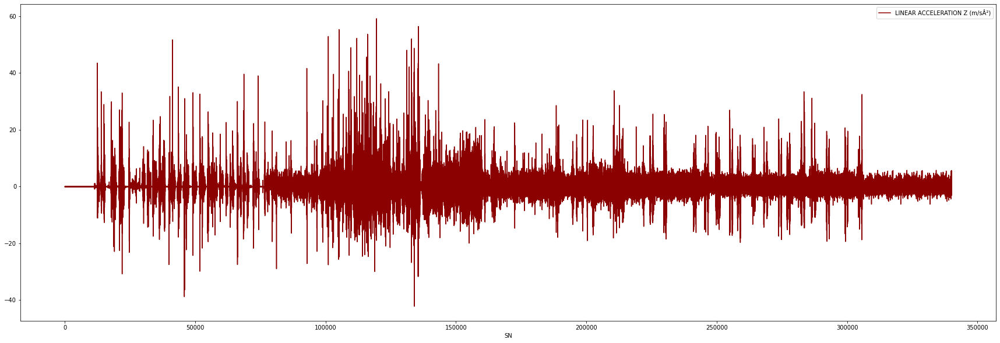

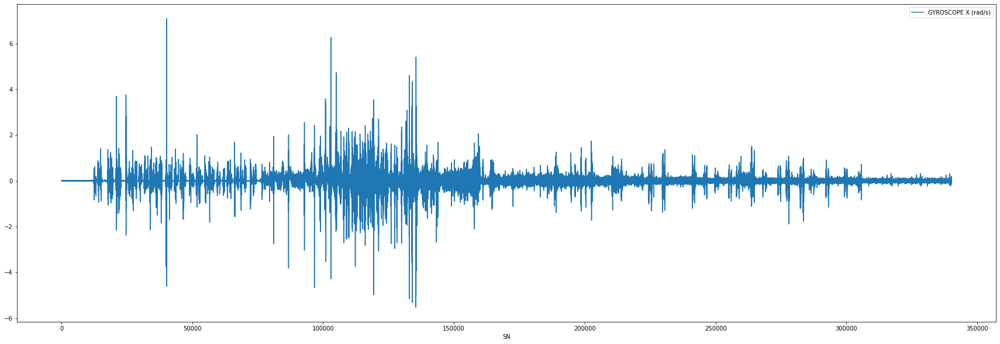

In [ ]:
# Plot key raw signal data

import matplotlib.pyplot as plt
df.plot(x='SN', y='LINEAR ACCELERATION Z (m/sÂ²)', figsize=(30, 10), color='darkred')
df.plot(x='SN', y='GYROSCOPE X (rad/s)', figsize=(30, 10))

plt.show()

# Data Preparation

## Apply Bandpass Filter

Cleaning the signal for key signals only

### Overview of Parameters

In another notebook, we applied Fast Fourier Transformation (FFT) what are the major signals for each event. These are the result summary. We would be primarily looking at the Linear Acceleration on the Z axis and Pitch Rotation on the Z axis as these variables best correlate with the actual motion observed when road bumps are encountered. The linear acceleration and gyroscope rotation values on the other axis will be pegged to these settings.

In [ ]:
# Peak Freq Regions

# Coasting
# Linear Acceleration (Z axis): 1.25Hz to 1.75Hz | power: 1500 to 3000
# Pitch Rotation (X Axis): <3Hz (abnormal spike around < 0.005Hz)  | power: 65 to 120

# Hump
# Linear Acceleration (Z axis): 0.75Hz to 1.75Hz | power: 200 to 490
# Pitch Rotation (X Axis): <0.5Hz, 1.75Hz, 2.9Hz | power: 15 to 38

# Speed Stripes
# Linear Acceleration (Z axis): 0.8Hz to 1.6Hz | power: 400 to 1100
# Pitch Rotation (X Axis): <0.75Hz, 1.9Hz | power: 30 to 53

# Potholes
# Linear Acceleration (Z axis): <5Hz | power: 1500 to 2500
# Pitch Rotation (X Axis): 1.4Hz to 4Hz | power: 80 to 165


# This means that in our filter settings, these are the estimated signal bands to filter in
# Do note that the figures listed here are merely starting points to consider.
# It is quite likely that the faster the speed of the object, the higher the frequency observed

# Linear Acceleration (Z axis): 1.8Hz to 5Hz
# Pitch Rotation (X Axis): 3Hz to 4Hz

### Define Filter Parameters

In [ ]:
# Sample rate(in Hz).
fs = 20

# Desired cutoff frequencies
# These settings are primarily tagged to the Z-Axis Linear Acceleration
lowcut_acc1 = 2.5
highcut_acc1 = 5 
#lowcut_acc2 = 3 
#highcut_acc2 = 5 

# These settings are primarily tagged to the X-Axis Gyroscope Rotation
lowcut_gyro1 = 3
highcut_gyro1 = 5
#lowcut_gyro2 = 3.5
#highcut_gyro2 = 5


### Linear Acceleration

In [ ]:
# Generate filtered results
# Different levels of filtering applied
df['LINEAR ACCELERATION X_f1 (m/sÂ²)'] = irrFilter.butter_bandpass_zerophase(df['LINEAR ACCELERATION X (m/sÂ²)'], lowcut_acc1, highcut_acc1, fs, order=3)
#df['LINEAR ACCELERATION X_f2 (m/sÂ²)'] = irrFilter.butter_bandpass_zerophase(df['LINEAR ACCELERATION X (m/sÂ²)'], lowcut_acc2, highcut_acc2, fs, order=3)
df['LINEAR ACCELERATION Y_f1 (m/sÂ²)'] = irrFilter.butter_bandpass_zerophase(df['LINEAR ACCELERATION Y (m/sÂ²)'], lowcut_acc1, highcut_acc1, fs, order=3)
#df['LINEAR ACCELERATION Y_f2 (m/sÂ²)'] = irrFilter.butter_bandpass_zerophase(df['LINEAR ACCELERATION Y (m/sÂ²)'], lowcut_acc2, highcut_acc2, fs, order=3)
df['LINEAR ACCELERATION Z_f1 (m/sÂ²)'] = irrFilter.butter_bandpass_zerophase(df['LINEAR ACCELERATION Z (m/sÂ²)'], lowcut_acc1, highcut_acc1, fs, order=3)
#df['LINEAR ACCELERATION Z_f2 (m/sÂ²)'] = irrFilter.butter_bandpass_zerophase(df['LINEAR ACCELERATION Z (m/sÂ²)'], lowcut_acc2, highcut_acc2, fs, order=3)

# Inspect filtered results
df.head()

,SN,LINEAR ACCELERATION X (m/sÂ²),LINEAR ACCELERATION Y (m/sÂ²),LINEAR ACCELERATION Z (m/sÂ²),GYROSCOPE X (rad/s),GYROSCOPE Y (rad/s),GYROSCOPE Z (rad/s),LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,LINEAR ACCELERATION X_f1 (m/sÂ²),LINEAR ACCELERATION Y_f1 (m/sÂ²),LINEAR ACCELERATION Z_f1 (m/sÂ²)
0,0,-0.020885,-0.054002,-0.067950,0.000324,-0.002306,0.001333,NaN,NaN,NaN,NaN,NaN,115005,2020-03-16 12:35:01:128,NaN,NaN,5.0,0.0,0.0,0,0.000089,-0.000066,0.000072
1,1,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115055,2020-03-16 12:35:01:178,NaN,NaN,5.0,0.0,1.0,0,-0.012132,-0.028744,0.027938
2,2,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115104,2020-03-16 12:35:01:227,NaN,NaN,5.0,0.0,2.0,0,-0.013403,-0.027335,0.027394
3,3,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115154,2020-03-16 12:35:01:277,NaN,NaN,5.0,0.0,3.0,0,-0.001078,-0.000169,0.001807
4,4,-0.018470,-0.057635,-0.056414,0.003379,0.000748,0.000111,NaN,NaN,NaN,NaN,NaN,115204,2020-03-16 12:35:01:327,NaN,NaN,5.0,0.0,4.0,0,0.012977,0.021893,-0.020197


<Figure size 432x288 with 0 Axes>

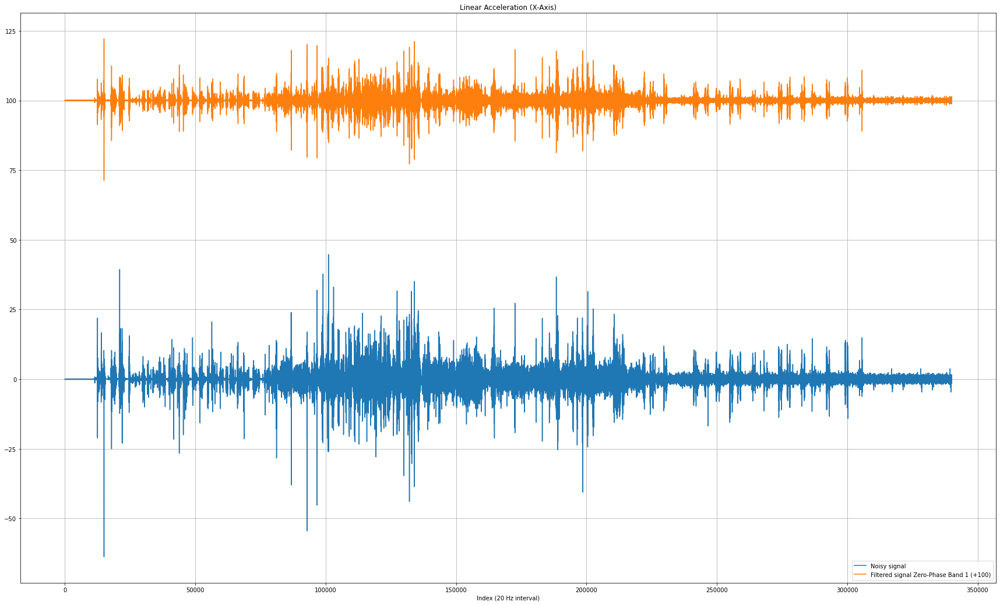

In [ ]:
# Plot results
t = df['SN']

plt.figure()
plt.clf()
plt.figure(figsize=(30, 18))
plt.title("Linear Acceleration (X-Axis)")
plt.plot(t, df['LINEAR ACCELERATION X (m/sÂ²)'], label='Noisy signal')
plt.plot(t, df['LINEAR ACCELERATION X_f1 (m/sÂ²)']+100, label='Filtered signal Zero-Phase Band 1 (+100)')
#plt.plot(t, df['LINEAR ACCELERATION X_f2 (m/sÂ²)']+150, label='Filtered signal Zero-Phase Band 2 (+150)')

plt.xlabel('Index (20 Hz interval)')
#plt.hlines([-a, a], 0, T, linestyles='--')
plt.grid(True)
plt.axis('tight')
plt.legend(loc='lower right')

plt.show()

<Figure size 432x288 with 0 Axes>

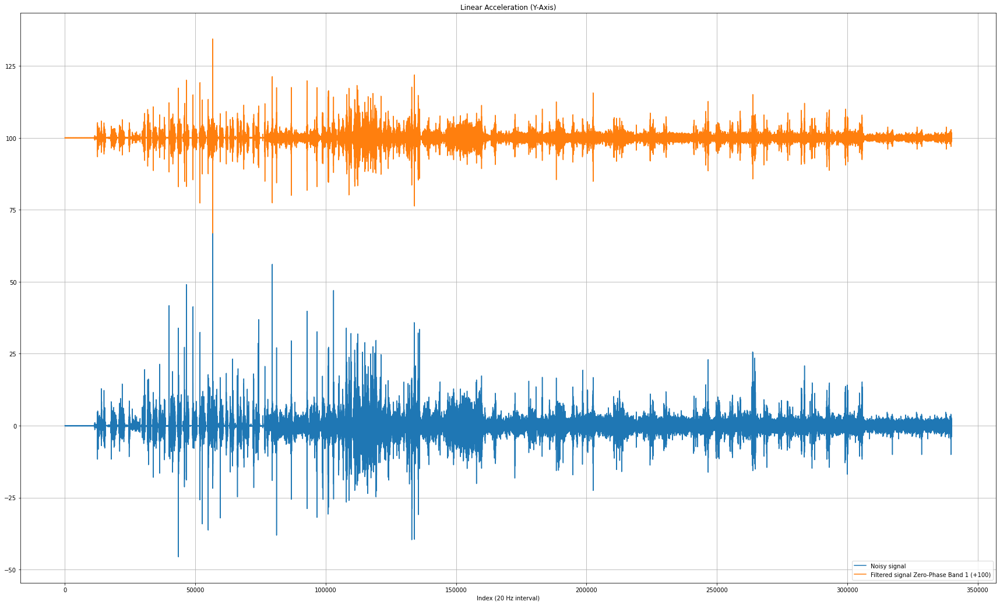

In [ ]:
# Plot results
t = df['SN']

plt.figure()
plt.clf()
plt.figure(figsize=(30, 18))
plt.title("Linear Acceleration (Y-Axis)")
plt.plot(t, df['LINEAR ACCELERATION Y (m/sÂ²)'], label='Noisy signal')
plt.plot(t, df['LINEAR ACCELERATION Y_f1 (m/sÂ²)']+100, label='Filtered signal Zero-Phase Band 1 (+100)')
#plt.plot(t, df['LINEAR ACCELERATION Y_f2 (m/sÂ²)']+150, label='Filtered signal Zero-Phase Band 2 (+150)')

plt.xlabel('Index (20 Hz interval)')
#plt.hlines([-a, a], 0, T, linestyles='--')
plt.grid(True)
plt.axis('tight')
plt.legend(loc='lower right')

plt.show()

<Figure size 432x288 with 0 Axes>

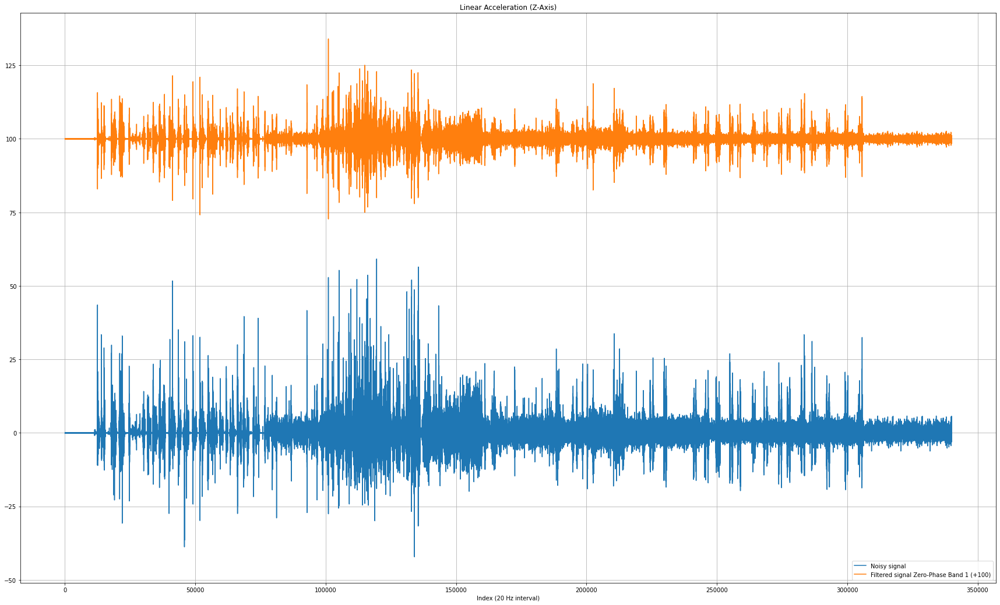

In [ ]:
# Plot results
t = df['SN']

plt.figure()
plt.clf()
plt.figure(figsize=(30, 18))
plt.title("Linear Acceleration (Z-Axis)")
plt.plot(t, df['LINEAR ACCELERATION Z (m/sÂ²)'], label='Noisy signal')
plt.plot(t, df['LINEAR ACCELERATION Z_f1 (m/sÂ²)']+100, label='Filtered signal Zero-Phase Band 1 (+100)')
#plt.plot(t, df['LINEAR ACCELERATION Z_f2 (m/sÂ²)']+150, label='Filtered signal Zero-Phase Band 2 (+150)')

plt.xlabel('Index (20 Hz interval)')
#plt.hlines([-a, a], 0, T, linestyles='--')
plt.grid(True)
plt.axis('tight')
plt.legend(loc='lower right')

plt.show()

### Gyroscope

In [ ]:
# Generate filtered results
# Different levels of filtering applied
df['GYROSCOPE X_f1 (rad/s)'] = irrFilter.butter_bandpass_zerophase(df['GYROSCOPE X (rad/s)'], lowcut_gyro1, highcut_gyro1, fs, order=3)
#df['GYROSCOPE X_f2 (rad/s)'] = irrFilter.butter_bandpass_zerophase(df['GYROSCOPE X (rad/s)'], lowcut_gyro2, highcut_gyro2, fs, order=3)
df['GYROSCOPE Y_f1 (rad/s)'] = irrFilter.butter_bandpass_zerophase(df['GYROSCOPE Y (rad/s)'], lowcut_gyro1, highcut_gyro1, fs, order=3)
#df['GYROSCOPE Y_f2 (rad/s)'] = irrFilter.butter_bandpass_zerophase(df['GYROSCOPE Y (rad/s)'], lowcut_gyro2, highcut_gyro2, fs, order=3)
df['GYROSCOPE Z_f1 (rad/s)'] = irrFilter.butter_bandpass_zerophase(df['GYROSCOPE Z (rad/s)'], lowcut_gyro1, highcut_gyro1, fs, order=3)
#df['GYROSCOPE Z_f2 (rad/s)'] = irrFilter.butter_bandpass_zerophase(df['GYROSCOPE Z (rad/s)'], lowcut_gyro2, highcut_gyro2, fs, order=3)

# Inspect filtered results
df.head()

,SN,LINEAR ACCELERATION X (m/sÂ²),LINEAR ACCELERATION Y (m/sÂ²),LINEAR ACCELERATION Z (m/sÂ²),GYROSCOPE X (rad/s),GYROSCOPE Y (rad/s),GYROSCOPE Z (rad/s),LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,LINEAR ACCELERATION X_f1 (m/sÂ²),LINEAR ACCELERATION Y_f1 (m/sÂ²),LINEAR ACCELERATION Z_f1 (m/sÂ²),GYROSCOPE X_f1 (rad/s),GYROSCOPE Y_f1 (rad/s),GYROSCOPE Z_f1 (rad/s)
0,0,-0.020885,-0.054002,-0.067950,0.000324,-0.002306,0.001333,NaN,NaN,NaN,NaN,NaN,115005,2020-03-16 12:35:01:128,NaN,NaN,5.0,0.0,0.0,0,0.000089,-0.000066,0.000072,0.000006,-0.000007,0.000006
1,1,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115055,2020-03-16 12:35:01:178,NaN,NaN,5.0,0.0,1.0,0,-0.012132,-0.028744,0.027938,-0.001205,-0.000453,0.000156
2,2,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115104,2020-03-16 12:35:01:227,NaN,NaN,5.0,0.0,2.0,0,-0.013403,-0.027335,0.027394,-0.000924,-0.000459,0.000005
3,3,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115154,2020-03-16 12:35:01:277,NaN,NaN,5.0,0.0,3.0,0,-0.001078,-0.000169,0.001807,0.000361,0.000002,-0.000102
4,4,-0.018470,-0.057635,-0.056414,0.003379,0.000748,0.000111,NaN,NaN,NaN,NaN,NaN,115204,2020-03-16 12:35:01:327,NaN,NaN,5.0,0.0,4.0,0,0.012977,0.021893,-0.020197,0.000922,0.000431,0.000148


<Figure size 432x288 with 0 Axes>

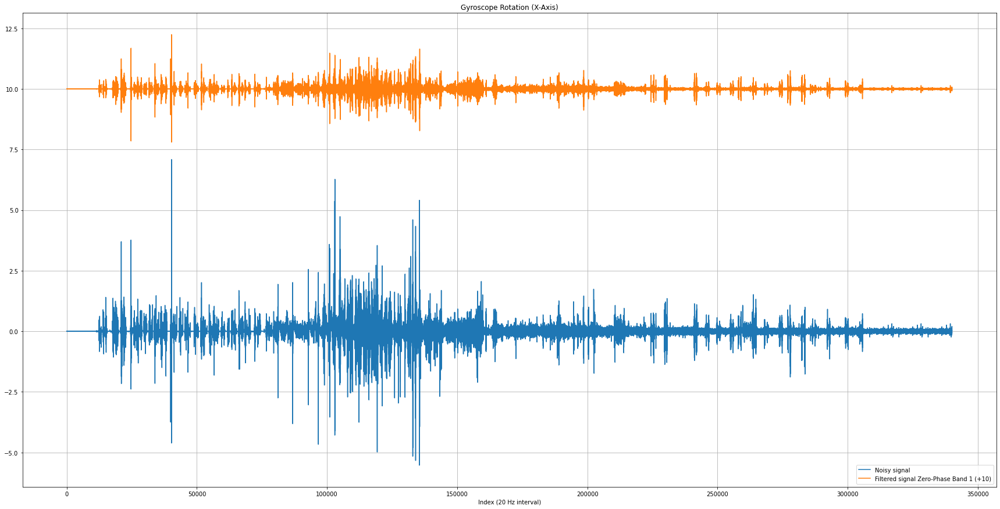

In [ ]:
# Plot results
t = df['SN']

plt.figure()
plt.clf()
plt.figure(figsize=(30, 15))
plt.title("Gyroscope Rotation (X-Axis)")
plt.plot(t, df['GYROSCOPE X (rad/s)'], label='Noisy signal')
plt.plot(t, df['GYROSCOPE X_f1 (rad/s)']+10, label='Filtered signal Zero-Phase Band 1 (+10)')
#plt.plot(t, df['GYROSCOPE X_f2 (rad/s)']+15, label='Filtered signal Zero-Phase Band 2 (+15)')

plt.xlabel('Index (20 Hz interval)')
#plt.hlines([-a, a], 0, T, linestyles='--')
plt.grid(True)
plt.axis('tight')
plt.legend(loc='lower right')

plt.show()

<Figure size 432x288 with 0 Axes>

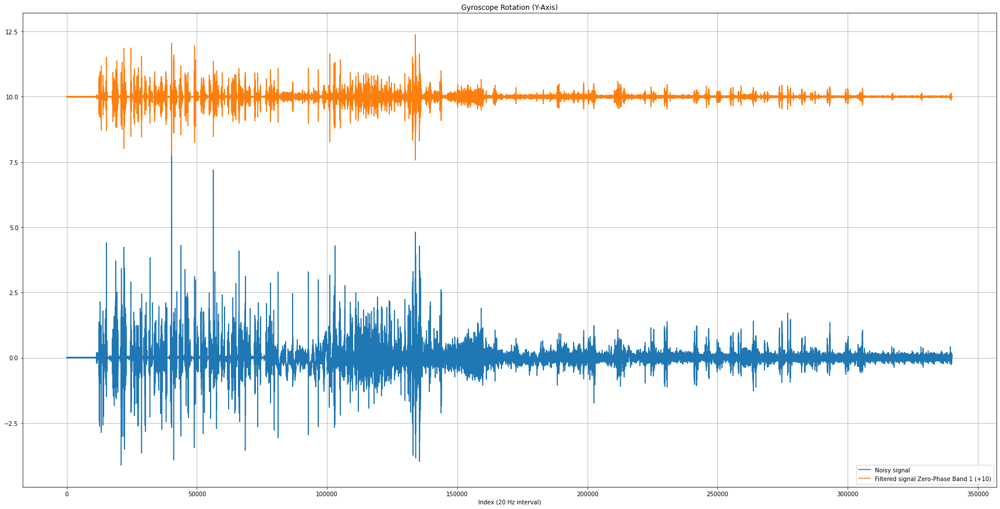

In [ ]:
# Plot results
t = df['SN']

plt.figure()
plt.clf()
plt.figure(figsize=(30, 15))
plt.title("Gyroscope Rotation (Y-Axis)")
plt.plot(t, df['GYROSCOPE Y (rad/s)'], label='Noisy signal')
plt.plot(t, df['GYROSCOPE Y_f1 (rad/s)']+10, label='Filtered signal Zero-Phase Band 1 (+10)')
#plt.plot(t, df['GYROSCOPE Y_f2 (rad/s)']+15, label='Filtered signal Zero-Phase Band 2 (+15)')

plt.xlabel('Index (20 Hz interval)')
#plt.hlines([-a, a], 0, T, linestyles='--')
plt.grid(True)
plt.axis('tight')
plt.legend(loc='lower right')

plt.show()

<Figure size 432x288 with 0 Axes>

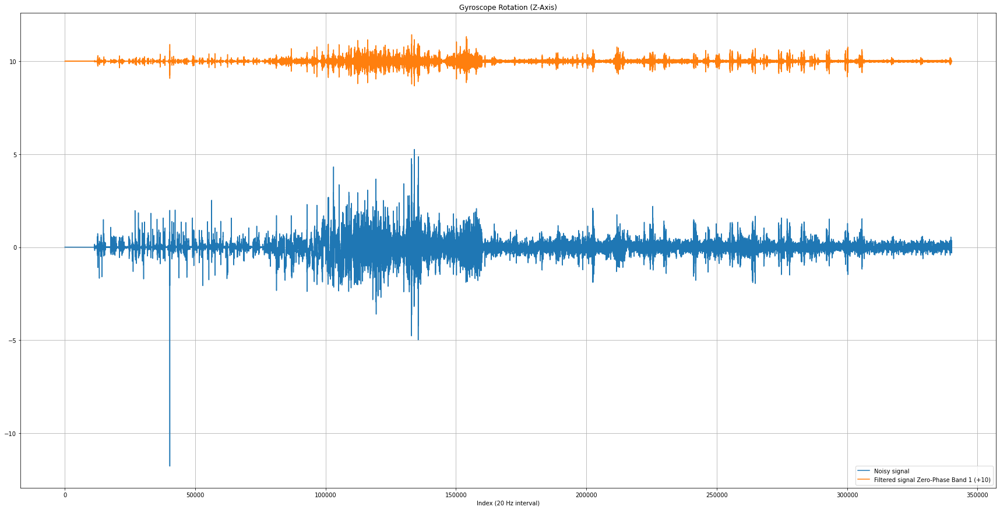

In [ ]:
# Plot results
t = df['SN']

plt.figure()
plt.clf()
plt.figure(figsize=(30, 15))
plt.title("Gyroscope Rotation (Z-Axis)")
plt.plot(t, df['GYROSCOPE Z (rad/s)'], label='Noisy signal')
plt.plot(t, df['GYROSCOPE Z_f1 (rad/s)']+10, label='Filtered signal Zero-Phase Band 1 (+10)')
#plt.plot(t, df['GYROSCOPE Z_f2 (rad/s)']+15, label='Filtered signal Zero-Phase Band 2 (+15)')

plt.xlabel('Index (20 Hz interval)')
#plt.hlines([-a, a], 0, T, linestyles='--')
plt.grid(True)
plt.axis('tight')
plt.legend(loc='lower right')

plt.show()

## Continuous Wavelet Transform (CWT)
Feature extraction at the frequency, time and wavelet domains

### Overview of Parameters

To choose the wavelet family as the mother wavelet, you will need to pick a mother wavelet that has similar energy, entropy and shape to the target wavelet signal. For most part, this involves a lot of trial and error to find a wavelet family which matches the target signal's profile.

In our case, previous studies found that the db3 wavelets work well in mimicking the signal of bumps and potholes, so we'll attempt to find a continuous wavelet that is most similar as a first cut.

### Define CWT Parameters

In [ ]:
# Define candidate mother wavelets that best mimick target signal
# These mother wavelet best mimicks the DB3 wavelet which is similar to our target signal.
wavelet1 = "cgau4"
wavelet2 = "cgau8"

# cgau4 seems to give a stronger amplitude signals than gau1 and cgau1
# cgau4 seems to give a stronger amplitude signals than gaus4
# cgau8 seems to give a stronger amplitude signal than cgau8

### Determine Wavelet Scale to Sample

In [ ]:
# Determine sampling scale
# f = scale2frequency(wavelet, scale)/sampling_period

# Sampling period (dt) = sampling frequency (fs) in seconds
# since our sampling frequency is in Hz, we'll need to convert it to seconds
dt = 1 / fs

# Define scale to test
# The scale roughly translates to how much the wavelet is stretched to fit the time window
# A scale of 1 means that the wavelet window is the same as sampling frequency (fs); this is an impossible to determine due to the Nyquist Frequency requirement
# A scale of n means that the wavelet window is n * sampling frequency (fs)

WaveletDuration = 2 # estimate duration of the wavelet in seconds
upperRange = 2 * fs

scale = np.arange(1, upperRange)
scale


array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39])

In [ ]:
# Guesstimate Wavelet Scale based on Wavelet Frequency Output
# Wavelet frequency must be between 1 < fw < (0.5 * fs)
# Based on our sampling frequency of 100Hz, we can only use scales whose wavelet frequencies are under 50
# Therefore any we should try scales that are 2 or more.

# Wavelet Frequency 1
fw1 = pywt.scale2frequency(wavelet1, scale) / dt

# Inspect results
np.round(fw1, decimals = 3)

array([10.   ,  5.   ,  3.333,  2.5  ,  2.   ,  1.667,  1.429,  1.25 ,
        1.111,  1.   ,  0.909,  0.833,  0.769,  0.714,  0.667,  0.625,
        0.588,  0.556,  0.526,  0.5  ,  0.476,  0.455,  0.435,  0.417,
        0.4  ,  0.385,  0.37 ,  0.357,  0.345,  0.333,  0.323,  0.312,
        0.303,  0.294,  0.286,  0.278,  0.27 ,  0.263,  0.256])

In [ ]:
# Wavelet Frequency 2
fw2 = pywt.scale2frequency(wavelet2, scale) / dt

# Inspect results
np.round(fw2, decimals = 3)

array([14.   ,  7.   ,  4.667,  3.5  ,  2.8  ,  2.333,  2.   ,  1.75 ,
        1.556,  1.4  ,  1.273,  1.167,  1.077,  1.   ,  0.933,  0.875,
        0.824,  0.778,  0.737,  0.7  ,  0.667,  0.636,  0.609,  0.583,
        0.56 ,  0.538,  0.519,  0.5  ,  0.483,  0.467,  0.452,  0.437,
        0.424,  0.412,  0.4  ,  0.389,  0.378,  0.368,  0.359])

### Apply CWT

The following general principles are important to keep in mind when interpreting CWT coefficients.

Cone of influence — Depending on the scale, the CWT coefficient at a point can be affected by signal values at points far removed. You have to take into account the support of the wavelet at specific scales. Use conofinf to determine the cone of influence. Not all wavelets are equal in their support. For example, the Haar wavelet has smaller support at all scales than the sym4 wavelet.

Detecting abrupt transitions — Wavelets are very useful for detecting abrupt changes in a signal. Abrupt changes in a signal produce relatively large wavelet coefficients (in absolute value) centered around the discontinuity at all scales. Because of the support of the wavelet, the set of CWT coefficients affected by the singularity increases with increasing scale. Recall this is the definition of the cone of influence. The most precise localization of the discontinuity based on the CWT coefficients is obtained at the smallest scales.

Detecting smooth signal features — Smooth signal features produce relatively large wavelet coefficients at scales where the oscillation in the wavelet correlates best with the signal feature. For sinusoidal oscillations, the CWT coefficients display an oscillatory pattern at scales where the oscillation in the wavelet approximates the period of the sine wave. 

### CWT Exploration

#### Linear Acceleration F1 (Wavelet 1) - Exploration

In [ ]:
#pywt.cwt(data, scales, wavelet)
# each row corresponds the the number of scales sampled
# each col of the coefficients output corresponds to the number observations in our data
cwt_coef, cwt_freqs = pywt.cwt(df['LINEAR ACCELERATION Z_f1 (m/sÂ²)'], scale, wavelet1, sampling_period = dt)

In [ ]:
# Check dimension of arrays created
print(cwt_coef.shape)
print(cwt_freqs.shape)

(39, 340105)
(39,)


In [ ]:
# Inspect frequency data sample
cwt_freqs[0:100]

array([10.        ,  5.        ,  3.33333333,  2.5       ,  2.        ,
        1.66666667,  1.42857143,  1.25      ,  1.11111111,  1.        ,
        0.90909091,  0.83333333,  0.76923077,  0.71428571,  0.66666667,
        0.625     ,  0.58823529,  0.55555556,  0.52631579,  0.5       ,
        0.47619048,  0.45454545,  0.43478261,  0.41666667,  0.4       ,
        0.38461538,  0.37037037,  0.35714286,  0.34482759,  0.33333333,
        0.32258065,  0.3125    ,  0.3030303 ,  0.29411765,  0.28571429,
        0.27777778,  0.27027027,  0.26315789,  0.25641026])

In [ ]:
# Inspect coefficient data sample
cwt_coef[::,0:3]

array([[-0.00042521-3.70520025e-03j, -0.00035792+5.71513676e-03j,
         0.00049996-9.74066707e-04j],
       [-0.01180867-7.13789375e-04j, -0.00138601+1.40866785e-02j,
         0.01792501+4.57786139e-03j],
       [-0.01136571+1.36139597e-02j,  0.01059974+2.10365424e-02j,
         0.02910841+2.53563230e-03j],
       [ 0.00134376+2.05720084e-02j,  0.02113879+1.53444560e-02j,
         0.02904829-5.74462378e-03j],
       [ 0.01167181+1.68165690e-02j,  0.02269384+6.16591196e-03j,
         0.02219762-1.04826658e-02j],
       [ 0.01443204+1.00764553e-02j,  0.01906111+2.62480212e-04j,
         0.01596992-1.09039864e-02j],
       [ 0.01341927+5.38844443e-03j,  0.01504547-1.86915930e-03j,
         0.01217905-9.04948168e-03j],
       [ 0.01174654+2.97791317e-03j,  0.01238478-2.11468018e-03j,
         0.01013349-6.88875642e-03j],
       [ 0.01058233+2.07482583e-03j,  0.01054228-1.76469158e-03j,
         0.00837229-5.31993188e-03j],
       [ 0.00956004+1.94389105e-03j,  0.00912449-1.52797129e-03j

In [ ]:
print(scale.min())
print(scale.max())
print(cwt_coef.shape[1])

1
39
340105


In [ ]:
# Plot Graph (2D) - original
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

#plt.figure(figsize=(30,10))
#plt.imshow(cwt_coef, cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), scale.max(), scale.min()-0.5])
#cbar = plt.colorbar()
#cbar.set_label(label='Amplitude', size=18)
#cbar.ax.tick_params(labelsize=13)
#plt.title("CWT (1st Order Gaussian Wavelet Applied) on Linear Acceleration (Z-Axis)", fontsize = 20)
#plt.xlabel("Index (20Hz Interval)", fontsize = 18)
#plt.ylabel("Adjusted Scale", fontsize = 18)
#plt.tick_params(axis='both', which='major', labelsize = 13)

#plt.show()

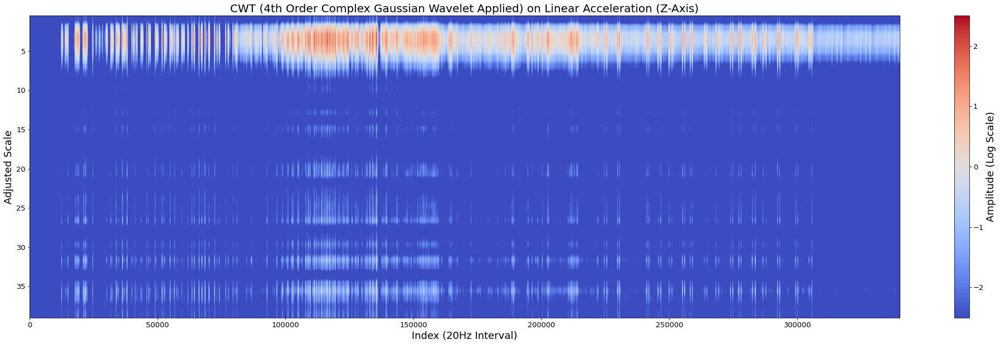

In [ ]:
# Plot Graph (2D) - Log Scale Applied to Amplitude
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

# Since the amplitude has quite a wide minimum and maximum range from the average, we would scale it using the log of the absolute value of the magnitude instead 


plt.figure(figsize=(35,10))
plt.imshow(np.log(abs(cwt_coef)), cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), scale.max(), scale.min()-0.5])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (4th Order Complex Gaussian Wavelet Applied) on Linear Acceleration (Z-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

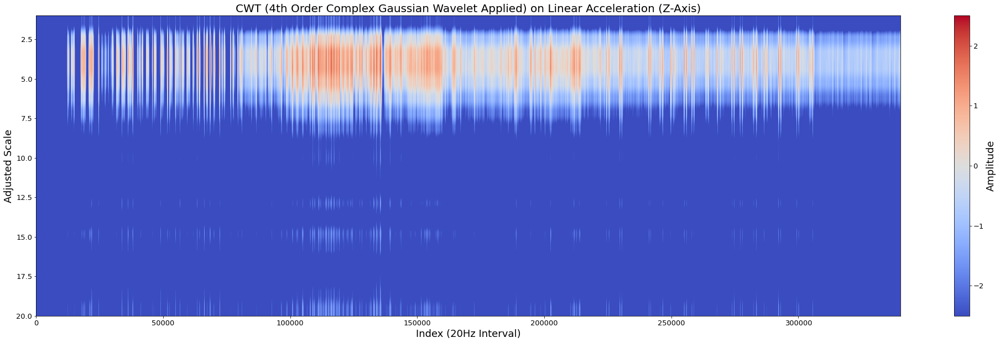

In [ ]:
# Plot Graph (2D) - Log Scale Applied to Amplitude (Zoomed In version)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

plt.figure(figsize=(35,10))
plt.imshow(np.log(abs(cwt_coef))[0:20,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), 20, scale.min()])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (4th Order Complex Gaussian Wavelet Applied) on Linear Acceleration (Z-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

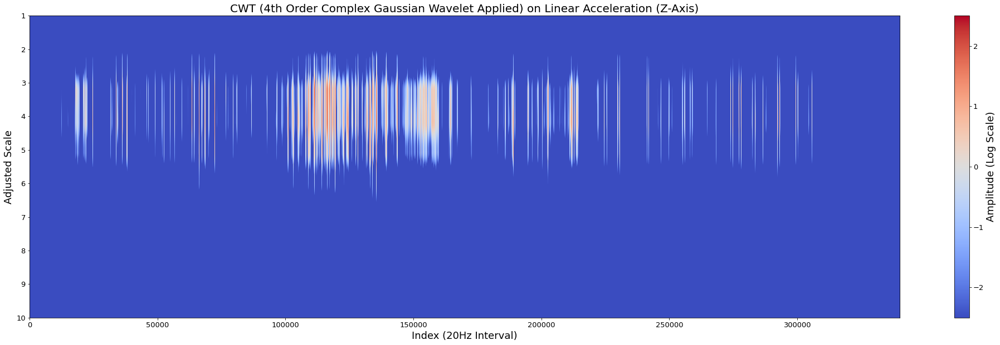

In [ ]:
# Threshold suppression of background noise (baseline)
test0 = np.log(abs(cwt_coef))
test0[test0 < 0] = -10

# Plot Graph (2D) - Log Scale Applied to Amplitude
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

# Since the amplitude has quite a wide minimum and maximum range from the average, we would scale it using the log of the absolute value of the magnitude instead 


plt.figure(figsize=(35,10))
plt.imshow(test0[0:10,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), 10, scale.min()])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (4th Order Complex Gaussian Wavelet Applied) on Linear Acceleration (Z-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

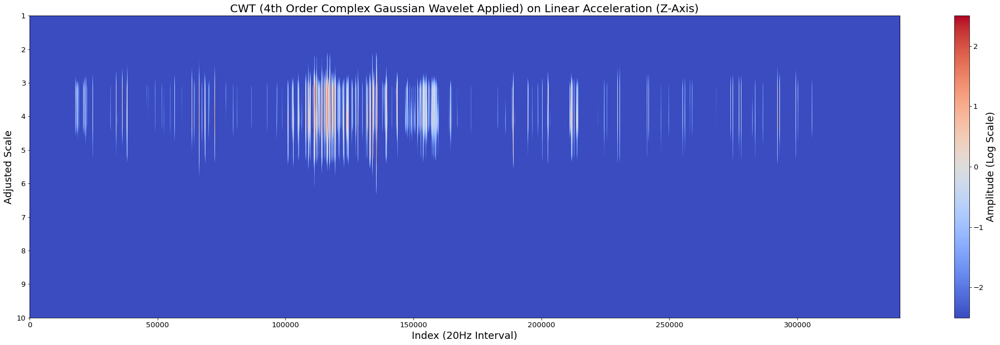

In [ ]:
# Threshold suppression of background noise
test1 = np.log(abs(cwt_coef))
test1[test1 < 0.4] = -10

# Plot Graph (2D) - Log Scale Applied to Amplitude
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

# Since the amplitude has quite a wide minimum and maximum range from the average, we would scale it using the log of the absolute value of the magnitude instead 


plt.figure(figsize=(35,10))
plt.imshow(test1[0:10,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), 10, scale.min()])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (4th Order Complex Gaussian Wavelet Applied) on Linear Acceleration (Z-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

#### Linear Acceleration F1 (Wavelet 2) - Exploration

Potential candidate *

In [ ]:
#pywt.cwt(data, scales, wavelet)
# each row corresponds the the number of scales sampled
# each col of the coefficients output corresponds to the number observations in our data
cwt_coef, cwt_freqs = pywt.cwt(df['LINEAR ACCELERATION Z_f1 (m/sÂ²)'], scale, wavelet2, sampling_period = dt)

In [ ]:
# Check dimension of arrays created
print(cwt_coef.shape)
print(cwt_freqs.shape)

(39, 340105)
(39,)


In [ ]:
# Inspect frequency data sample
cwt_freqs[0:100]

array([14.        ,  7.        ,  4.66666667,  3.5       ,  2.8       ,
        2.33333333,  2.        ,  1.75      ,  1.55555556,  1.4       ,
        1.27272727,  1.16666667,  1.07692308,  1.        ,  0.93333333,
        0.875     ,  0.82352941,  0.77777778,  0.73684211,  0.7       ,
        0.66666667,  0.63636364,  0.60869565,  0.58333333,  0.56      ,
        0.53846154,  0.51851852,  0.5       ,  0.48275862,  0.46666667,
        0.4516129 ,  0.4375    ,  0.42424242,  0.41176471,  0.4       ,
        0.38888889,  0.37837838,  0.36842105,  0.35897436])

In [ ]:
# Inspect coefficient data sample
cwt_coef[::,0:3]

array([[ 0.00263415-9.78636638e-04j,  0.00033815+5.05595932e-03j,
        -0.00471411+7.75366549e-05j],
       [-0.00438055-4.84963061e-03j, -0.00306511+6.41744950e-03j,
         0.00639444+4.27455774e-04j],
       [-0.01405973-1.12842557e-04j, -0.00297253+1.59680987e-02j,
         0.01735955+6.97430080e-03j],
       [-0.01423446+1.41375742e-02j,  0.00808309+2.21826373e-02j,
         0.02683314+3.60930593e-03j],
       [-0.00218831+2.22600184e-02j,  0.01879435+1.75439134e-02j,
         0.02753175-3.97880150e-03j],
       [ 0.00871364+1.96847005e-02j,  0.02226761+8.74551578e-03j,
         0.02338584-9.93402488e-03j],
       [ 0.01355163+1.30093280e-02j,  0.02013509+1.71082954e-03j,
         0.01738231-1.19510345e-02j],
       [ 0.01369053+7.32193099e-03j,  0.01624497-1.52885815e-03j,
         0.01255411-1.04385433e-02j],
       [ 0.01229908+4.31801013e-03j,  0.0128116 -2.30344486e-03j,
         0.00925035-8.31154733e-03j],
       [ 0.0105921 +3.21762685e-03j,  0.01047906-2.22975881e-03j

In [ ]:
print(scale.min())
print(scale.max())
print(cwt_coef.shape[1])

1
39
340105


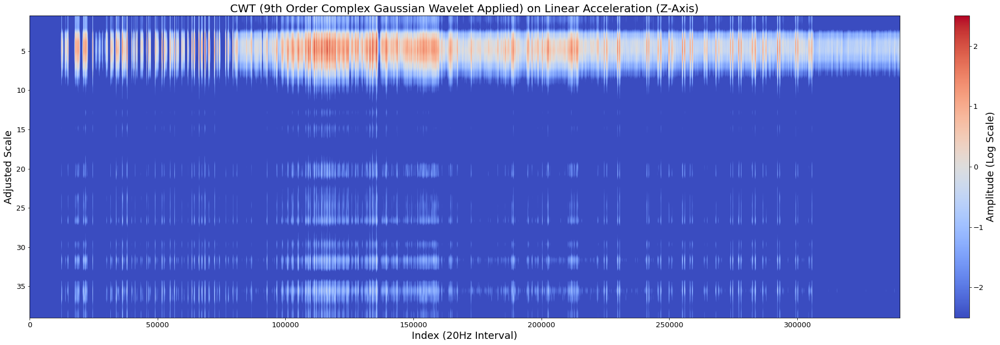

In [ ]:
# Plot Graph (2D) - Log Scale Applied to Amplitude
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

# Since the amplitude has quite a wide minimum and maximum range from the average, we would scale it using the log of the absolute value of the magnitude instead 


plt.figure(figsize=(35,10))
plt.imshow(np.log(abs(cwt_coef)), cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), scale.max(), scale.min()-0.5])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (9th Order Complex Gaussian Wavelet Applied) on Linear Acceleration (Z-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

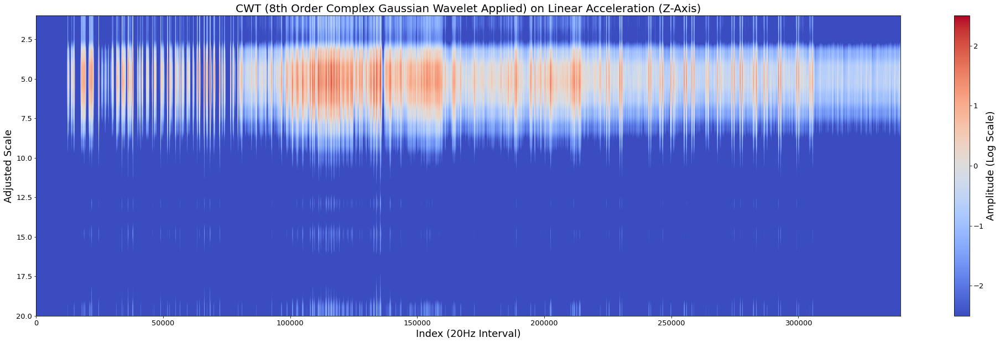

In [ ]:
# Plot Graph (2D) - Log Scale Applied to Amplitude (Zoomed In version)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

plt.figure(figsize=(35,10))
plt.imshow(np.log(abs(cwt_coef))[0:20,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), 20, scale.min()])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (8th Order Complex Gaussian Wavelet Applied) on Linear Acceleration (Z-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

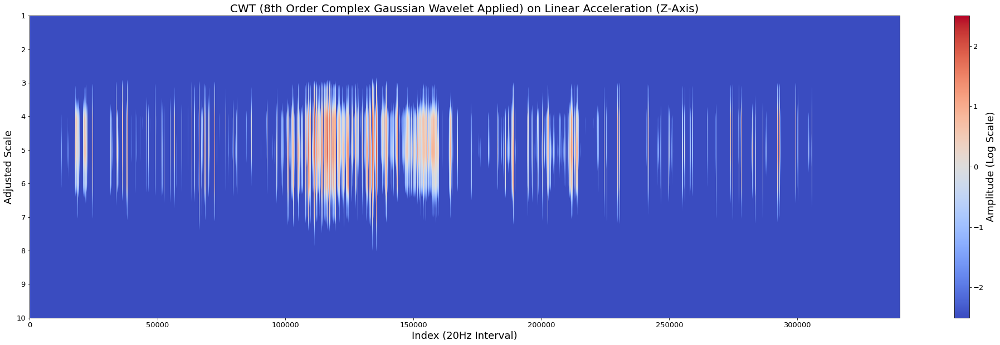

In [ ]:
# Threshold suppression of background noise (baseline)
test0 = np.log(abs(cwt_coef))
test0[test0 < 0] = -10

# Plot Graph (2D) - Log Scale Applied to Amplitude (Zoomed In version)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

plt.figure(figsize=(35,10))
plt.imshow(test0[0:10,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), 10, scale.min()])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (8th Order Complex Gaussian Wavelet Applied) on Linear Acceleration (Z-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

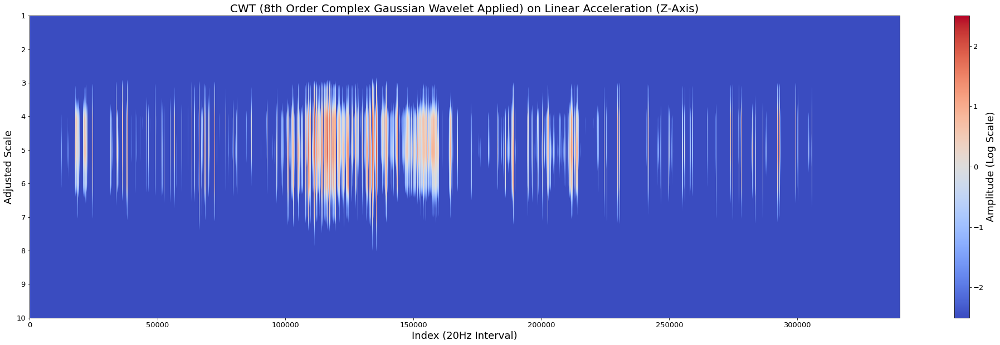

In [ ]:
# Threshold suppression of background noise
test1 = np.log(abs(cwt_coef))
test1[test1 < 0.5] = -10

# Plot Graph (2D) - Log Scale Applied to Amplitude (Zoomed In version)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

plt.figure(figsize=(35,10))
plt.imshow(test0[0:10,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), 10, scale.min()])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (8th Order Complex Gaussian Wavelet Applied) on Linear Acceleration (Z-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

#### Gyroscope Rotation F1 (Wavelet 1) - Exploration

In [ ]:
#pywt.cwt(data, scales, wavelet)
# each row corresponds the the number of scales sampled
# each col of the coefficients output corresponds to the number observations in our data
cwt_coef, cwt_freqs = pywt.cwt(df['GYROSCOPE X_f1 (rad/s)'], scale, wavelet1, sampling_period = dt)

In [ ]:
# Check dimension of arrays created
print(cwt_coef.shape)
print(cwt_freqs.shape)

(39, 340105)
(39,)


In [ ]:
# Inspect frequency data sample
cwt_freqs[0:100]

array([10.        ,  5.        ,  3.33333333,  2.5       ,  2.        ,
        1.66666667,  1.42857143,  1.25      ,  1.11111111,  1.        ,
        0.90909091,  0.83333333,  0.76923077,  0.71428571,  0.66666667,
        0.625     ,  0.58823529,  0.55555556,  0.52631579,  0.5       ,
        0.47619048,  0.45454545,  0.43478261,  0.41666667,  0.4       ,
        0.38461538,  0.37037037,  0.35714286,  0.34482759,  0.33333333,
        0.32258065,  0.3125    ,  0.3030303 ,  0.29411765,  0.28571429,
        0.27777778,  0.27027027,  0.26315789,  0.25641026])

In [ ]:
# Inspect coefficient data sample
cwt_coef[::,0:3]

array([[ 2.22020913e-05+1.69622366e-04j,  1.45110829e-05-2.79555136e-04j,
        -3.00741092e-05+6.76053471e-05j],
       [ 5.17036499e-04-3.50716420e-05j, -7.43648007e-05-6.64325656e-04j,
        -8.83483063e-04-3.07824754e-05j],
       [ 3.11322767e-04-6.39741431e-04j, -6.37156827e-04-7.20636081e-04j,
        -1.10420088e-03+2.36481902e-04j],
       [-2.08030292e-04-7.21918088e-04j, -8.50372305e-04-3.72667049e-04j,
        -9.16807779e-04+4.23203166e-04j],
       [-4.89383586e-04-5.03612186e-04j, -7.79366062e-04-7.53269567e-05j,
        -6.40152813e-04+4.69597498e-04j],
       [-5.10040208e-04-2.72431039e-04j, -6.09490848e-04+6.71971830e-05j,
        -4.51266479e-04+4.02708024e-04j],
       [-4.44192188e-04-1.45993556e-04j, -4.73326907e-04+8.56336086e-05j,
        -3.67988432e-04+3.07721823e-04j],
       [-3.85041003e-04-8.25403937e-05j, -4.00669764e-04+7.63002382e-05j,
        -3.29085389e-04+2.23519574e-04j],
       [-3.51608283e-04-6.84574533e-05j, -3.48354759e-04+6.09558224e-05j

In [ ]:
print(scale.min())
print(scale.max())
print(cwt_coef.shape[1])

1
39
340105


In [ ]:
# Plot Graph (2D) - original
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

#plt.figure(figsize=(30,10))
#plt.imshow(cwt_coef, cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), scale.max(), scale.min()-0.5])
#cbar = plt.colorbar()
#cbar.set_label(label='Amplitude', size=18)
#cbar.ax.tick_params(labelsize=13)
#plt.title("CWT (1st Order Gaussian Wavelet Applied) on Gyroscope Rotatation (X-Axis)", fontsize = 20)
#plt.xlabel("Index (20Hz Interval)", fontsize = 18)
#plt.ylabel("Adjusted Scale", fontsize = 18)
#plt.tick_params(axis='both', which='major', labelsize = 13)

#plt.show()

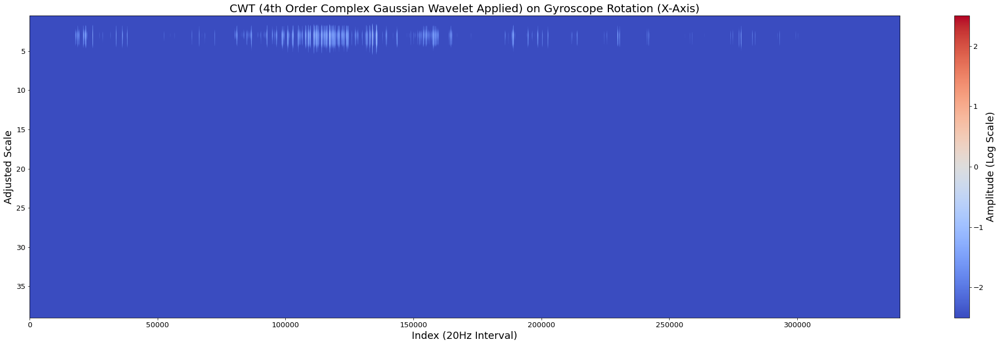

In [ ]:
# Plot Graph (2D) - Log Scale Applied to Amplitude
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

# Since the amplitude has quite a wide minimum and maximum range from the average, we would scale it using the log of the absolute value of the magnitude instead 


plt.figure(figsize=(35,10))
plt.imshow(np.log(abs(cwt_coef)), cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), scale.max(), scale.min()-0.5])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (4th Order Complex Gaussian Wavelet Applied) on Gyroscope Rotation (X-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

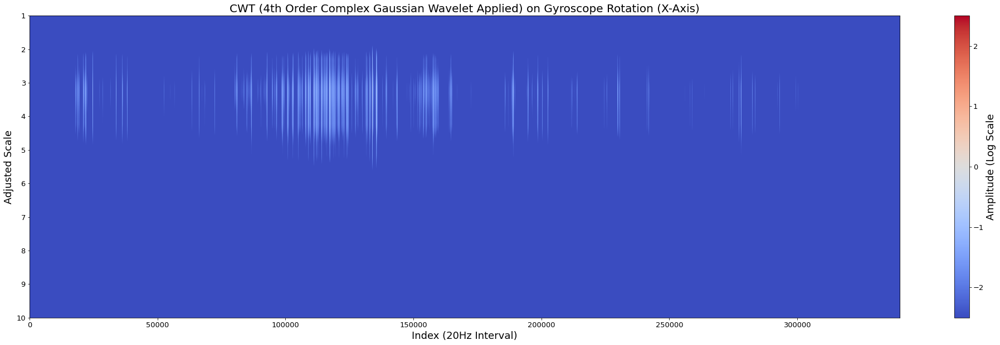

In [ ]:
# Plot Graph (2D) - Log Scale Applied to Amplitude (Zoomed In version)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

plt.figure(figsize=(35,10))
plt.imshow(np.log(abs(cwt_coef))[0:10,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), 10, scale.min()])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (4th Order Complex Gaussian Wavelet Applied) on Gyroscope Rotation (X-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

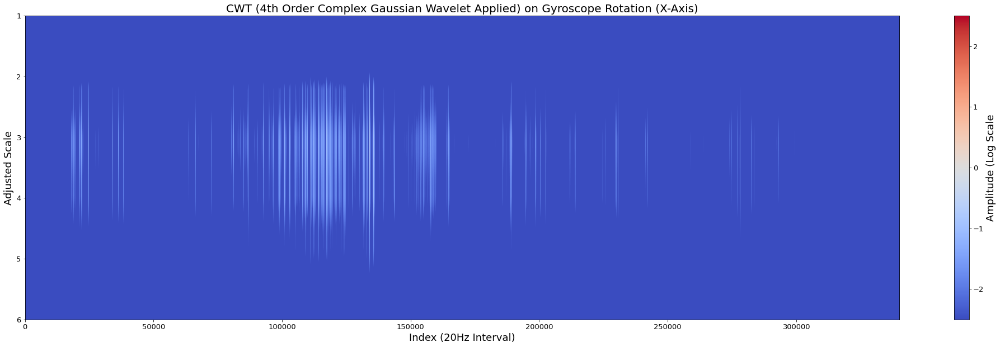

In [ ]:
# Threshold suppression of background noise (baseline)
test0 = np.log(abs(cwt_coef))
test0[test0 < -5] = -20

# Plot Graph (2D) - Log Scale Applied to Amplitude (Zoomed In version)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

plt.figure(figsize=(35,10))
plt.imshow(test0[0:6,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), 6, scale.min()])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (4th Order Complex Gaussian Wavelet Applied) on Gyroscope Rotation (X-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

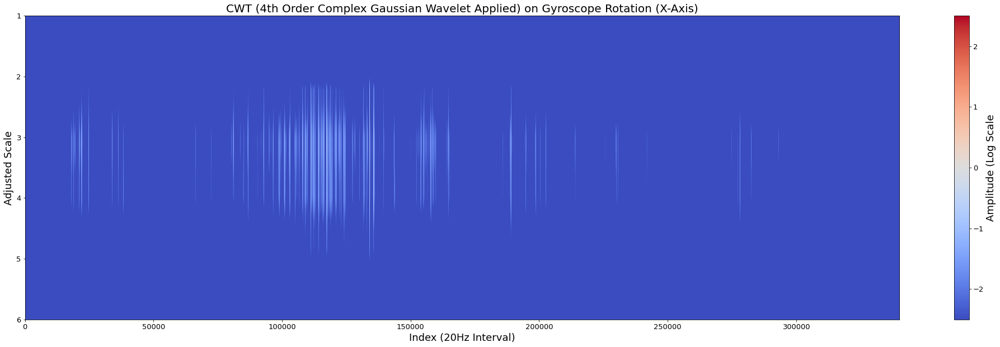

In [ ]:
# Threshold suppression of background noise
test1 = np.log(abs(cwt_coef))
test1[test1 < -4] = -20

# Plot Graph (2D) - Log Scale Applied to Amplitude (Zoomed In version)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

plt.figure(figsize=(35,10))
plt.imshow(test1[0:6,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), 6, scale.min()])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (4th Order Complex Gaussian Wavelet Applied) on Gyroscope Rotation (X-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

#### Gyroscope Rotation F1 (Wavelet 2) - Exploration
Potential Candidate *

In [ ]:
#pywt.cwt(data, scales, wavelet)
# each row corresponds the the number of scales sampled
# each col of the coefficients output corresponds to the number observations in our data
cwt_coef, cwt_freqs = pywt.cwt(df['GYROSCOPE X_f1 (rad/s)'], scale, wavelet2, sampling_period = dt)

In [ ]:
# Check dimension of arrays created
print(cwt_coef.shape)
print(cwt_freqs.shape)

(39, 340105)
(39,)


In [ ]:
# Inspect frequency data sample
cwt_freqs[0:100]

array([14.        ,  7.        ,  4.66666667,  3.5       ,  2.8       ,
        2.33333333,  2.        ,  1.75      ,  1.55555556,  1.4       ,
        1.27272727,  1.16666667,  1.07692308,  1.        ,  0.93333333,
        0.875     ,  0.82352941,  0.77777778,  0.73684211,  0.7       ,
        0.66666667,  0.63636364,  0.60869565,  0.58333333,  0.56      ,
        0.53846154,  0.51851852,  0.5       ,  0.48275862,  0.46666667,
        0.4516129 ,  0.4375    ,  0.42424242,  0.41176471,  0.4       ,
        0.38888889,  0.37837838,  0.36842105,  0.35897436])

In [ ]:
# Inspect coefficient data sample
cwt_coef[::,0:3]

array([[-1.18484123e-04+4.13591028e-05j,  5.78026925e-06-2.31367183e-04j,
         2.27369543e-04+3.84265445e-05j],
       [ 2.29122779e-04+2.22419598e-04j,  1.29933139e-04-3.38150984e-04j,
        -3.56378537e-04-7.17539165e-06j],
       [ 6.28507724e-04-1.40028896e-04j, -8.45216468e-05-7.74538360e-04j,
        -9.17715950e-04-4.87406623e-05j],
       [ 3.65876418e-04-6.90886399e-04j, -5.80644756e-04-7.13614984e-04j,
        -9.90686923e-04+2.27151897e-04j],
       [-1.20345179e-04-7.87468684e-04j, -7.88439095e-04-4.34022186e-04j,
        -8.72184999e-04+3.71082378e-04j],
       [-4.24904435e-04-5.93766779e-04j, -7.91238838e-04-1.30756336e-04j,
        -6.76507154e-04+4.96166924e-04j],
       [-4.94618842e-04-3.44057663e-04j, -6.30657334e-04+5.14261919e-05j,
        -4.70894156e-04+4.61887119e-04j],
       [-4.50916396e-04-1.81754488e-04j, -4.97128675e-04+9.16471534e-05j,
        -3.53167976e-04+3.45563591e-04j],
       [-3.95307373e-04-1.17019867e-04j, -4.01703995e-04+8.56597957e-05j

In [ ]:
print(scale.min())
print(scale.max())
print(cwt_coef.shape[1])

1
39
340105


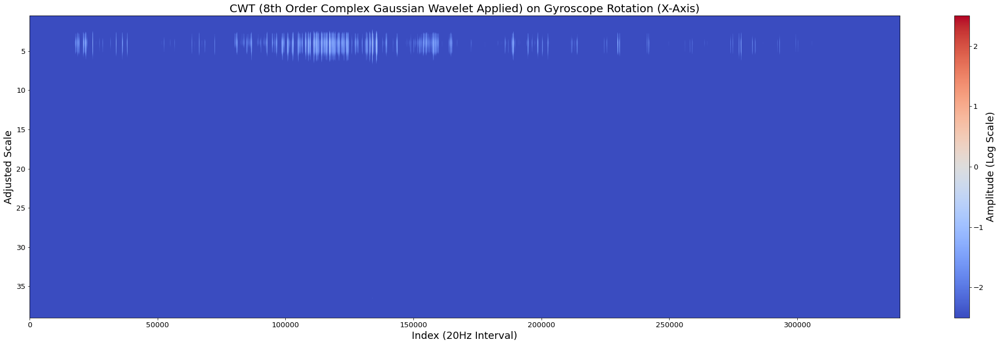

In [ ]:
# Plot Graph (2D) - Log Scale Applied to Amplitude
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

# Since the amplitude has quite a wide minimum and maximum range from the average, we would scale it using the log of the absolute value of the magnitude instead 


plt.figure(figsize=(35,10))
plt.imshow(np.log(abs(cwt_coef)), cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), scale.max(), scale.min()-0.5])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (8th Order Complex Gaussian Wavelet Applied) on Gyroscope Rotation (X-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

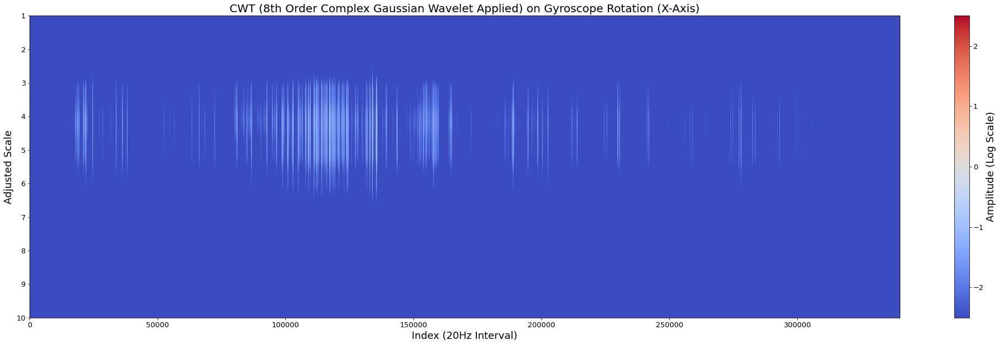

In [ ]:
# Plot Graph (2D) - Log Scale Applied to Amplitude (Zoomed In version)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

plt.figure(figsize=(35,10))
plt.imshow(np.log(abs(cwt_coef))[0:10,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), 10, scale.min()])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (8th Order Complex Gaussian Wavelet Applied) on Gyroscope Rotation (X-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

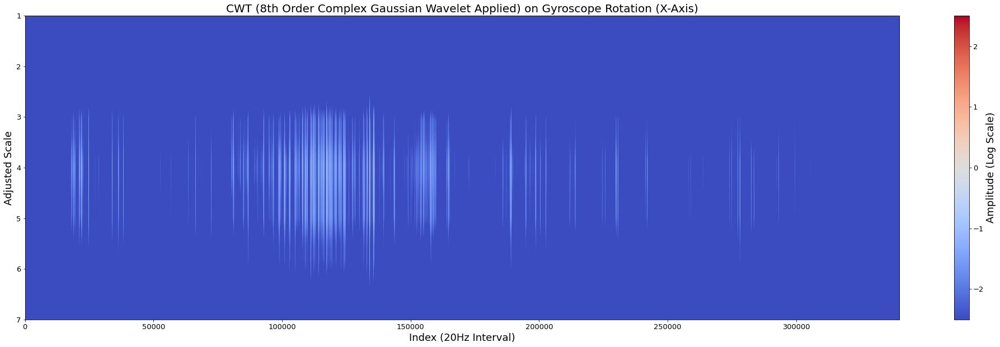

In [ ]:
# Threshold suppression of background noise (baseline)
test0 = np.log(abs(cwt_coef))
test0[test0 < -5] = -20

# Plot Graph (2D) - Log Scale Applied to Amplitude (Zoomed In version)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

plt.figure(figsize=(35,10))
plt.imshow(test0[0:7,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), 7, scale.min()])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (8th Order Complex Gaussian Wavelet Applied) on Gyroscope Rotation (X-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

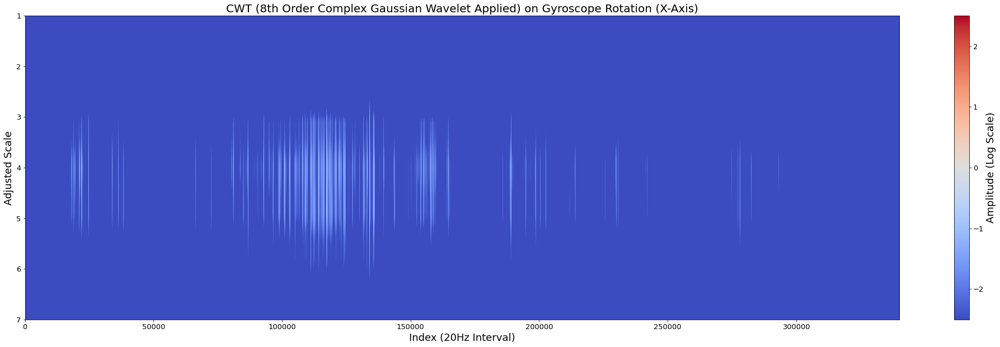

In [ ]:
# Threshold suppression of background noise
test1 = np.log(abs(cwt_coef))
test1[test1 < -4] = -20

# Plot Graph (2D) - Log Scale Applied to Amplitude (Zoomed In version)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

plt.figure(figsize=(35,10))
plt.imshow(test1[0:7,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef.shape[1]-1), 7, scale.min()])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (8th Order Complex Gaussian Wavelet Applied) on Gyroscope Rotation (X-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

### CWT Actual

We will only be performing CWT on the Linear Acceleration on the Z Axis and Gyroscope Roll Rotation on the X axis as those variables capture the motion of a vehicle encountering a pothole.

#### Get Magnitude of Linear Acceleration and Gyroscope Rotation

For the non-key acceleration and gyroscope that does not directly capture the action of hitting a pothole, we will be converting them into magnitude format as a bit of dimension reduction and to unpeg the values from any fixed orientation. For instance, linear acceleration on the x & y axes should be direction agnostic since a vehicle is free to travel in any heading on a horizontal plane. Likewise, for azimuth/yaw gyroscope rotations, the vehicle may turn in any direction on a horizontal plane, and it is not indicative of any road anomally per se. Lastly, for a bicycle (or any single tracked vehicle), such vehicles are generally in a constant state of wobble (roll rotation) due to the act of balancing on those vehicles. 

In [ ]:
# Get magnitude of xy-axes linear acceleration
# we will peg the to using the filtered results using the same filters applied to the z-axis (main target)
# F1
df["LA_xy_mag"] = np.sqrt(df['LINEAR ACCELERATION X_f1 (m/sÂ²)']**2 + df['LINEAR ACCELERATION Y_f1 (m/sÂ²)']**2)

In [ ]:
# Get magnitude of yz-axes gyroscope rotation
# we will peg the to using the filtered results using the same filters applied to the x-axis (main target)
# F1
# This step has been dropped as it doesn't correlate well with pothole detection as it is too sensitive to noise
#df["GY_yz_mag"] = np.sqrt(df['GYROSCOPE Y_f1 (rad/s)']**2 + df['GYROSCOPE Z_f1 (rad/s)']**2)

In [ ]:
# Inspect results
df.head()

,SN,LINEAR ACCELERATION X (m/sÂ²),LINEAR ACCELERATION Y (m/sÂ²),LINEAR ACCELERATION Z (m/sÂ²),GYROSCOPE X (rad/s),GYROSCOPE Y (rad/s),GYROSCOPE Z (rad/s),LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,LINEAR ACCELERATION X_f1 (m/sÂ²),LINEAR ACCELERATION Y_f1 (m/sÂ²),LINEAR ACCELERATION Z_f1 (m/sÂ²),GYROSCOPE X_f1 (rad/s),GYROSCOPE Y_f1 (rad/s),GYROSCOPE Z_f1 (rad/s),LA_xy_mag
0,0,-0.020885,-0.054002,-0.067950,0.000324,-0.002306,0.001333,NaN,NaN,NaN,NaN,NaN,115005,2020-03-16 12:35:01:128,NaN,NaN,5.0,0.0,0.0,0,0.000089,-0.000066,0.000072,0.000006,-0.000007,0.000006,0.000111
1,1,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115055,2020-03-16 12:35:01:178,NaN,NaN,5.0,0.0,1.0,0,-0.012132,-0.028744,0.027938,-0.001205,-0.000453,0.000156,0.031200
2,2,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115104,2020-03-16 12:35:01:227,NaN,NaN,5.0,0.0,2.0,0,-0.013403,-0.027335,0.027394,-0.000924,-0.000459,0.000005,0.030445
3,3,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115154,2020-03-16 12:35:01:277,NaN,NaN,5.0,0.0,3.0,0,-0.001078,-0.000169,0.001807,0.000361,0.000002,-0.000102,0.001091
4,4,-0.018470,-0.057635,-0.056414,0.003379,0.000748,0.000111,NaN,NaN,NaN,NaN,NaN,115204,2020-03-16 12:35:01:327,NaN,NaN,5.0,0.0,4.0,0,0.012977,0.021893,-0.020197,0.000922,0.000431,0.000148,0.025450


Peaks seem to line up pretty well. Potential candidate to support anomaly detection.

<Figure size 432x288 with 0 Axes>

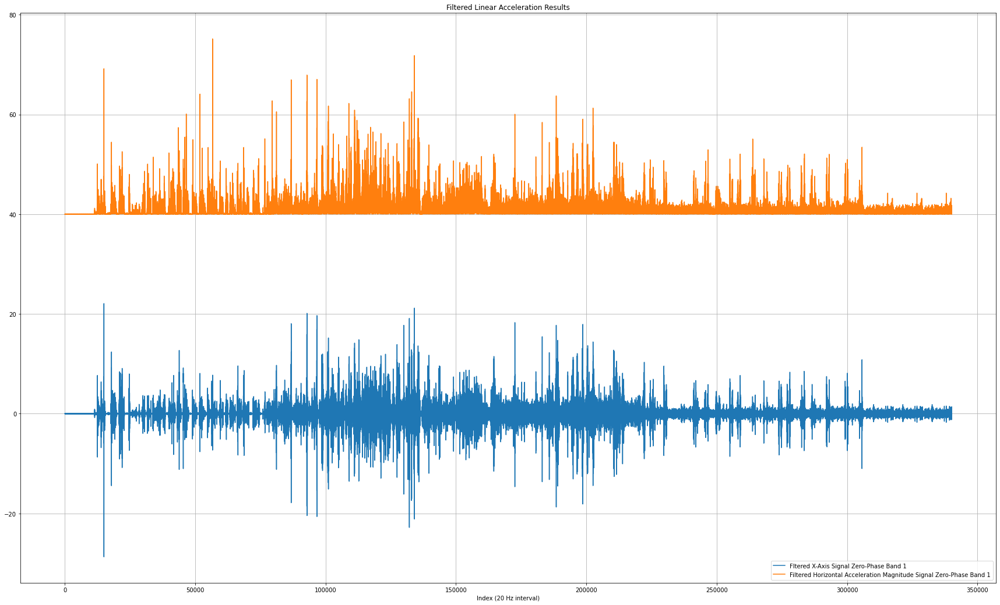

In [ ]:
# Plot results
t = df['SN']

plt.figure()
plt.clf()
plt.figure(figsize=(30, 18))
plt.title("Filtered Linear Acceleration Results")
plt.plot(t, df['LINEAR ACCELERATION X_f1 (m/sÂ²)'], label='Fltered X-Axis Signal Zero-Phase Band 1')
plt.plot(t, df['LA_xy_mag']+40, label='Filtered Horizontal Acceleration Magnitude Signal Zero-Phase Band 1')

plt.xlabel('Index (20 Hz interval)')
#plt.hlines([-a, a], 0, T, linestyles='--')
plt.grid(True)
plt.axis('tight')
plt.legend(loc='lower right')

plt.show()

#### Perform CWT on Magnitudes of XY Linear Acceleration

In [ ]:
# We will be performing CWT on the magnitude values
# the settings used will be pegged to the main target values
#df["LA_xy_mag"] W2
#df["GY_yz_mag"] W1


In [ ]:
# We will be performing CWT on the magnitude values
# the settings used will be pegged to the main target values

# Perform CWT on Linear Acceleration


#pywt.cwt(data, scales, wavelet)
# each row corresponds the the number of scales sampled
# each col of the coefficients output corresponds to the number observations in our data
cwt_coef_LA_XY_F1W2, cwt_freqs_LA_XY_F1W2 = pywt.cwt(df["LA_xy_mag"], scale, wavelet2, sampling_period = dt)

# Get the natural log (base e) of the magnitude of the coefficient 
cwt_coef_LA_XY_F1W2_log = np.log(abs(cwt_coef_LA_XY_F1W2))

# List of scale names
append_str = "LA_XY_CWT - "
cwt_freqs_LA_XY_F1W2_name = [append_str + str(sub.round(2)) for sub in cwt_freqs_LA_XY_F1W2] 

# Check dimension of arrays created
print(cwt_coef_LA_XY_F1W2.shape)
print(cwt_freqs_LA_XY_F1W2.shape)

# Inspect Output Sample
print(cwt_freqs_LA_XY_F1W2.round(2))
print(cwt_coef_LA_XY_F1W2_log[0:5,0:3])
print(cwt_freqs_LA_XY_F1W2_name)

(39, 340105)
(39,)
[14.    7.    4.67  3.5   2.8   2.33  2.    1.75  1.56  1.4   1.27  1.17
  1.08  1.    0.93  0.87  0.82  0.78  0.74  0.7   0.67  0.64  0.61  0.58
  0.56  0.54  0.52  0.5   0.48  0.47  0.45  0.44  0.42  0.41  0.4   0.39
  0.38  0.37  0.36]
[[-5.76549545 -5.16401316 -5.09237737]
 [-4.74109338 -4.45258684 -4.21604624]
 [-4.35992788 -4.21988809 -4.16072026]
 [-4.53840199 -4.51132648 -4.55945559]
 [-4.56098993 -4.5503521  -4.60195086]]
['LA_XY_CWT - 14.0', 'LA_XY_CWT - 7.0', 'LA_XY_CWT - 4.67', 'LA_XY_CWT - 3.5', 'LA_XY_CWT - 2.8', 'LA_XY_CWT - 2.33', 'LA_XY_CWT - 2.0', 'LA_XY_CWT - 1.75', 'LA_XY_CWT - 1.56', 'LA_XY_CWT - 1.4', 'LA_XY_CWT - 1.27', 'LA_XY_CWT - 1.17', 'LA_XY_CWT - 1.08', 'LA_XY_CWT - 1.0', 'LA_XY_CWT - 0.93', 'LA_XY_CWT - 0.87', 'LA_XY_CWT - 0.82', 'LA_XY_CWT - 0.78', 'LA_XY_CWT - 0.74', 'LA_XY_CWT - 0.7', 'LA_XY_CWT - 0.67', 'LA_XY_CWT - 0.64', 'LA_XY_CWT - 0.61', 'LA_XY_CWT - 0.58', 'LA_XY_CWT - 0.56', 'LA_XY_CWT - 0.54', 'LA_XY_CWT - 0.52', 'LA_XY_CWT -

The results are seem promising in terms of filtering out normal cycling activity, but it is not so good in filtering out humps and speed strips from potholes. Potential road anomalies can be seen in the dark orange / red regions. Probably only the first 10 scales may be valuable for modelling.

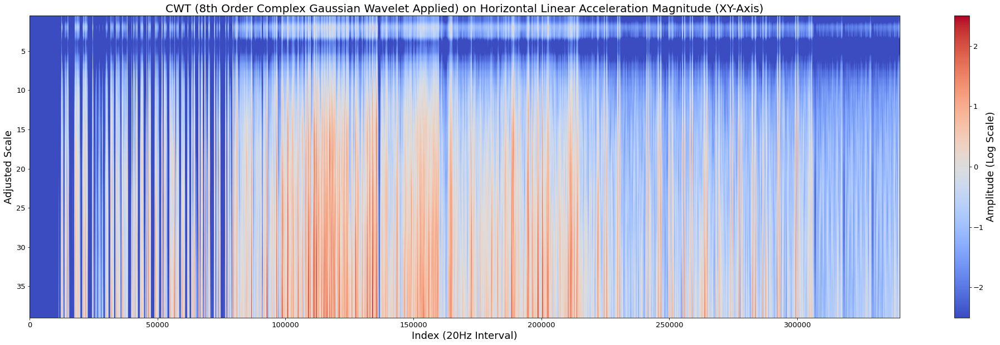

In [ ]:
# Plot Graph (2D)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

# Since the amplitude has quite a wide minimum and maximum range from the average, we would scale it using the log of the absolute value of the magnitude instead 


plt.figure(figsize=(35,10))
plt.imshow(np.log(abs(cwt_coef_LA_XY_F1W2)), cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef_LA_XY_F1W2.shape[1]-1), scale.max(), scale.min()-0.5])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (8th Order Complex Gaussian Wavelet Applied) on Horizontal Linear Acceleration Magnitude (XY-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

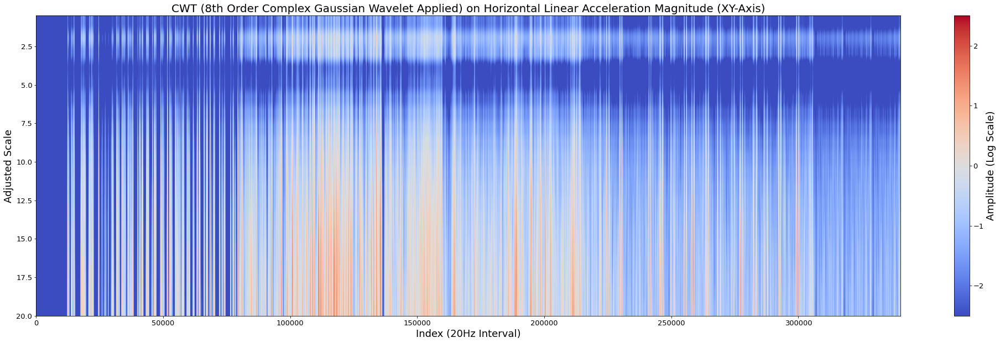

In [ ]:
# Plot Graph (2D)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

# Since the amplitude has quite a wide minimum and maximum range from the average, we would scale it using the log of the absolute value of the magnitude instead 


plt.figure(figsize=(35,10))
plt.imshow(np.log(abs(cwt_coef_LA_XY_F1W2))[0:20,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef_LA_XY_F1W2.shape[1]-1), 20, scale.min()-0.5])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (8th Order Complex Gaussian Wavelet Applied) on Horizontal Linear Acceleration Magnitude (XY-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

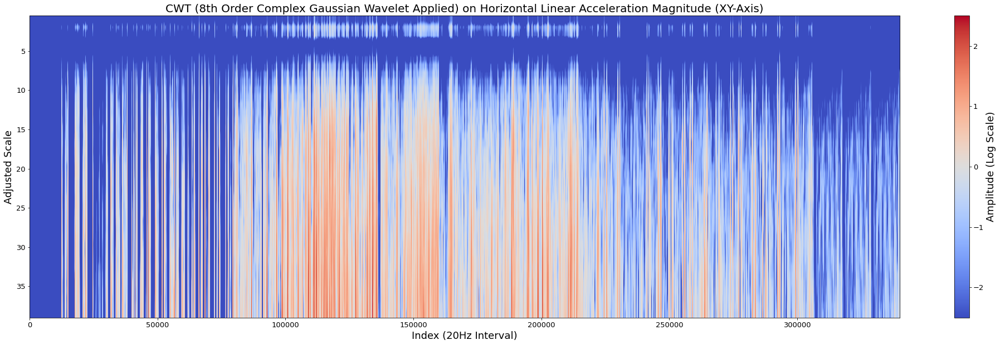

In [ ]:
# Threshold suppression of background noise (baseline)
test0 = np.log(abs(cwt_coef_LA_XY_F1W2))
test0[test0 < -2] = -10

# Plot Graph (2D)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

# Since the amplitude has quite a wide minimum and maximum range from the average, we would scale it using the log of the absolute value of the magnitude instead 


plt.figure(figsize=(35,10))
plt.imshow(test0[0:39,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef_LA_XY_F1W2.shape[1]-1), 39, scale.min()-0.5])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (8th Order Complex Gaussian Wavelet Applied) on Horizontal Linear Acceleration Magnitude (XY-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

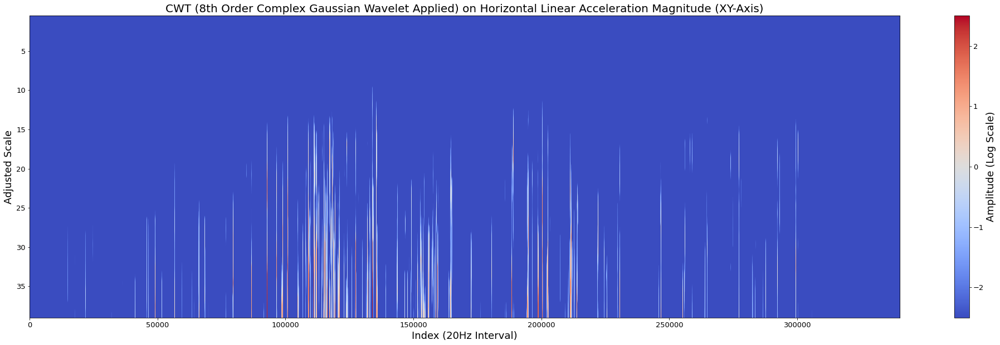

In [ ]:
# Threshold suppression of background noise (baseline)
test1 = np.log(abs(cwt_coef_LA_XY_F1W2))
test1[test1 < 0.7] = -10

# Plot Graph (2D)
# To interprete this graph, look out for regions with sharp changes in amplitude (dark blue or dark red regions),
# which may hint of potential potholes or bumps
# Identify the observation # affected, and find the GPS coordinates of those regions.

# Since the amplitude has quite a wide minimum and maximum range from the average, we would scale it using the log of the absolute value of the magnitude instead 


plt.figure(figsize=(35,10))
plt.imshow(test1[0:39,], cmap = 'coolwarm', aspect = 'auto', extent = [0, (cwt_coef_LA_XY_F1W2.shape[1]-1), 39, scale.min()-0.5])
cbar = plt.colorbar()
cbar.set_label(label='Amplitude (Log Scale)', size=18)
cbar.ax.tick_params(labelsize=13)
plt.title("CWT (8th Order Complex Gaussian Wavelet Applied) on Horizontal Linear Acceleration Magnitude (XY-Axis)", fontsize = 20)
plt.xlabel("Index (20Hz Interval)", fontsize = 18)
plt.ylabel("Adjusted Scale", fontsize = 18)
plt.tick_params(axis='both', which='major', labelsize = 13)

plt.clim(-2.5, 2.5) # Set min-max range of color bar
plt.show()

In [ ]:
del test0
del test1

#### Perform CWT on potential candidates

In [ ]:
# Perform CWT on candidate signal (Linear Acceleration - Z axis)

#pywt.cwt(data, scales, wavelet)
# each row corresponds the the number of scales sampled
# each col of the coefficients output corresponds to the number observations in our data
cwt_coef_LA_Z_F1W2, cwt_freqs_LA_Z_F1W2 = pywt.cwt(df['LINEAR ACCELERATION Z_f1 (m/sÂ²)'], scale, wavelet2, sampling_period = dt)

# Get the natural log (base e) of the magnitude of the coefficient 
cwt_coef_LA_Z_F1W2_log = np.log(abs(cwt_coef_LA_Z_F1W2))

# List of scale names
# Note unlike the other variables, we are setting the function to round at 3dp instead of 2dp, to avoid variables with the same name at higher scales (wavelet frequencies) used
# This is especially since we're using all the scales generated for our analysis here
append_str = "LA_Z_CWT - "
cwt_freqs_LA_Z_F1W2_name = [append_str + str(sub.round(3)) for sub in cwt_freqs_LA_Z_F1W2] 

# Check dimension of arrays created
print(cwt_coef_LA_Z_F1W2.shape)
print(cwt_freqs_LA_Z_F1W2.shape)

# Inspect Output Sample
print(cwt_freqs_LA_Z_F1W2.round(2))
print(cwt_coef_LA_Z_F1W2_log[0:5,0:3])
print(cwt_freqs_LA_Z_F1W2_name)

(39, 340105)
(39,)
[14.    7.    4.67  3.5   2.8   2.33  2.    1.75  1.56  1.4   1.27  1.17
  1.08  1.    0.93  0.87  0.82  0.78  0.74  0.7   0.67  0.64  0.61  0.58
  0.56  0.54  0.52  0.5   0.48  0.47  0.45  0.44  0.42  0.41  0.4   0.39
  0.38  0.37  0.36]
[[-5.87454823 -5.28495605 -5.35705936]
 [-5.03056055 -4.94599163 -5.05009652]
 [-4.26440859 -4.12012909 -3.978796  ]
 [-3.90891911 -3.74610864 -3.60915201]
 [-3.80015418 -3.66086597 -3.5820804 ]]
['LA_Z_CWT - 14.0', 'LA_Z_CWT - 7.0', 'LA_Z_CWT - 4.667', 'LA_Z_CWT - 3.5', 'LA_Z_CWT - 2.8', 'LA_Z_CWT - 2.333', 'LA_Z_CWT - 2.0', 'LA_Z_CWT - 1.75', 'LA_Z_CWT - 1.556', 'LA_Z_CWT - 1.4', 'LA_Z_CWT - 1.273', 'LA_Z_CWT - 1.167', 'LA_Z_CWT - 1.077', 'LA_Z_CWT - 1.0', 'LA_Z_CWT - 0.933', 'LA_Z_CWT - 0.875', 'LA_Z_CWT - 0.824', 'LA_Z_CWT - 0.778', 'LA_Z_CWT - 0.737', 'LA_Z_CWT - 0.7', 'LA_Z_CWT - 0.667', 'LA_Z_CWT - 0.636', 'LA_Z_CWT - 0.609', 'LA_Z_CWT - 0.583', 'LA_Z_CWT - 0.56', 'LA_Z_CWT - 0.538', 'LA_Z_CWT - 0.519', 'LA_Z_CWT - 0.5', 'LA_

In [ ]:
# Perform CWT on candidate signal (Gyroscope Rotation - X axis)

#pywt.cwt(data, scales, wavelet)
# each row corresponds the the number of scales sampled
# each col of the coefficients output corresponds to the number observations in our data
cwt_coef_GY_X_F1W2, cwt_freqs_GY_X_F1W2 = pywt.cwt(df['GYROSCOPE X_f1 (rad/s)'], scale, wavelet1, sampling_period = dt)

# Get the natural log (base e) of the magnitude of the coefficient 
cwt_coef_GY_X_F1W2_log = np.log(abs(cwt_coef_GY_X_F1W2))

# List of scale names
append_str = "GY_X_CWT - "
cwt_freqs_GY_X_F1W2_name = [append_str + str(sub.round(2)) for sub in cwt_freqs_GY_X_F1W2] 

# Check dimension of arrays created
print(cwt_coef_GY_X_F1W2.shape)
print(cwt_freqs_GY_X_F1W2.shape)

# Inspect Output Sample
print(cwt_freqs_GY_X_F1W2.round(2))
print(cwt_coef_GY_X_F1W2_log[0:5,0:3])
print(cwt_freqs_GY_X_F1W2_name)

(39, 340105)
(39,)
[10.    5.    3.33  2.5   2.    1.67  1.43  1.25  1.11  1.    0.91  0.83
  0.77  0.71  0.67  0.62  0.59  0.56  0.53  0.5   0.48  0.45  0.43  0.42
  0.4   0.38  0.37  0.36  0.34  0.33  0.32  0.31  0.3   0.29  0.29  0.28
  0.27  0.26  0.26]
[[-8.67344226 -8.18096562 -9.51154272]
 [-7.56510177 -7.3105117  -7.03103182]
 [-7.24817592 -6.94658192 -6.78621032]
 [-7.19371381 -6.98199729 -6.89803173]
 [-7.26125509 -7.15238063 -7.13852114]]
['GY_X_CWT - 10.0', 'GY_X_CWT - 5.0', 'GY_X_CWT - 3.33', 'GY_X_CWT - 2.5', 'GY_X_CWT - 2.0', 'GY_X_CWT - 1.67', 'GY_X_CWT - 1.43', 'GY_X_CWT - 1.25', 'GY_X_CWT - 1.11', 'GY_X_CWT - 1.0', 'GY_X_CWT - 0.91', 'GY_X_CWT - 0.83', 'GY_X_CWT - 0.77', 'GY_X_CWT - 0.71', 'GY_X_CWT - 0.67', 'GY_X_CWT - 0.62', 'GY_X_CWT - 0.59', 'GY_X_CWT - 0.56', 'GY_X_CWT - 0.53', 'GY_X_CWT - 0.5', 'GY_X_CWT - 0.48', 'GY_X_CWT - 0.45', 'GY_X_CWT - 0.43', 'GY_X_CWT - 0.42', 'GY_X_CWT - 0.4', 'GY_X_CWT - 0.38', 'GY_X_CWT - 0.37', 'GY_X_CWT - 0.36', 'GY_X_CWT - 0.34', 

#### Apply thresholding to suppress noise

In [ ]:
# Threshold suppression of background noise (baseline)
# #impute values which fail to an arbitrarily low value for better contrast
cwt_coef_LA_XY_cleaned = cwt_coef_LA_XY_F1W2_log
cwt_coef_LA_XY_cleaned[cwt_coef_LA_XY_cleaned < -2] = -20

cwt_coef_LA_Z_cleaned = cwt_coef_LA_Z_F1W2_log
cwt_coef_LA_Z_cleaned[cwt_coef_LA_Z_cleaned < 0.5] = -20

cwt_coef_GY_X_cleaned = cwt_coef_GY_X_F1W2_log
cwt_coef_GY_X_cleaned[cwt_coef_GY_X_cleaned < -5] = -20

#### Append CWT Coefficients to Main Data

In [ ]:
# Convert coefficients from an array format to a dataframe (Linear Acceleration Z-Axis)
df_LA_Z_cwt = pd.DataFrame(cwt_coef_LA_Z_cleaned).transpose()
df_LA_Z_cwt.columns = cwt_freqs_LA_Z_F1W2_name
df_LA_Z_cwt.head(3)

,LA_Z_CWT - 14.0,LA_Z_CWT - 7.0,LA_Z_CWT - 4.667,LA_Z_CWT - 3.5,LA_Z_CWT - 2.8,LA_Z_CWT - 2.333,LA_Z_CWT - 2.0,LA_Z_CWT - 1.75,LA_Z_CWT - 1.556,LA_Z_CWT - 1.4,LA_Z_CWT - 1.273,LA_Z_CWT - 1.167,LA_Z_CWT - 1.077,LA_Z_CWT - 1.0,LA_Z_CWT - 0.933,LA_Z_CWT - 0.875,LA_Z_CWT - 0.824,LA_Z_CWT - 0.778,LA_Z_CWT - 0.737,LA_Z_CWT - 0.7,LA_Z_CWT - 0.667,LA_Z_CWT - 0.636,LA_Z_CWT - 0.609,LA_Z_CWT - 0.583,LA_Z_CWT - 0.56,LA_Z_CWT - 0.538,LA_Z_CWT - 0.519,LA_Z_CWT - 0.5,LA_Z_CWT - 0.483,LA_Z_CWT - 0.467,LA_Z_CWT - 0.452,LA_Z_CWT - 0.437,LA_Z_CWT - 0.424,LA_Z_CWT - 0.412,LA_Z_CWT - 0.4,LA_Z_CWT - 0.389,LA_Z_CWT - 0.378,LA_Z_CWT - 0.368,LA_Z_CWT - 0.359
0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0
1,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0
2,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0


In [ ]:
# Convert coefficients from an array format to a dataframe (Gyroscope Rotation X-Axis)
df_GY_X_cwt = pd.DataFrame(cwt_coef_GY_X_cleaned).transpose()
df_GY_X_cwt.columns = cwt_freqs_GY_X_F1W2_name
df_GY_X_cwt.head(3)

,GY_X_CWT - 10.0,GY_X_CWT - 5.0,GY_X_CWT - 3.33,GY_X_CWT - 2.5,GY_X_CWT - 2.0,GY_X_CWT - 1.67,GY_X_CWT - 1.43,GY_X_CWT - 1.25,GY_X_CWT - 1.11,GY_X_CWT - 1.0,GY_X_CWT - 0.91,GY_X_CWT - 0.83,GY_X_CWT - 0.77,GY_X_CWT - 0.71,GY_X_CWT - 0.67,GY_X_CWT - 0.62,GY_X_CWT - 0.59,GY_X_CWT - 0.56,GY_X_CWT - 0.53,GY_X_CWT - 0.5,GY_X_CWT - 0.48,GY_X_CWT - 0.45,GY_X_CWT - 0.43,GY_X_CWT - 0.42,GY_X_CWT - 0.4,GY_X_CWT - 0.38,GY_X_CWT - 0.37,GY_X_CWT - 0.36,GY_X_CWT - 0.34,GY_X_CWT - 0.33,GY_X_CWT - 0.32,GY_X_CWT - 0.31,GY_X_CWT - 0.3,GY_X_CWT - 0.29,GY_X_CWT - 0.29,GY_X_CWT - 0.28,GY_X_CWT - 0.27,GY_X_CWT - 0.26,GY_X_CWT - 0.26
0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0
1,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0
2,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0


In [ ]:
# Convert coefficients from an array format to a dataframe (Horizontal Acceleration Magnitude)
df_LA_XY_cwt = pd.DataFrame(cwt_coef_LA_XY_cleaned).transpose()
df_LA_XY_cwt.columns = cwt_freqs_LA_XY_F1W2_name
df_LA_XY_cwt.head(3)


,LA_XY_CWT - 14.0,LA_XY_CWT - 7.0,LA_XY_CWT - 4.67,LA_XY_CWT - 3.5,LA_XY_CWT - 2.8,LA_XY_CWT - 2.33,LA_XY_CWT - 2.0,LA_XY_CWT - 1.75,LA_XY_CWT - 1.56,LA_XY_CWT - 1.4,LA_XY_CWT - 1.27,LA_XY_CWT - 1.17,LA_XY_CWT - 1.08,LA_XY_CWT - 1.0,LA_XY_CWT - 0.93,LA_XY_CWT - 0.87,LA_XY_CWT - 0.82,LA_XY_CWT - 0.78,LA_XY_CWT - 0.74,LA_XY_CWT - 0.7,LA_XY_CWT - 0.67,LA_XY_CWT - 0.64,LA_XY_CWT - 0.61,LA_XY_CWT - 0.58,LA_XY_CWT - 0.56,LA_XY_CWT - 0.54,LA_XY_CWT - 0.52,LA_XY_CWT - 0.5,LA_XY_CWT - 0.48,LA_XY_CWT - 0.47,LA_XY_CWT - 0.45,LA_XY_CWT - 0.44,LA_XY_CWT - 0.42,LA_XY_CWT - 0.41,LA_XY_CWT - 0.4,LA_XY_CWT - 0.39,LA_XY_CWT - 0.38,LA_XY_CWT - 0.37,LA_XY_CWT - 0.36
0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0
1,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0
2,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0


In [ ]:
# Append dataframes together
# Only append information rich zones (scales) that contains the target pattern
# For simplicity sake of coding later on, we're only using the first 10 scales (high frequency zones) 
# as most of the information can be found there, and are likely related to the presence of road anomalies
df2 = pd.concat([df, df_LA_Z_cwt.iloc[:, 0:10], df_LA_XY_cwt.iloc[:, 0:10], df_GY_X_cwt.iloc[:, 0:10]], axis=1, join='inner')
df2.shape

(340105, 57)

In [ ]:
# Convert coefficients from an array format to a dataframe (Horizontal Acceleration Magnitude)
print(df_LA_XY_cwt.shape)
print(df_LA_Z_cwt.shape)
print(df_GY_X_cwt.shape)

(340105, 39)
(340105, 39)
(340105, 39)


In [ ]:
# Inspect dataframe
df2.head(3)

,SN,LINEAR ACCELERATION X (m/sÂ²),LINEAR ACCELERATION Y (m/sÂ²),LINEAR ACCELERATION Z (m/sÂ²),GYROSCOPE X (rad/s),GYROSCOPE Y (rad/s),GYROSCOPE Z (rad/s),LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,LINEAR ACCELERATION X_f1 (m/sÂ²),LINEAR ACCELERATION Y_f1 (m/sÂ²),LINEAR ACCELERATION Z_f1 (m/sÂ²),GYROSCOPE X_f1 (rad/s),GYROSCOPE Y_f1 (rad/s),GYROSCOPE Z_f1 (rad/s),LA_xy_mag,LA_Z_CWT - 14.0,LA_Z_CWT - 7.0,LA_Z_CWT - 4.667,LA_Z_CWT - 3.5,LA_Z_CWT - 2.8,LA_Z_CWT - 2.333,LA_Z_CWT - 2.0,LA_Z_CWT - 1.75,LA_Z_CWT - 1.556,LA_Z_CWT - 1.4,LA_XY_CWT - 14.0,LA_XY_CWT - 7.0,LA_XY_CWT - 4.67,LA_XY_CWT - 3.5,LA_XY_CWT - 2.8,LA_XY_CWT - 2.33,LA_XY_CWT - 2.0,LA_XY_CWT - 1.75,LA_XY_CWT - 1.56,LA_XY_CWT - 1.4,GY_X_CWT - 10.0,GY_X_CWT - 5.0,GY_X_CWT - 3.33,GY_X_CWT - 2.5,GY_X_CWT - 2.0,GY_X_CWT - 1.67,GY_X_CWT - 1.43,GY_X_CWT - 1.25,GY_X_CWT - 1.11,GY_X_CWT - 1.0
0,0,-0.020885,-0.054002,-0.067950,0.000324,-0.002306,0.001333,NaN,NaN,NaN,NaN,NaN,115005,2020-03-16 12:35:01:128,NaN,NaN,5.0,0.0,0.0,0,0.000089,-0.000066,0.000072,0.000006,-0.000007,0.000006,0.000111,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0
1,1,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115055,2020-03-16 12:35:01:178,NaN,NaN,5.0,0.0,1.0,0,-0.012132,-0.028744,0.027938,-0.001205,-0.000453,0.000156,0.031200,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0
2,2,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115104,2020-03-16 12:35:01:227,NaN,NaN,5.0,0.0,2.0,0,-0.013403,-0.027335,0.027394,-0.000924,-0.000459,0.000005,0.030445,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0


In [ ]:
# Inspect dataframe
df2.shape

(340105, 57)

### Find Distributions of CWT Coefficients (Magnitude of Amplitude)

#### Define Summary Stats Functions

In [ ]:
# Define stats functions

def q05 (x) :
  return x.quantile(0.05)
def q25 (x) :
  return x.quantile(0.25)
def q50 (x) :
  return x.quantile(0.5)
def q75 (x) :
  return x.quantile(0.75)
def q95 (x) :
  return x.quantile(0.95)
def meanCustom (x) :
  return x.mean()
def Low_Limit (x):
  return x.quantile(0.5) - 1.5 * (x.quantile(0.75) - x.quantile(0.25))
def Upp_Limit (x):
  return x.quantile(0.5) + 1.5 * (x.quantile(0.75) - x.quantile(0.25))


#### Gyroscope Data (X-Axis)

Unsurprisingly, pothole events tend to register the highest magnitude change in amplitude. Since bumps makes up a very small set of the data, likely using the q95 datapoints would be the most relevant for deciding a cut off point for thresholding. Below are the q95 values of key scales:





In [ ]:
# Group the Gyroscope CWT Data by Event across different wavelet scales / frequencies
# Selected stats summary
# Focus more on higher value amplitude changes
# column names must match the wavelet coefficient scales appended to the main data frame

df2.groupby(
  ['Event']
  ).agg(
  {   
      # Scales 3 to 8
      cwt_freqs_GY_X_F1W2_name[0]: [q75, q95],
      cwt_freqs_GY_X_F1W2_name[1]: [q75, q95],
      cwt_freqs_GY_X_F1W2_name[2]: [q75, q95],
      cwt_freqs_GY_X_F1W2_name[3]: [q75, q95],
      cwt_freqs_GY_X_F1W2_name[4]: [q75, q95],
      cwt_freqs_GY_X_F1W2_name[5]: [q75, q95],
      cwt_freqs_GY_X_F1W2_name[6]: [q75, q95],   
      cwt_freqs_GY_X_F1W2_name[7]: [q75, q95],   
      cwt_freqs_GY_X_F1W2_name[8]: [q75, q95],   
      cwt_freqs_GY_X_F1W2_name[9]: [q75, q95]
  }
)

GY_X_CWT - 10.0             ... GY_X_CWT - 1.0           
                  q75        q95  ...            q75        q95
Event                             ...                          
0          -20.000000 -20.000000  ...      -20.00000 -20.000000
1           -4.166676  -3.180155  ...       -4.98819  -4.182390
2           -4.849033  -3.794356  ...      -20.00000  -4.724718
3          -20.000000  -4.362491  ...      -20.00000 -20.000000
4           -4.526126  -3.650004  ...      -20.00000  -4.620313
9          -20.000000  -4.250192  ...      -20.00000 -20.000000

[6 rows x 20 columns]

In [ ]:
# Group the Gyroscope CWT Data by Event across different wavelet scales / frequencies
# Full stats summary
# column names must match the wavelet coefficient scales appended to the main data frame

df_stats_GY_X_cwt = df2.groupby(
  ['Event']
  ).agg(
  {   
      # Scales 3 to 8
      cwt_freqs_GY_X_F1W2_name[0]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_GY_X_F1W2_name[1]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_GY_X_F1W2_name[2]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_GY_X_F1W2_name[3]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_GY_X_F1W2_name[4]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_GY_X_F1W2_name[5]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_GY_X_F1W2_name[6]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_GY_X_F1W2_name[7]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_GY_X_F1W2_name[8]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_GY_X_F1W2_name[9]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit]
  }
)
  
df_stats_GY_X_cwt

GY_X_CWT - 10.0              ... GY_X_CWT - 1.0                      
            Low_Limit   min   q05  ...            q95        max  Upp_Limit
Event                              ...                                     
0          -20.000000 -20.0 -20.0  ...     -20.000000 -20.000000 -20.000000
1          -28.712924 -20.0 -20.0  ...      -4.182390  -2.743730   2.517715
2          -42.726450 -20.0 -20.0  ...      -4.724718  -3.784181 -20.000000
3          -20.000000 -20.0 -20.0  ...     -20.000000  -3.217086 -20.000000
4          -43.210811 -20.0 -20.0  ...      -4.620313  -3.669593 -20.000000
9          -20.000000 -20.0 -20.0  ...     -20.000000  -2.890184 -20.000000

[6 rows x 100 columns]

#### Linear Acceleration Data (XY-Axis)

Unsurprisingly, pothole events tend to register the highest magnitude change in amplitude. Since bumps makes up a very small set of the data, likely using the q75 and q95 datapoints would be the most relevant for deciding a cut off point for thresholding. Below are the q95 values of key scales:


In [ ]:
# Group the Linear Acceleration CWT Data by Event across different wavelet scales / frequencies
# Selected stats summary
# Focus more on higher value amplitude changes
# column names must match the wavelet coefficient scales appended to the main data frame

df2.groupby(
  ['Event']
  ).agg(
  {
      # Scales 1 to 5
      cwt_freqs_LA_Z_F1W2_name[0]: [q75, q95],
      cwt_freqs_LA_Z_F1W2_name[1]: [q75, q95],
      cwt_freqs_LA_Z_F1W2_name[2]: [q75, q95],
      cwt_freqs_LA_Z_F1W2_name[3]: [q75, q95],   
      cwt_freqs_LA_Z_F1W2_name[4]: [q75, q95],

      # Scales 6 to 10
      cwt_freqs_LA_Z_F1W2_name[5]: [q75, q95],
      cwt_freqs_LA_Z_F1W2_name[6]: [q75, q95],
      cwt_freqs_LA_Z_F1W2_name[7]: [q75, q95],
      cwt_freqs_LA_Z_F1W2_name[8]: [q75, q95],
      cwt_freqs_LA_Z_F1W2_name[9]: [q75, q95]

  }
)

LA_Z_CWT - 14.0       LA_Z_CWT - 7.0  ... LA_Z_CWT - 1.556 LA_Z_CWT - 1.4      
                  q75   q95            q75  ...              q95            q75   q95
Event                                       ...                                      
0               -20.0 -20.0          -20.0  ...            -20.0          -20.0 -20.0
1               -20.0 -20.0          -20.0  ...            -20.0          -20.0 -20.0
2               -20.0 -20.0          -20.0  ...            -20.0          -20.0 -20.0
3               -20.0 -20.0          -20.0  ...            -20.0          -20.0 -20.0
4               -20.0 -20.0          -20.0  ...            -20.0          -20.0 -20.0
9               -20.0 -20.0          -20.0  ...            -20.0          -20.0 -20.0

[6 rows x 20 columns]

In [ ]:
# Group the Linear Acceleration CWT Data by Event across different wavelet scales / frequencies
# Full stats summary

df_stats_LA_Z_cwt = df2.groupby(
  ['Event']
  ).agg(
  {
      # Scales 1 to 5
      cwt_freqs_LA_Z_F1W2_name[0]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_Z_F1W2_name[1]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_Z_F1W2_name[2]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_Z_F1W2_name[3]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],   
      cwt_freqs_LA_Z_F1W2_name[4]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],

      # Scales 6 to 10
      cwt_freqs_LA_Z_F1W2_name[5]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_Z_F1W2_name[6]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_Z_F1W2_name[7]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_Z_F1W2_name[8]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_Z_F1W2_name[9]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit]
  }
)
  
df_stats_LA_Z_cwt

LA_Z_CWT - 14.0                    ... LA_Z_CWT - 1.4                      
            Low_Limit   min   q05   q25  ...            q75   q95   max Upp_Limit
Event                                    ...                                     
0               -20.0 -20.0 -20.0 -20.0  ...          -20.0 -20.0 -20.0     -20.0
1               -20.0 -20.0 -20.0 -20.0  ...          -20.0 -20.0 -20.0     -20.0
2               -20.0 -20.0 -20.0 -20.0  ...          -20.0 -20.0 -20.0     -20.0
3               -20.0 -20.0 -20.0 -20.0  ...          -20.0 -20.0 -20.0     -20.0
4               -20.0 -20.0 -20.0 -20.0  ...          -20.0 -20.0 -20.0     -20.0
9               -20.0 -20.0 -20.0 -20.0  ...          -20.0 -20.0 -20.0     -20.0

[6 rows x 100 columns]

#### Linear Acceleration Data (Horizontal Linear Acceleration Magnitude)

Unsurprisingly, pothole events tend to register the highest magnitude change in amplitude. Since bumps makes up a very small set of the data, likely using the q75 and q95 datapoints would be the most relevant for deciding a cut off point for thresholding. Below are the q95 values of key scales:


In [ ]:
# Group the Linear Acceleration CWT Data by Event across different wavelet scales / frequencies
# Selected stats summary
# Focus more on higher value amplitude changes

df2.groupby(
  ['Event']
  ).agg(
  {
      # Scales 1 to 5
      cwt_freqs_LA_XY_F1W2_name[0]: [q75, q95],
      cwt_freqs_LA_XY_F1W2_name[1]: [q75, q95],
      cwt_freqs_LA_XY_F1W2_name[2]: [q75, q95],
      cwt_freqs_LA_XY_F1W2_name[3]: [q75, q95],   
      cwt_freqs_LA_XY_F1W2_name[4]: [q75, q95],

      # Scales 6 to 10
      cwt_freqs_LA_XY_F1W2_name[5]: [q75, q95],
      cwt_freqs_LA_XY_F1W2_name[6]: [q75, q95],
      cwt_freqs_LA_XY_F1W2_name[7]: [q75, q95],
      cwt_freqs_LA_XY_F1W2_name[8]: [q75, q95],
      cwt_freqs_LA_XY_F1W2_name[9]: [q75, q95]
   
  
  }
)

LA_XY_CWT - 14.0             ... LA_XY_CWT - 1.4           
                   q75        q95  ...             q75        q95
Event                              ...                           
0           -20.000000 -20.000000  ...      -20.000000 -20.000000
1            -0.790461   0.085400  ...        0.396174   1.247095
2            -0.987492  -0.240635  ...        0.124747   0.869454
3            -1.698522  -0.860100  ...       -0.572845   0.210239
4            -0.558424   0.311031  ...        0.582751   1.286684
9            -1.729271  -0.852225  ...       -0.359335   0.427818

[6 rows x 20 columns]

In [ ]:
# Group the Linear Acceleration CWT Data by Event across different wavelet scales / frequencies
# Full stats summary

df_stats_LA_XY_cwt = df2.groupby(
  ['Event']
  ).agg(
  {
      # Scales 1 to 5
      cwt_freqs_LA_XY_F1W2_name[0]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_XY_F1W2_name[1]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_XY_F1W2_name[2]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_XY_F1W2_name[3]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],   
      cwt_freqs_LA_XY_F1W2_name[4]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],

      # Scales 6 to 10
      cwt_freqs_LA_XY_F1W2_name[5]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_XY_F1W2_name[6]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_XY_F1W2_name[7]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_XY_F1W2_name[8]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit],
      cwt_freqs_LA_XY_F1W2_name[9]: [Low_Limit, min, q05, q25, q50, meanCustom, q75, q95, max, Upp_Limit]

  }
)

df_stats_LA_XY_cwt

LA_XY_CWT - 14.0              ... LA_XY_CWT - 1.4                     
             Low_Limit   min   q05  ...             q95       max  Upp_Limit
Event                               ...                                     
0           -20.000000 -20.0 -20.0  ...      -20.000000  1.198998 -20.000000
1           -30.246736 -20.0 -20.0  ...        1.247095  2.829607   1.669811
2           -30.079146 -20.0 -20.0  ...        0.869454  1.861279   1.340935
3           -47.452217 -20.0 -20.0  ...        0.210239  1.780947   0.555115
4           -30.453153 -20.0 -20.0  ...        1.286684  2.064768   1.972705
9           -47.406093 -20.0 -20.0  ...        0.427818  1.762743  28.401827

[6 rows x 100 columns]

## Windowing

We will attempt to use windowing of using the last 30 observations (1.5s for recordings at 20Hz) to determine whether there is a road anomaly or not. I've previously created a rolling window function in the irrFilter customer Python module which would compute key stats and append it as new cols to the dataframe.

We will only be applying the rolling window stats on the target filtered signals. The general ideal is to get some descriptive stats that may be indicative of a pothole event.

Note on threshold tests used:


*   varMag = varX.abs()
*   movExceedSD: (movAv + 2 * movStdDev) - varMag
*   movExceedIQR: (movMedian + 1.5 * movIQR) - varMag
*   movExceedP: (movPUpp) - varMag
*   movExceedUppLim: (maxLimit) - varMag

If threshold values are -ve, that means the observation failed to hit the threshold values. Ideally the more +ve the value, the more likely that it could be a pothole.

In [ ]:
# Set window period
windowPeriod = 30 # number of past observations

In [ ]:
# Rolling Window Stats on Linear Acceleration (Z-Axis)
# irrFilter.windowSumStats(varX = df2['LINEAR ACCELERATION Z_f1 (m/sÂ²)'], masterDF = df2, windowVal = windowPeriod, prefix = "LA_Z_f1").tail()
df2 = irrFilter.windowSumStats3(varX = df2['LINEAR ACCELERATION Z_f1 (m/sÂ²)'], masterDF = df2, windowVal = windowPeriod, prefix = "LA_Z_f1", pUpp = 0.95, maxLimit = 7)

In [ ]:
# Rolling Window Stats on Horizontal Linear Acceleration Magnitude (XY-Axis)
# irrFilter.windowSumStats(varX = df2['LA_xy_mag'], masterDF = df2, windowVal = windowPeriod, prefix = "LA_XY_f1").tail()
df2 = irrFilter.windowSumStats3(varX = df2['LA_xy_mag'], masterDF = df2, windowVal = windowPeriod, prefix = "LA_XY_f1", pUpp = 0.95, maxLimit = 10)

In [ ]:
# Rolling Window Stats on Gyroscope Rotation (Roll; X-Axis)
# irrFilter.windowSumStats(varX = df2['GYROSCOPE X_f1 (rad/s)'], masterDF = df2, windowVal = windowPeriod, prefix = "GY_X_f2").tail()
df2 = irrFilter.windowSumStats3(varX = df2['GYROSCOPE X_f1 (rad/s)'], masterDF = df2, windowVal = windowPeriod, prefix = "GY_X_f1", pUpp = 0.95, maxLimit = 0.2)

In [ ]:
# Convert Boolean Values to Integer format
# This would make it possible for PCA later

# Examples
#df2.iloc[:, 109:113]*1 # Select rows by index
#df2.loc[:, "GY_YZ_f2-movExceedSD":"GY_YZ_f2-movExceedUppLim"] * 1 # Select rows by name

#df2.loc[:, "LA_Z_f1-movExceedSD":"LA_Z_f1-movExceedUppLim"] = df2.loc[:, "LA_Z_f1-movExceedSD":"LA_Z_f1-movExceedUppLim"] * 1
#df2.loc[:, "LA_XY_f1-movExceedSD":"LA_XY_f1-movExceedUppLim"] = df2.loc[:, "LA_XY_f1-movExceedSD":"LA_XY_f1-movExceedUppLim"] * 1
#df2.loc[:, "GY_X_f2-movExceedSD":"GY_X_f2-movExceedUppLim"] = df2.loc[:, "GY_X_f2-movExceedSD":"GY_X_f2-movExceedUppLim"] * 1
#df2.loc[:, "GY_YZ_f2-movExceedSD":"GY_YZ_f2-movExceedUppLim"] = df2.loc[:, "GY_YZ_f2-movExceedSD":"GY_YZ_f2-movExceedUppLim"] * 1

# Inspect results
df2.head()

,SN,LINEAR ACCELERATION X (m/sÂ²),LINEAR ACCELERATION Y (m/sÂ²),LINEAR ACCELERATION Z (m/sÂ²),GYROSCOPE X (rad/s),GYROSCOPE Y (rad/s),GYROSCOPE Z (rad/s),LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,LINEAR ACCELERATION X_f1 (m/sÂ²),LINEAR ACCELERATION Y_f1 (m/sÂ²),LINEAR ACCELERATION Z_f1 (m/sÂ²),GYROSCOPE X_f1 (rad/s),GYROSCOPE Y_f1 (rad/s),GYROSCOPE Z_f1 (rad/s),LA_xy_mag,LA_Z_CWT - 14.0,LA_Z_CWT - 7.0,LA_Z_CWT - 4.667,LA_Z_CWT - 3.5,LA_Z_CWT - 2.8,LA_Z_CWT - 2.333,LA_Z_CWT - 2.0,LA_Z_CWT - 1.75,LA_Z_CWT - 1.556,LA_Z_CWT - 1.4,LA_XY_CWT - 14.0,LA_XY_CWT - 7.0,LA_XY_CWT - 4.67,...,GY_X_CWT - 1.0,LA_Z_f1-varMag_abs,LA_Z_f1-movAv_abs,LA_Z_f1-movMedian_abs,LA_Z_f1-movPLow_actual,LA_Z_f1-movPUpp_actual,LA_Z_f1-movPRange_actual,LA_Z_f1-movRange_actual,LA_Z_f1-movStdDev_actual,LA_Z_f1-movIQR_actual,LA_Z_f1-movExceedSD_abs,LA_Z_f1-movExceedIQR_abs,LA_Z_f1-movExceedP_abs,LA_Z_f1-movExceedUppLim_abs,LA_XY_f1-varMag_abs,LA_XY_f1-movAv_abs,LA_XY_f1-movMedian_abs,LA_XY_f1-movPLow_actual,LA_XY_f1-movPUpp_actual,LA_XY_f1-movPRange_actual,LA_XY_f1-movRange_actual,LA_XY_f1-movStdDev_actual,LA_XY_f1-movIQR_actual,LA_XY_f1-movExceedSD_abs,LA_XY_f1-movExceedIQR_abs,LA_XY_f1-movExceedP_abs,LA_XY_f1-movExceedUppLim_abs,GY_X_f1-varMag_abs,GY_X_f1-movAv_abs,GY_X_f1-movMedian_abs,GY_X_f1-movPLow_actual,GY_X_f1-movPUpp_actual,GY_X_f1-movPRange_actual,GY_X_f1-movRange_actual,GY_X_f1-movStdDev_actual,GY_X_f1-movIQR_actual,GY_X_f1-movExceedSD_abs,GY_X_f1-movExceedIQR_abs,GY_X_f1-movExceedP_abs,GY_X_f1-movExceedUppLim_abs
0,0,-0.020885,-0.054002,-0.067950,0.000324,-0.002306,0.001333,NaN,NaN,NaN,NaN,NaN,115005,2020-03-16 12:35:01:128,NaN,NaN,5.0,0.0,0.0,0,0.000089,-0.000066,0.000072,0.000006,-0.000007,0.000006,0.000111,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,...,-20.0,0.000072,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.999928,0.000111,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.999889,0.000006,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.199994
1,1,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115055,2020-03-16 12:35:01:178,NaN,NaN,5.0,0.0,1.0,0,-0.012132,-0.028744,0.027938,-0.001205,-0.000453,0.000156,0.031200,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,...,-20.0,0.027938,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.972062,0.031200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.968800,0.001205,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.198795
2,2,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115104,2020-03-16 12:35:01:227,NaN,NaN,5.0,0.0,2.0,0,-0.013403,-0.027335,0.027394,-0.000924,-0.000459,0.000005,0.030445,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,...,-20.0,0.027394,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.972606,0.030445,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.969555,0.000924,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.199076
3,3,-0.040127,-0.102913,-0.013602,-0.002119,-0.002917,0.001333,NaN,NaN,NaN,NaN,NaN,115154,2020-03-16 12:35:01:277,NaN,NaN,5.0,0.0,3.0,0,-0.001078,-0.000169,0.001807,0.000361,0.000002,-0.000102,0.001091,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,...,-20.0,0.001807,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.998193,0.001091,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.998909,0.000361,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.199639
4,4,-0.018470,-0.057635,-0.056414,0.003379,0.000748,0.000111,NaN,NaN,NaN,NaN,NaN,115204,2020-03-16 12:35:01:327,NaN,NaN,5.0,0.0,4.0,0,0.012977,0.021893,-0.020197,0.000922,0.000431,0.000148,0.025450,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,...,-20.0,0.020197,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.979803,0.025450,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.974550,0.000922,NaN

## Thresholding of CWT Coefficients

In this case we shall be performing thresholding using the CWT ocefficients we created earlier. We shall attempt thresholding using the Upp_Limit (outlier upper bound by median + 1.5 * IQR) and q95 (95th percentile) values. At this stage, I would suspect that using the q95 values would give the best separation in results. In order to retain as much info as possible, we would be getting the amount of deviation to the different threshold points. Ideally, a pothole signal should have values around 0 to +ve infinity, whereas non-pothole signals would have values of -ve infinity to 0.

In [ ]:
# Multi Index Selection of Threshold values
# Alternative means of representation
pd.options.display.max_columns = None
#print(df_stats_LA_XY_cwt.iloc[:, df_stats_LA_XY_cwt.columns.get_level_values(1)=='q75'].round(3).values) # If you just one the val

print(df_stats_LA_Z_cwt.iloc[:, df_stats_LA_Z_cwt.columns.get_level_values(1)=='Upp_Limit'].round(3))
print(df_stats_LA_Z_cwt.iloc[:, df_stats_LA_Z_cwt.columns.get_level_values(1)=='q95'].round(3))

print(df_stats_LA_XY_cwt.iloc[:, df_stats_LA_XY_cwt.columns.get_level_values(1)=='Upp_Limit'].round(3))
print(df_stats_LA_XY_cwt.iloc[:, df_stats_LA_XY_cwt.columns.get_level_values(1)=='q95'].round(3))

print(df_stats_GY_X_cwt.iloc[:, df_stats_GY_X_cwt.columns.get_level_values(1)=='Upp_Limit'].round(3))
print(df_stats_GY_X_cwt.iloc[:, df_stats_GY_X_cwt.columns.get_level_values(1)=='q95'].round(3))

      LA_Z_CWT - 14.0 LA_Z_CWT - 7.0 LA_Z_CWT - 4.667 LA_Z_CWT - 3.5  \
            Upp_Limit      Upp_Limit        Upp_Limit      Upp_Limit   
Event                                                                  
0               -20.0          -20.0          -20.000        -20.000   
1               -20.0          -20.0           11.498         33.454   
2               -20.0          -20.0           11.158         32.976   
3               -20.0          -20.0          -20.000         10.754   
4               -20.0          -20.0           11.091         32.998   
9               -20.0          -20.0          -20.000         10.854   

      LA_Z_CWT - 2.8 LA_Z_CWT - 2.333 LA_Z_CWT - 2.0 LA_Z_CWT - 1.75  \
           Upp_Limit        Upp_Limit      Upp_Limit       Upp_Limit   
Event                                                                  
0            -20.000          -20.000        -20.000           -20.0   
1             33.630           32.874         11.199           

In [ ]:
# Multi Index Selection of Threshold values

phThresholds_Upp_Limit_LA_Z_cwt = df_stats_LA_Z_cwt.iloc[:, df_stats_LA_Z_cwt.columns.get_level_values(1)=='Upp_Limit'].round(3).values[1].tolist()
phThresholds_q95_LA_Z_cwt = df_stats_LA_Z_cwt.iloc[:, df_stats_LA_Z_cwt.columns.get_level_values(1)=='q95'].round(3).values[1].tolist()

phThresholds_Upp_Limit_LA_XY_cwt = df_stats_LA_XY_cwt.iloc[:, df_stats_LA_XY_cwt.columns.get_level_values(1)=='Upp_Limit'].round(3).values[1].tolist()
phThresholds_q95_LA_XY_cwt = df_stats_LA_XY_cwt.iloc[:, df_stats_LA_XY_cwt.columns.get_level_values(1)=='q95'].round(3).values[1].tolist()                            

phThresholds_Upp_Limit_GY_X_cwt = df_stats_GY_X_cwt.iloc[:, df_stats_GY_X_cwt.columns.get_level_values(1)=='Upp_Limit'].round(3).values[1].tolist()
phThresholds_q95_GY_X_cwt = df_stats_GY_X_cwt.iloc[:, df_stats_GY_X_cwt.columns.get_level_values(1)=='q95'].round(3).values[1].tolist()

print("Upp_Limit and q95 threshold values for LA_Z_cwt")
print(phThresholds_Upp_Limit_LA_Z_cwt)
print(phThresholds_q95_LA_Z_cwt)
print()
print("Upp_Limit and q95 threshold values for LA_XY_cwt")
print(phThresholds_Upp_Limit_LA_XY_cwt)
print(phThresholds_q95_LA_XY_cwt)
print()
print("Upp_Limit and q95 threshold values for GY_X_cwt")
print(phThresholds_Upp_Limit_GY_X_cwt)
print(phThresholds_q95_GY_X_cwt)

Upp_Limit and q95 threshold values for LA_Z_cwt
[-20.0, -20.0, 11.498, 33.454, 33.63, 32.874, 11.199, -20.0, -20.0, -20.0]
[-20.0, -20.0, 1.821, 2.434, 2.531, 2.24, 1.68, 0.878, -20.0, -20.0]

Upp_Limit and q95 threshold values for LA_XY_cwt
[27.382, 1.543, 1.462, 7.893, 26.362, 0.834, 1.231, 1.442, 1.565, 1.67]
[0.085, 1.044, 0.809, -0.43, -0.304, 0.263, 0.675, 0.929, 1.112, 1.247]

Upp_Limit and q95 threshold values for GY_X_cwt
[18.787, -0.306, 0.184, -0.042, -0.839, 20.327, -20.0, -20.0, -20.0, 2.518]
[-3.18, -0.996, -0.43, -0.684, -1.493, -2.739, -4.163, -4.846, -4.89, -4.182]


In [ ]:
(cwt_freqs_GY_X_F1W2_name[2] + "_q95test")

'GY_X_CWT - 3.33_q95test'

Note:

At the point of writing, I couldn't figure out a more efficient way of looping through this, so this is the interim fix.

In [ ]:
# Threshold tests for LA_Z_cwt

# Scales 1 to 5
df2[(cwt_freqs_LA_Z_F1W2_name[0] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_Z_F1W2_name[0]] - phThresholds_Upp_Limit_LA_Z_cwt[0])
df2[(cwt_freqs_LA_Z_F1W2_name[0] + "_q95test")] = (df2[cwt_freqs_LA_Z_F1W2_name[0]] - phThresholds_q95_LA_Z_cwt[0])

df2[(cwt_freqs_LA_Z_F1W2_name[1] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_Z_F1W2_name[1]] - phThresholds_Upp_Limit_LA_Z_cwt[1])
df2[(cwt_freqs_LA_Z_F1W2_name[1] + "_q95test")] = (df2[cwt_freqs_LA_Z_F1W2_name[1]] - phThresholds_q95_LA_Z_cwt[1])

df2[(cwt_freqs_LA_Z_F1W2_name[2] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_Z_F1W2_name[2]] - phThresholds_Upp_Limit_LA_Z_cwt[2])
df2[(cwt_freqs_LA_Z_F1W2_name[2] + "_q95test")] = (df2[cwt_freqs_LA_Z_F1W2_name[2]] - phThresholds_q95_LA_Z_cwt[2])

df2[(cwt_freqs_LA_Z_F1W2_name[3] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_Z_F1W2_name[3]] - phThresholds_Upp_Limit_LA_Z_cwt[3])
df2[(cwt_freqs_LA_Z_F1W2_name[3] + "_q95test")] = (df2[cwt_freqs_LA_Z_F1W2_name[3]] - phThresholds_q95_LA_Z_cwt[3])

df2[(cwt_freqs_LA_Z_F1W2_name[4] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_Z_F1W2_name[4]] - phThresholds_Upp_Limit_LA_Z_cwt[4])
df2[(cwt_freqs_LA_Z_F1W2_name[4] + "_q95test")] = (df2[cwt_freqs_LA_Z_F1W2_name[4]] - phThresholds_q95_LA_Z_cwt[4])


# Scales 5 to 10
df2[(cwt_freqs_LA_Z_F1W2_name[5] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_Z_F1W2_name[5]] - phThresholds_Upp_Limit_LA_Z_cwt[5])
df2[(cwt_freqs_LA_Z_F1W2_name[5] + "_q95test")] = (df2[cwt_freqs_LA_Z_F1W2_name[5]] - phThresholds_q95_LA_Z_cwt[5])

df2[(cwt_freqs_LA_Z_F1W2_name[6] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_Z_F1W2_name[6]] - phThresholds_Upp_Limit_LA_Z_cwt[6])
df2[(cwt_freqs_LA_Z_F1W2_name[6] + "_q95test")] = (df2[cwt_freqs_LA_Z_F1W2_name[6]] - phThresholds_q95_LA_Z_cwt[6])

df2[(cwt_freqs_LA_Z_F1W2_name[7] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_Z_F1W2_name[7]] - phThresholds_Upp_Limit_LA_Z_cwt[7])
df2[(cwt_freqs_LA_Z_F1W2_name[7] + "_q95test")] = (df2[cwt_freqs_LA_Z_F1W2_name[7]] - phThresholds_q95_LA_Z_cwt[7])

df2[(cwt_freqs_LA_Z_F1W2_name[8] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_Z_F1W2_name[8]] - phThresholds_Upp_Limit_LA_Z_cwt[8])
df2[(cwt_freqs_LA_Z_F1W2_name[8] + "_q95test")] = (df2[cwt_freqs_LA_Z_F1W2_name[8]] - phThresholds_q95_LA_Z_cwt[8])

df2[(cwt_freqs_LA_Z_F1W2_name[9] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_Z_F1W2_name[9]] - phThresholds_Upp_Limit_LA_Z_cwt[9])
df2[(cwt_freqs_LA_Z_F1W2_name[9] + "_q95test")] = (df2[cwt_freqs_LA_Z_F1W2_name[9]] - phThresholds_q95_LA_Z_cwt[9])





In [ ]:
# Threshold tests for LA_XY_cwt

# Scales 1 to 5
df2[(cwt_freqs_LA_XY_F1W2_name[0] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_XY_F1W2_name[0]] - phThresholds_Upp_Limit_LA_XY_cwt[0])
df2[(cwt_freqs_LA_XY_F1W2_name[0] + "_q95test")] = (df2[cwt_freqs_LA_XY_F1W2_name[0]] - phThresholds_q95_LA_XY_cwt[0])

df2[(cwt_freqs_LA_XY_F1W2_name[1] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_XY_F1W2_name[1]] - phThresholds_Upp_Limit_LA_XY_cwt[1])
df2[(cwt_freqs_LA_XY_F1W2_name[1] + "_q95test")] = (df2[cwt_freqs_LA_XY_F1W2_name[1]] - phThresholds_q95_LA_XY_cwt[1])

df2[(cwt_freqs_LA_XY_F1W2_name[2] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_XY_F1W2_name[2]] - phThresholds_Upp_Limit_LA_XY_cwt[2])
df2[(cwt_freqs_LA_XY_F1W2_name[2] + "_q95test")] = (df2[cwt_freqs_LA_XY_F1W2_name[2]] - phThresholds_q95_LA_XY_cwt[2])

df2[(cwt_freqs_LA_XY_F1W2_name[3] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_XY_F1W2_name[3]] - phThresholds_Upp_Limit_LA_XY_cwt[3])
df2[(cwt_freqs_LA_XY_F1W2_name[3] + "_q95test")] = (df2[cwt_freqs_LA_XY_F1W2_name[3]] - phThresholds_q95_LA_XY_cwt[3])

df2[(cwt_freqs_LA_XY_F1W2_name[4] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_XY_F1W2_name[4]] - phThresholds_Upp_Limit_LA_XY_cwt[4])
df2[(cwt_freqs_LA_XY_F1W2_name[4] + "_q95test")] = (df2[cwt_freqs_LA_XY_F1W2_name[4]] - phThresholds_q95_LA_XY_cwt[4])


# Scales 5 to 10
df2[(cwt_freqs_LA_XY_F1W2_name[5] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_XY_F1W2_name[5]] - phThresholds_Upp_Limit_LA_XY_cwt[5])
df2[(cwt_freqs_LA_XY_F1W2_name[5] + "_q95test")] = (df2[cwt_freqs_LA_XY_F1W2_name[5]] - phThresholds_q95_LA_XY_cwt[5])

df2[(cwt_freqs_LA_XY_F1W2_name[6] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_XY_F1W2_name[6]] - phThresholds_Upp_Limit_LA_XY_cwt[6])
df2[(cwt_freqs_LA_XY_F1W2_name[6] + "_q95test")] = (df2[cwt_freqs_LA_XY_F1W2_name[6]] - phThresholds_q95_LA_XY_cwt[6])

df2[(cwt_freqs_LA_XY_F1W2_name[7] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_XY_F1W2_name[7]] - phThresholds_Upp_Limit_LA_XY_cwt[7])
df2[(cwt_freqs_LA_XY_F1W2_name[7] + "_q95test")] = (df2[cwt_freqs_LA_XY_F1W2_name[7]] - phThresholds_q95_LA_XY_cwt[7])

df2[(cwt_freqs_LA_XY_F1W2_name[8] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_XY_F1W2_name[8]] - phThresholds_Upp_Limit_LA_XY_cwt[8])
df2[(cwt_freqs_LA_XY_F1W2_name[8] + "_q95test")] = (df2[cwt_freqs_LA_XY_F1W2_name[8]] - phThresholds_q95_LA_XY_cwt[8])

df2[(cwt_freqs_LA_XY_F1W2_name[9] + "_Upp_Limittest")] = (df2[cwt_freqs_LA_XY_F1W2_name[9]] - phThresholds_Upp_Limit_LA_XY_cwt[9])
df2[(cwt_freqs_LA_XY_F1W2_name[9] + "_q95test")] = (df2[cwt_freqs_LA_XY_F1W2_name[9]] - phThresholds_q95_LA_XY_cwt[9])




In [ ]:
# Threshold tests for GY_X_cwt

# Scales 1 to 5
df2[(cwt_freqs_GY_X_F1W2_name[0] + "_Upp_Limittest")] = (df2[cwt_freqs_GY_X_F1W2_name[2]] - phThresholds_Upp_Limit_GY_X_cwt[0])
df2[(cwt_freqs_GY_X_F1W2_name[0] + "_q95test")] = (df2[cwt_freqs_GY_X_F1W2_name[2]] - phThresholds_q95_GY_X_cwt[0])

df2[(cwt_freqs_GY_X_F1W2_name[1] + "_Upp_Limittest")] = (df2[cwt_freqs_GY_X_F1W2_name[3]] - phThresholds_Upp_Limit_GY_X_cwt[1])
df2[(cwt_freqs_GY_X_F1W2_name[1] + "_q95test")] = (df2[cwt_freqs_GY_X_F1W2_name[3]] - phThresholds_q95_GY_X_cwt[1])

df2[(cwt_freqs_GY_X_F1W2_name[2] + "_Upp_Limittest")] = (df2[cwt_freqs_GY_X_F1W2_name[4]] - phThresholds_Upp_Limit_GY_X_cwt[2])
df2[(cwt_freqs_GY_X_F1W2_name[2] + "_q95test")] = (df2[cwt_freqs_GY_X_F1W2_name[4]] - phThresholds_q95_GY_X_cwt[2])

df2[(cwt_freqs_GY_X_F1W2_name[3] + "_Upp_Limittest")] = (df2[cwt_freqs_GY_X_F1W2_name[5]] - phThresholds_Upp_Limit_GY_X_cwt[3])
df2[(cwt_freqs_GY_X_F1W2_name[3] + "_q95test")] = (df2[cwt_freqs_GY_X_F1W2_name[5]] - phThresholds_q95_GY_X_cwt[3])

df2[(cwt_freqs_GY_X_F1W2_name[4] + "_Upp_Limittest")] = (df2[cwt_freqs_GY_X_F1W2_name[6]] - phThresholds_Upp_Limit_GY_X_cwt[4])
df2[(cwt_freqs_GY_X_F1W2_name[4] + "_q95test")] = (df2[cwt_freqs_GY_X_F1W2_name[6]] - phThresholds_q95_GY_X_cwt[4])


# Scales 6 to 10
df2[(cwt_freqs_GY_X_F1W2_name[5] + "_Upp_Limittest")] = (df2[cwt_freqs_GY_X_F1W2_name[7]] - phThresholds_Upp_Limit_GY_X_cwt[5])
df2[(cwt_freqs_GY_X_F1W2_name[5] + "_q95test")] = (df2[cwt_freqs_GY_X_F1W2_name[7]] - phThresholds_q95_GY_X_cwt[5])

df2[(cwt_freqs_GY_X_F1W2_name[6] + "_Upp_Limittest")] = (df2[cwt_freqs_GY_X_F1W2_name[2]] - phThresholds_Upp_Limit_GY_X_cwt[0])
df2[(cwt_freqs_GY_X_F1W2_name[6] + "_q95test")] = (df2[cwt_freqs_GY_X_F1W2_name[2]] - phThresholds_q95_GY_X_cwt[0])

df2[(cwt_freqs_GY_X_F1W2_name[7] + "_Upp_Limittest")] = (df2[cwt_freqs_GY_X_F1W2_name[3]] - phThresholds_Upp_Limit_GY_X_cwt[1])
df2[(cwt_freqs_GY_X_F1W2_name[7] + "_q95test")] = (df2[cwt_freqs_GY_X_F1W2_name[3]] - phThresholds_q95_GY_X_cwt[1])

df2[(cwt_freqs_GY_X_F1W2_name[8] + "_Upp_Limittest")] = (df2[cwt_freqs_GY_X_F1W2_name[4]] - phThresholds_Upp_Limit_GY_X_cwt[2])
df2[(cwt_freqs_GY_X_F1W2_name[8] + "_q95test")] = (df2[cwt_freqs_GY_X_F1W2_name[4]] - phThresholds_q95_GY_X_cwt[2])

df2[(cwt_freqs_GY_X_F1W2_name[9] + "_Upp_Limittest")] = (df2[cwt_freqs_GY_X_F1W2_name[5]] - phThresholds_Upp_Limit_GY_X_cwt[3])
df2[(cwt_freqs_GY_X_F1W2_name[9] + "_q95test")] = (df2[cwt_freqs_GY_X_F1W2_name[5]] - phThresholds_q95_GY_X_cwt[3])

In [ ]:
# Inspect results
df2.head()

,SN,LINEAR ACCELERATION X (m/sÂ²),LINEAR ACCELERATION Y (m/sÂ²),LINEAR ACCELERATION Z (m/sÂ²),GYROSCOPE X (rad/s),GYROSCOPE Y (rad/s),GYROSCOPE Z (rad/s),LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,LINEAR ACCELERATION X_f1 (m/sÂ²),LINEAR ACCELERATION Y_f1 (m/sÂ²),LINEAR ACCELERATION Z_f1 (m/sÂ²),GYROSCOPE X_f1 (rad/s),GYROSCOPE Y_f1 (rad/s),GYROSCOPE Z_f1 (rad/s),LA_xy_mag,LA_Z_CWT - 14.0,LA_Z_CWT - 7.0,LA_Z_CWT - 4.667,LA_Z_CWT - 3.5,LA_Z_CWT - 2.8,LA_Z_CWT - 2.333,LA_Z_CWT - 2.0,LA_Z_CWT - 1.75,LA_Z_CWT - 1.556,LA_Z_CWT - 1.4,LA_XY_CWT - 14.0,LA_XY_CWT - 7.0,LA_XY_CWT - 4.67,LA_XY_CWT - 3.5,LA_XY_CWT - 2.8,LA_XY_CWT - 2.33,LA_XY_CWT - 2.0,LA_XY_CWT - 1.75,LA_XY_CWT - 1.56,LA_XY_CWT - 1.4,GY_X_CWT - 10.0,GY_X_CWT - 5.0,GY_X_CWT - 3.33,GY_X_CWT - 2.5,GY_X_CWT - 2.0,GY_X_CWT - 1.67,GY_X_CWT - 1.43,GY_X_CWT - 1.25,GY_X_CWT - 1.11,GY_X_CWT - 1.0,LA_Z_f1-varMag_abs,LA_Z_f1-movAv_abs,LA_Z_f1-movMedian_abs,LA_Z_f1-movPLow_actual,LA_Z_f1-movPUpp_actual,LA_Z_f1-movPRange_actual,LA_Z_f1-movRange_actual,LA_Z_f1-movStdDev_actual,LA_Z_f1-movIQR_actual,LA_Z_f1-movExceedSD_abs,LA_Z_f1-movExceedIQR_abs,LA_Z_f1-movExceedP_abs,LA_Z_f1-movExceedUppLim_abs,LA_XY_f1-varMag_abs,LA_XY_f1-movAv_abs,LA_XY_f1-movMedian_abs,LA_XY_f1-movPLow_actual,LA_XY_f1-movPUpp_actual,LA_XY_f1-movPRange_actual,LA_XY_f1-movRange_actual,LA_XY_f1-movStdDev_actual,LA_XY_f1-movIQR_actual,LA_XY_f1-movExceedSD_abs,LA_XY_f1-movExceedIQR_abs,LA_XY_f1-movExceedP_abs,LA_XY_f1-movExceedUppLim_abs,GY_X_f1-varMag_abs,GY_X_f1-movAv_abs,GY_X_f1-movMedian_abs,GY_X_f1-movPLow_actual,GY_X_f1-movPUpp_actual,GY_X_f1-movPRange_actual,GY_X_f1-movRange_actual,GY_X_f1-movStdDev_actual,GY_X_f1-movIQR_actual,GY_X_f1-movExceedSD_abs,GY_X_f1-movExceedIQR_abs,GY_X_f1-movExceedP_abs,GY_X_f1-movExceedUppLim_abs,LA_Z_CWT - 14.0_Upp_Limittest,LA_Z_CWT - 14.0_q95test,LA_Z_CWT - 7.0_Upp_Limittest,LA_Z_CWT - 7.0_q95test,LA_Z_CWT - 4.667_Upp_Limittest,LA_Z_CWT - 4.667_q95test,LA_Z_CWT - 3.5_Upp_Limittest,LA_Z_CWT - 3.5_q95test,LA_Z_CWT - 2.8_Upp_Limittest,LA_Z_CWT - 2.8_q95test,LA_Z_CWT - 2.333_Upp_Limittest,LA_Z_CWT - 2.333_q95test,LA_Z_CWT - 2.0_Upp_Limittest,LA_Z_CWT - 2.0_q95test,LA_Z_CWT - 1.75_Upp_Limittest,LA_Z_CWT - 1.75_q95test,LA_Z_CWT - 1.556_Upp_Limittest,LA_Z_CWT - 1.556_q95test,LA_Z_CWT - 1.4_Upp_Limittest,LA_Z_CWT - 1.4_q95test,LA_XY_CWT - 14.0_Upp_Limittest,LA_XY_CWT - 14.0_q95test,LA_XY_CWT - 7.0_Upp_Limittest,LA_XY_CWT - 7.0_q95test,LA_XY_CWT - 4.67_Upp_Limittest,LA_XY_CWT - 4.67_q95test,LA_XY_CWT - 3.5_Upp_Limittest,LA_XY_CWT - 3.5_q95test,LA_XY_CWT - 2.8_Upp_Limittest,LA_XY_CWT - 2.8_q95test,LA_XY_CWT - 2.33_Upp_Limittest,LA_XY_CWT - 2.33_q95test,LA_XY_CWT - 2.0_Upp_Limittest,LA_XY_CWT - 2.0_q95test,LA_XY_CWT - 1.75_Upp_Limittest,LA_XY_CWT - 1.75_q95test,LA_XY_CWT - 1.56_Upp_Limittest,LA_XY_CWT - 1.56_q95test,LA_XY_CWT - 1.4_Upp_Limittest,LA_XY_CWT - 1.4_q95test,GY_X_CWT - 10.0_Upp_Limittest,GY_X_CWT - 10.0_q95test,GY_X_CWT - 5.0_Upp_Limittest,GY_X_CWT - 5.0_q95test,GY_X_CWT - 3.33_Upp_Limittest,GY_X_CWT - 3.33_q95test,GY_X_CWT - 2.5_Upp_Limittest,GY_X_CWT - 2.5_q95test,GY_X_CWT - 2.0_Upp_Limittest,GY_X_CWT - 2.0_q95test,GY_X_CWT - 1.67_Upp_Limittest,GY_X_CWT - 1.67_q95test,GY_X_CWT - 1.43_Upp_Limittest,GY_X_CWT - 1.43_q95test,GY_X_CWT - 1.25_Upp_Limittest,GY_X_CWT - 1.25_q95test,GY_X_CWT - 1.11_Upp_Limittest,GY_X_CWT - 1.11_q95test,GY_X_CWT - 1.0_Upp_Limittest,GY_X_CWT - 1.0_q95test
0,0,-0.020885,-0.054002,-0.067950,0.000324,-0.002306,0.001333,NaN,NaN,NaN,NaN,NaN,115005,2020-03-16 12:35:01:128,NaN,NaN,5.0,0.0,0.0,0,0.000089,-0.000066,0.000072,0.000006,-0.000007,0.000006,0.000111,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,0.000072,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.999928,0.000111,NaN,N

## Dimension Reduction

Optimisation of the dataset for modelling purposes - fast speed and lower memory requirements

### Junk Redundant Variables

In [ ]:
# Junk Redundant Variables
del df
del df_stats_GY_X_cwt
del df_stats_LA_Z_cwt
del df_stats_LA_XY_cwt
del df_LA_Z_cwt
del df_LA_XY_cwt
del cwt_coef_LA_XY_cleaned 
del cwt_coef_LA_Z_cleaned
del cwt_coef_GY_X_cleaned
#del df_GY_X_cwt

### Junk Redundant Columns (variables)

In [ ]:
# List all columns

list(df2)

['SN',
 'LINEAR ACCELERATION X (m/sÂ²)',
 'LINEAR ACCELERATION Y (m/sÂ²)',
 'LINEAR ACCELERATION Z (m/sÂ²)',
 'GYROSCOPE X (rad/s)',
 'GYROSCOPE Y (rad/s)',
 'GYROSCOPE Z (rad/s)',
 'LOCATION Latitude : ',
 'LOCATION Longitude : ',
 'LOCATION Speed ( m/s)',
 'LOCATION Accuracy ( m)',
 'LOCATION ORIENTATION (Â°)',
 'Time since start in ms ',
 'YYYY-MO-DD HH-MI-SS_SSS',
 'Sat in Range',
 'Sat Max',
 'Zone',
 'Run',
 'Seq',
 'Event',
 'LINEAR ACCELERATION X_f1 (m/sÂ²)',
 'LINEAR ACCELERATION Y_f1 (m/sÂ²)',
 'LINEAR ACCELERATION Z_f1 (m/sÂ²)',
 'GYROSCOPE X_f1 (rad/s)',
 'GYROSCOPE Y_f1 (rad/s)',
 'GYROSCOPE Z_f1 (rad/s)',
 'LA_xy_mag',
 'LA_Z_CWT - 14.0',
 'LA_Z_CWT - 7.0',
 'LA_Z_CWT - 4.667',
 'LA_Z_CWT - 3.5',
 'LA_Z_CWT - 2.8',
 'LA_Z_CWT - 2.333',
 'LA_Z_CWT - 2.0',
 'LA_Z_CWT - 1.75',
 'LA_Z_CWT - 1.556',
 'LA_Z_CWT - 1.4',
 'LA_XY_CWT - 14.0',
 'LA_XY_CWT - 7.0',
 'LA_XY_CWT - 4.67',
 'LA_XY_CWT - 3.5',
 'LA_XY_CWT - 2.8',
 'LA_XY_CWT - 2.33',
 'LA_XY_CWT - 2.0',
 'LA_XY_CWT - 1.75

In [ ]:
# Junk Redundant Columns (variables)
df2 = df2.drop(columns=['LINEAR ACCELERATION X (m/sÂ²)', 
                  'LINEAR ACCELERATION Y (m/sÂ²)', 
                  'LINEAR ACCELERATION Z (m/sÂ²)', 
                  'GYROSCOPE X (rad/s)', 
                  'GYROSCOPE Y (rad/s)', 
                  'GYROSCOPE Z (rad/s)', 
                  'GYROSCOPE Y_f1 (rad/s)',
                  'GYROSCOPE Z_f1 (rad/s)'
                  ])

# Inspect results
df2.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,LINEAR ACCELERATION X_f1 (m/sÂ²),LINEAR ACCELERATION Y_f1 (m/sÂ²),LINEAR ACCELERATION Z_f1 (m/sÂ²),GYROSCOPE X_f1 (rad/s),LA_xy_mag,LA_Z_CWT - 14.0,LA_Z_CWT - 7.0,LA_Z_CWT - 4.667,LA_Z_CWT - 3.5,LA_Z_CWT - 2.8,LA_Z_CWT - 2.333,LA_Z_CWT - 2.0,LA_Z_CWT - 1.75,LA_Z_CWT - 1.556,LA_Z_CWT - 1.4,LA_XY_CWT - 14.0,LA_XY_CWT - 7.0,LA_XY_CWT - 4.67,LA_XY_CWT - 3.5,LA_XY_CWT - 2.8,LA_XY_CWT - 2.33,LA_XY_CWT - 2.0,LA_XY_CWT - 1.75,LA_XY_CWT - 1.56,LA_XY_CWT - 1.4,GY_X_CWT - 10.0,GY_X_CWT - 5.0,GY_X_CWT - 3.33,GY_X_CWT - 2.5,GY_X_CWT - 2.0,GY_X_CWT - 1.67,GY_X_CWT - 1.43,GY_X_CWT - 1.25,GY_X_CWT - 1.11,GY_X_CWT - 1.0,LA_Z_f1-varMag_abs,LA_Z_f1-movAv_abs,LA_Z_f1-movMedian_abs,LA_Z_f1-movPLow_actual,LA_Z_f1-movPUpp_actual,LA_Z_f1-movPRange_actual,LA_Z_f1-movRange_actual,LA_Z_f1-movStdDev_actual,LA_Z_f1-movIQR_actual,LA_Z_f1-movExceedSD_abs,LA_Z_f1-movExceedIQR_abs,LA_Z_f1-movExceedP_abs,LA_Z_f1-movExceedUppLim_abs,LA_XY_f1-varMag_abs,LA_XY_f1-movAv_abs,LA_XY_f1-movMedian_abs,LA_XY_f1-movPLow_actual,LA_XY_f1-movPUpp_actual,LA_XY_f1-movPRange_actual,LA_XY_f1-movRange_actual,LA_XY_f1-movStdDev_actual,LA_XY_f1-movIQR_actual,LA_XY_f1-movExceedSD_abs,LA_XY_f1-movExceedIQR_abs,LA_XY_f1-movExceedP_abs,LA_XY_f1-movExceedUppLim_abs,GY_X_f1-varMag_abs,GY_X_f1-movAv_abs,GY_X_f1-movMedian_abs,GY_X_f1-movPLow_actual,GY_X_f1-movPUpp_actual,GY_X_f1-movPRange_actual,GY_X_f1-movRange_actual,GY_X_f1-movStdDev_actual,GY_X_f1-movIQR_actual,GY_X_f1-movExceedSD_abs,GY_X_f1-movExceedIQR_abs,GY_X_f1-movExceedP_abs,GY_X_f1-movExceedUppLim_abs,LA_Z_CWT - 14.0_Upp_Limittest,LA_Z_CWT - 14.0_q95test,LA_Z_CWT - 7.0_Upp_Limittest,LA_Z_CWT - 7.0_q95test,LA_Z_CWT - 4.667_Upp_Limittest,LA_Z_CWT - 4.667_q95test,LA_Z_CWT - 3.5_Upp_Limittest,LA_Z_CWT - 3.5_q95test,LA_Z_CWT - 2.8_Upp_Limittest,LA_Z_CWT - 2.8_q95test,LA_Z_CWT - 2.333_Upp_Limittest,LA_Z_CWT - 2.333_q95test,LA_Z_CWT - 2.0_Upp_Limittest,LA_Z_CWT - 2.0_q95test,LA_Z_CWT - 1.75_Upp_Limittest,LA_Z_CWT - 1.75_q95test,LA_Z_CWT - 1.556_Upp_Limittest,LA_Z_CWT - 1.556_q95test,LA_Z_CWT - 1.4_Upp_Limittest,LA_Z_CWT - 1.4_q95test,LA_XY_CWT - 14.0_Upp_Limittest,LA_XY_CWT - 14.0_q95test,LA_XY_CWT - 7.0_Upp_Limittest,LA_XY_CWT - 7.0_q95test,LA_XY_CWT - 4.67_Upp_Limittest,LA_XY_CWT - 4.67_q95test,LA_XY_CWT - 3.5_Upp_Limittest,LA_XY_CWT - 3.5_q95test,LA_XY_CWT - 2.8_Upp_Limittest,LA_XY_CWT - 2.8_q95test,LA_XY_CWT - 2.33_Upp_Limittest,LA_XY_CWT - 2.33_q95test,LA_XY_CWT - 2.0_Upp_Limittest,LA_XY_CWT - 2.0_q95test,LA_XY_CWT - 1.75_Upp_Limittest,LA_XY_CWT - 1.75_q95test,LA_XY_CWT - 1.56_Upp_Limittest,LA_XY_CWT - 1.56_q95test,LA_XY_CWT - 1.4_Upp_Limittest,LA_XY_CWT - 1.4_q95test,GY_X_CWT - 10.0_Upp_Limittest,GY_X_CWT - 10.0_q95test,GY_X_CWT - 5.0_Upp_Limittest,GY_X_CWT - 5.0_q95test,GY_X_CWT - 3.33_Upp_Limittest,GY_X_CWT - 3.33_q95test,GY_X_CWT - 2.5_Upp_Limittest,GY_X_CWT - 2.5_q95test,GY_X_CWT - 2.0_Upp_Limittest,GY_X_CWT - 2.0_q95test,GY_X_CWT - 1.67_Upp_Limittest,GY_X_CWT - 1.67_q95test,GY_X_CWT - 1.43_Upp_Limittest,GY_X_CWT - 1.43_q95test,GY_X_CWT - 1.25_Upp_Limittest,GY_X_CWT - 1.25_q95test,GY_X_CWT - 1.11_Upp_Limittest,GY_X_CWT - 1.11_q95test,GY_X_CWT - 1.0_Upp_Limittest,GY_X_CWT - 1.0_q95test
0,0,NaN,NaN,NaN,NaN,NaN,115005,2020-03-16 12:35:01:128,NaN,NaN,5.0,0.0,0.0,0,0.000089,-0.000066,0.000072,0.000006,0.000111,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,0.000072,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.999928,0.000111,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.999889,0.000006,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.199994,0.0,0.0,0.0,0.0,-31.498,-21.821,-53.454,-22.434,-53.63,-22.531,-52.874,-22.24,-31.199,-21.68,0.0,-20.878,0.0,0.0,0.0,0.0,-47.382,-20.085,-21.543,-21.044,-21.462,-2

In [ ]:
# Inspect results
df2.shape

(340105, 148)

### Apply PCA to continuous variables

#### Generate PCA

In [ ]:
# Impute NAN to 0
# PCA cannot accept missing values
df2 = df2.fillna(0)

In [ ]:
# Inspect and test selection
df2.iloc[: , 14::]

,LINEAR ACCELERATION X_f1 (m/sÂ²),LINEAR ACCELERATION Y_f1 (m/sÂ²),LINEAR ACCELERATION Z_f1 (m/sÂ²),GYROSCOPE X_f1 (rad/s),LA_xy_mag,LA_Z_CWT - 14.0,LA_Z_CWT - 7.0,LA_Z_CWT - 4.667,LA_Z_CWT - 3.5,LA_Z_CWT - 2.8,LA_Z_CWT - 2.333,LA_Z_CWT - 2.0,LA_Z_CWT - 1.75,LA_Z_CWT - 1.556,LA_Z_CWT - 1.4,LA_XY_CWT - 14.0,LA_XY_CWT - 7.0,LA_XY_CWT - 4.67,LA_XY_CWT - 3.5,LA_XY_CWT - 2.8,LA_XY_CWT - 2.33,LA_XY_CWT - 2.0,LA_XY_CWT - 1.75,LA_XY_CWT - 1.56,LA_XY_CWT - 1.4,GY_X_CWT - 10.0,GY_X_CWT - 5.0,GY_X_CWT - 3.33,GY_X_CWT - 2.5,GY_X_CWT - 2.0,GY_X_CWT - 1.67,GY_X_CWT - 1.43,GY_X_CWT - 1.25,GY_X_CWT - 1.11,GY_X_CWT - 1.0,LA_Z_f1-varMag_abs,LA_Z_f1-movAv_abs,LA_Z_f1-movMedian_abs,LA_Z_f1-movPLow_actual,LA_Z_f1-movPUpp_actual,LA_Z_f1-movPRange_actual,LA_Z_f1-movRange_actual,LA_Z_f1-movStdDev_actual,LA_Z_f1-movIQR_actual,LA_Z_f1-movExceedSD_abs,LA_Z_f1-movExceedIQR_abs,LA_Z_f1-movExceedP_abs,LA_Z_f1-movExceedUppLim_abs,LA_XY_f1-varMag_abs,LA_XY_f1-movAv_abs,LA_XY_f1-movMedian_abs,LA_XY_f1-movPLow_actual,LA_XY_f1-movPUpp_actual,LA_XY_f1-movPRange_actual,LA_XY_f1-movRange_actual,LA_XY_f1-movStdDev_actual,LA_XY_f1-movIQR_actual,LA_XY_f1-movExceedSD_abs,LA_XY_f1-movExceedIQR_abs,LA_XY_f1-movExceedP_abs,LA_XY_f1-movExceedUppLim_abs,GY_X_f1-varMag_abs,GY_X_f1-movAv_abs,GY_X_f1-movMedian_abs,GY_X_f1-movPLow_actual,GY_X_f1-movPUpp_actual,GY_X_f1-movPRange_actual,GY_X_f1-movRange_actual,GY_X_f1-movStdDev_actual,GY_X_f1-movIQR_actual,GY_X_f1-movExceedSD_abs,GY_X_f1-movExceedIQR_abs,GY_X_f1-movExceedP_abs,GY_X_f1-movExceedUppLim_abs,LA_Z_CWT - 14.0_Upp_Limittest,LA_Z_CWT - 14.0_q95test,LA_Z_CWT - 7.0_Upp_Limittest,LA_Z_CWT - 7.0_q95test,LA_Z_CWT - 4.667_Upp_Limittest,LA_Z_CWT - 4.667_q95test,LA_Z_CWT - 3.5_Upp_Limittest,LA_Z_CWT - 3.5_q95test,LA_Z_CWT - 2.8_Upp_Limittest,LA_Z_CWT - 2.8_q95test,LA_Z_CWT - 2.333_Upp_Limittest,LA_Z_CWT - 2.333_q95test,LA_Z_CWT - 2.0_Upp_Limittest,LA_Z_CWT - 2.0_q95test,LA_Z_CWT - 1.75_Upp_Limittest,LA_Z_CWT - 1.75_q95test,LA_Z_CWT - 1.556_Upp_Limittest,LA_Z_CWT - 1.556_q95test,LA_Z_CWT - 1.4_Upp_Limittest,LA_Z_CWT - 1.4_q95test,LA_XY_CWT - 14.0_Upp_Limittest,LA_XY_CWT - 14.0_q95test,LA_XY_CWT - 7.0_Upp_Limittest,LA_XY_CWT - 7.0_q95test,LA_XY_CWT - 4.67_Upp_Limittest,LA_XY_CWT - 4.67_q95test,LA_XY_CWT - 3.5_Upp_Limittest,LA_XY_CWT - 3.5_q95test,LA_XY_CWT - 2.8_Upp_Limittest,LA_XY_CWT - 2.8_q95test,LA_XY_CWT - 2.33_Upp_Limittest,LA_XY_CWT - 2.33_q95test,LA_XY_CWT - 2.0_Upp_Limittest,LA_XY_CWT - 2.0_q95test,LA_XY_CWT - 1.75_Upp_Limittest,LA_XY_CWT - 1.75_q95test,LA_XY_CWT - 1.56_Upp_Limittest,LA_XY_CWT - 1.56_q95test,LA_XY_CWT - 1.4_Upp_Limittest,LA_XY_CWT - 1.4_q95test,GY_X_CWT - 10.0_Upp_Limittest,GY_X_CWT - 10.0_q95test,GY_X_CWT - 5.0_Upp_Limittest,GY_X_CWT - 5.0_q95test,GY_X_CWT - 3.33_Upp_Limittest,GY_X_CWT - 3.33_q95test,GY_X_CWT - 2.5_Upp_Limittest,GY_X_CWT - 2.5_q95test,GY_X_CWT - 2.0_Upp_Limittest,GY_X_CWT - 2.0_q95test,GY_X_CWT - 1.67_Upp_Limittest,GY_X_CWT - 1.67_q95test,GY_X_CWT - 1.43_Upp_Limittest,GY_X_CWT - 1.43_q95test,GY_X_CWT - 1.25_Upp_Limittest,GY_X_CWT - 1.25_q95test,GY_X_CWT - 1.11_Upp_Limittest,GY_X_CWT - 1.11_q95test,GY_X_CWT - 1.0_Upp_Limittest,GY_X_CWT - 1.0_q95test
0,0.000089,-0.000066,0.000072,0.000006,0.000111,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.0,-20.000000,-20.000000,-20.000000,-20.000000,-20.000000,-20.000000,-20.000000,-20.000000,-20.000000,-20.000000,-20.000000,-20.000000,-20.000000,-20.000000,0.000072,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.999928,0.000111,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.999889,0.000006,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.199994,0.0,0.0,0.0,0.0,-31.498,-21.821,-53.454,-22.434,-53.63,-22.531,-52.874,-22.24,-31.199,-21.68,0.0,-20.878,0.0,0.0,0.0,0.0,-47.382,-20.085,-21.543,-21.044,-21.462,-20.809,-27.893,-19.57,-46.362,-19.696,-20.8

In [ ]:
# Inspect and test selection
df2.iloc[: , 14::].shape

(340105, 134)

In [ ]:
# Perform data scaling
scaled_data = preprocessing.StandardScaler().fit_transform(df2.iloc[: , 14::].values)
scaled_data

array([[ 8.17486245e-05, -6.07183683e-05,  5.05889660e-05, ...,
        -1.42213804e+00, -6.35399923e-01, -6.35399923e-01],
       [-1.10585598e-02, -2.65401835e-02,  1.98344272e-02, ...,
        -1.42213804e+00, -6.35399923e-01, -6.35399923e-01],
       [-1.22176253e-02, -2.52392732e-02,  1.94481356e-02, ...,
        -1.42213804e+00, -6.35399923e-01, -6.35399923e-01],
       ...,
       [-1.78667365e-01,  1.14853255e-01,  7.05881071e-02, ...,
         6.74781237e-01,  1.53936319e+00,  1.53936319e+00],
       [-3.20741945e-01, -1.31342552e-01,  3.40999382e-01, ...,
         6.68905164e-01,  1.54789072e+00,  1.54789072e+00],
       [ 7.82495853e-03, -4.46501181e-03,  6.01447406e-03, ...,
         6.65708973e-01,  1.55356245e+00,  1.55356245e+00]])

First run of PCA

In [ ]:
# Perform PCA by selecting the number of components desired
pca = PCA(n_components = 44)

# Apply PCA on selected variables only
principalComponents = pca.fit_transform(scaled_data)

# Pring total explained variance of the PCA components
print("Total explained variance of the PCA components (%)")
print(sum(pca.explained_variance_ratio_*100).round(3))
# Print explained variance of the PCA components
print("Explained variance of each PCA component (%)")
print((pca.explained_variance_ratio_*100).round(3))
# Print sum of eigenvalues of PCA components (as n increases, the sum of the eigenvalues should equal the sum of variables)
print("Sum of Eigenvalues")
print(sum(pca.explained_variance_).round(3))
# Print eigenvalues of PCA components
print("Eigenvalues of each PCA component")
print(pca.explained_variance_.round(3))

Total explained variance of the PCA components (%)
99.854
Explained variance of each PCA component (%)
[39.35   9.468  4.937  4.305  3.484  2.968  2.536  2.276  2.074  2.026
  1.801  1.734  1.633  1.48   1.41   1.254  1.189  1.158  1.092  1.057
  0.96   0.894  0.874  0.831  0.814  0.797  0.726  0.669  0.638  0.623
  0.613  0.592  0.505  0.435  0.43   0.422  0.376  0.345  0.301  0.245
  0.191  0.168  0.127  0.043]
Sum of Eigenvalues
130.81
Eigenvalues of each PCA component
[51.549 12.403  6.468  5.64   4.564  3.888  3.323  2.982  2.717  2.654
  2.359  2.272  2.139  1.939  1.847  1.643  1.557  1.517  1.43   1.384
  1.258  1.171  1.144  1.089  1.066  1.044  0.951  0.876  0.836  0.816
  0.804  0.776  0.662  0.57   0.564  0.553  0.493  0.451  0.394  0.322
  0.25   0.221  0.167  0.056]


In [ ]:
# Get defualt PCA cutoff by eigen value more than or equal to 1
pca_pcNum = [i for i in range(len(pca.explained_variance_)) if pca.explained_variance_[i] >= 1][-1]+1
pca_pcNum

26

Rules of thumb when selecting the number of PCA components:


1.   Total explained variance should be above 70%
2.   Eigenvalues of each principal component should be more than or 1
3.   Explained variance of each principal component must be significant if Eigenvalue is below 1



In [ ]:
# Perform PCA by selecting the number of components desired
pca = PCA(n_components = pca_pcNum) # uses default PCA cutoff criteria to select number of PC

# Apply PCA on selected variables only
principalComponents = pca.fit_transform(scaled_data)

# Pring total explained variance of the PCA components
print("Total explained variance of the PCA components (%)")
print(sum(pca.explained_variance_ratio_*100).round(3))
# Print explained variance of the PCA components
print("Explained variance of each PCA component (%)")
print((pca.explained_variance_ratio_*100).round(3))
# Print sum of eigenvalues of PCA components (as n increases, the sum of the eigenvalues should equal the sum of variables)
print("Sum of Eigenvalues")
print(sum(pca.explained_variance_).round(3))
# Print eigenvalues of PCA components
print("Eigenvalues of each PCA component")
print(pca.explained_variance_.round(3))

Total explained variance of the PCA components (%)
92.397
Explained variance of each PCA component (%)
[39.35   9.468  4.937  4.305  3.484  2.968  2.536  2.276  2.074  2.026
  1.801  1.734  1.633  1.48   1.41   1.254  1.189  1.158  1.091  1.056
  0.96   0.893  0.871  0.831  0.813  0.796]
Sum of Eigenvalues
121.04
Eigenvalues of each PCA component
[51.549 12.403  6.468  5.64   4.564  3.888  3.323  2.982  2.717  2.654
  2.359  2.272  2.139  1.939  1.847  1.643  1.557  1.517  1.43   1.384
  1.258  1.17   1.141  1.088  1.065  1.043]


In [ ]:
# Generate list of pc numbers
# this is based on the default PCA number settings
pcList = np.arange(1, pca_pcNum+1, 1).tolist()
pcList

[1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26]

In [ ]:
# Generate list of PC Names
pcNameList = ["PC_" + str(s) for s in pcList]
pcNameList

['PC_1',
 'PC_2',
 'PC_3',
 'PC_4',
 'PC_5',
 'PC_6',
 'PC_7',
 'PC_8',
 'PC_9',
 'PC_10',
 'PC_11',
 'PC_12',
 'PC_13',
 'PC_14',
 'PC_15',
 'PC_16',
 'PC_17',
 'PC_18',
 'PC_19',
 'PC_20',
 'PC_21',
 'PC_22',
 'PC_23',
 'PC_24',
 'PC_25',
 'PC_26']

In [ ]:
# Convert PCA components to dataframe
principalDf = pd.DataFrame(data = principalComponents, 
                           columns = pcNameList)

# Inspect Results
principalDf.head()

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26
0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844
1,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408
2,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190
3,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839
4,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052


In [ ]:
# Inspect Results
principalDf.shape

(340105, 26)

In [ ]:
# Append Principal Components to main data
df3 = pd.concat([df2.iloc[: , 0:14], principalDf], axis = 1)

# Inspect Results
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0.0,0.0,5.0,0.0,0.0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0.0,0.0,5.0,0.0,1.0,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0.0,0.0,5.0,0.0,2.0,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0.0,0.0,5.0,0.0,3.0,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0.0,0.0,5.0,0.0,4.0,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052


#### Inspect PCA Plots

Find relationship in PCA plots. Unsurprisingly, the PC 01 and PC 02 combo provided the best separation in event detection since they carry the most information. There also seem to be a slight quadratic relationship with PC 02. Generally, it is observed that potholes (Event 1) tend to have more extreme values than other events. Pothole events also tend to be extreme outlier values too.


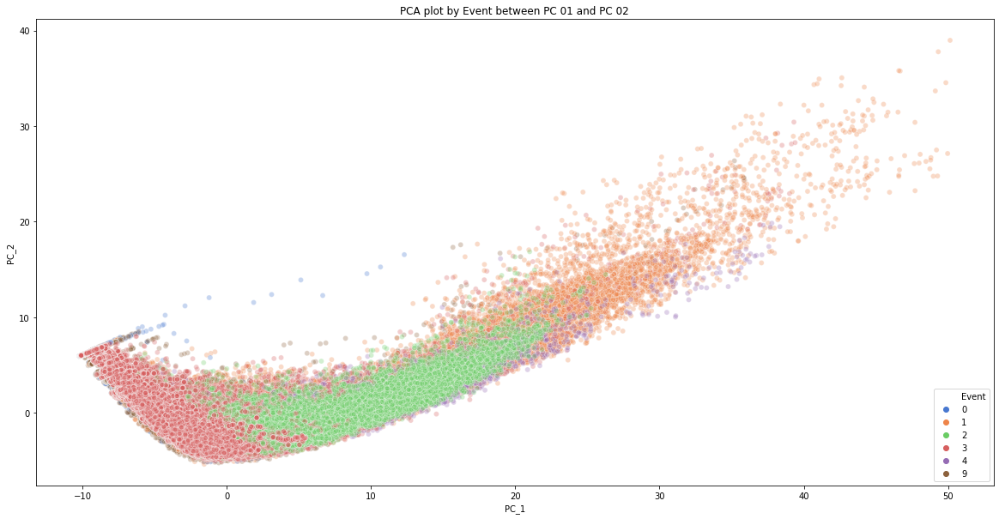

In [ ]:
# PCA plot by Event between PC 01 and PC 02

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (20,10))
sns.scatterplot(x = pcNameList[0], y = pcNameList[1], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 02')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

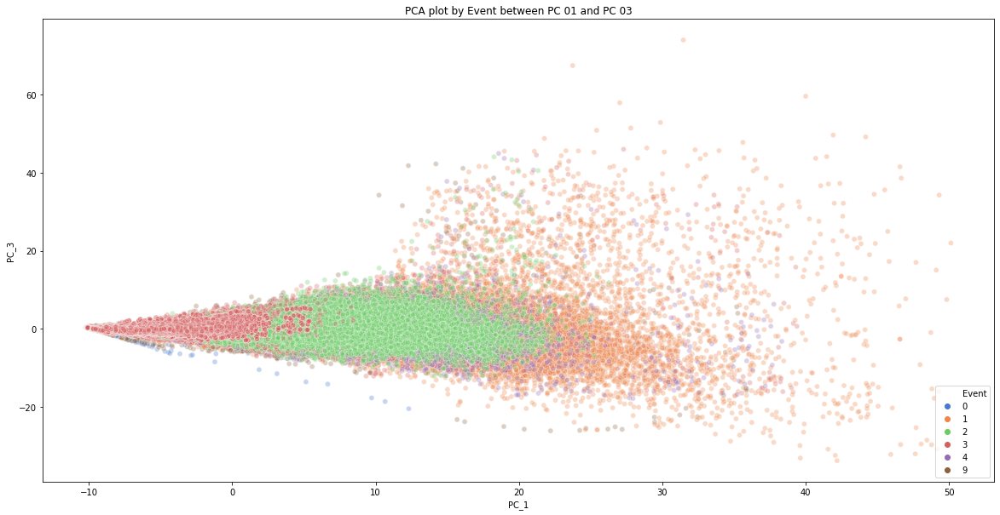

In [ ]:
# PCA plot by Event between PC 01 and PC 03

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (20,10))
sns.scatterplot(x = pcNameList[0], y = pcNameList[2], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 03')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Analysis

Now we will be attempting different methods to tease out suspected pothole events. Due to the memory limitations on Google Colab (25GB), it is best to load each section block by block, and delete any unused variables, else the script will crash and you'll have to start over. Hence the multiple breakpoints.

## Thresholding of PC Eigenvectors I (More Aggressive)
Thresholding of Principal Components to Separate Pothole Events

### Determine Threshold values of Principal Components

In [ ]:
# Define global thresholhold points
pcCutoff = 0.002
pcCutoff_Normal = 1 - pcCutoff
pcCutoff_TopTail = 1 - (pcCutoff / 2)
pcCutoff_LowTail = (pcCutoff / 2)

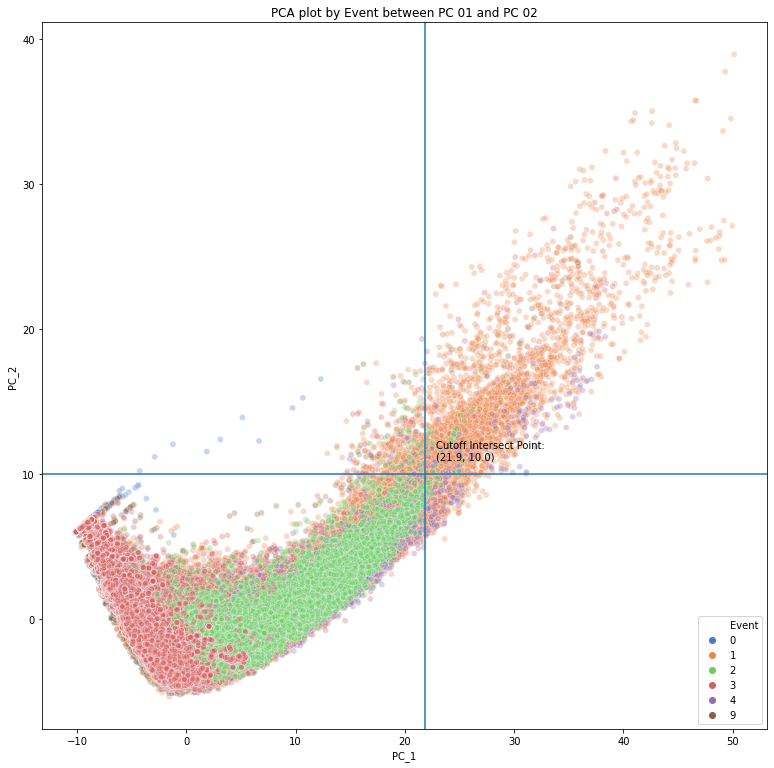

In [ ]:
# PCA plot by Event between PC 01 and PC 02
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[1], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 02')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC01 = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[0]], pcCutoff_Normal) # We will define this once only
cutoff_PC02 = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[1]], pcCutoff_Normal)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC02 + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str(round(cutoff_PC02,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC02,0) # Draw horizontal cutoff point

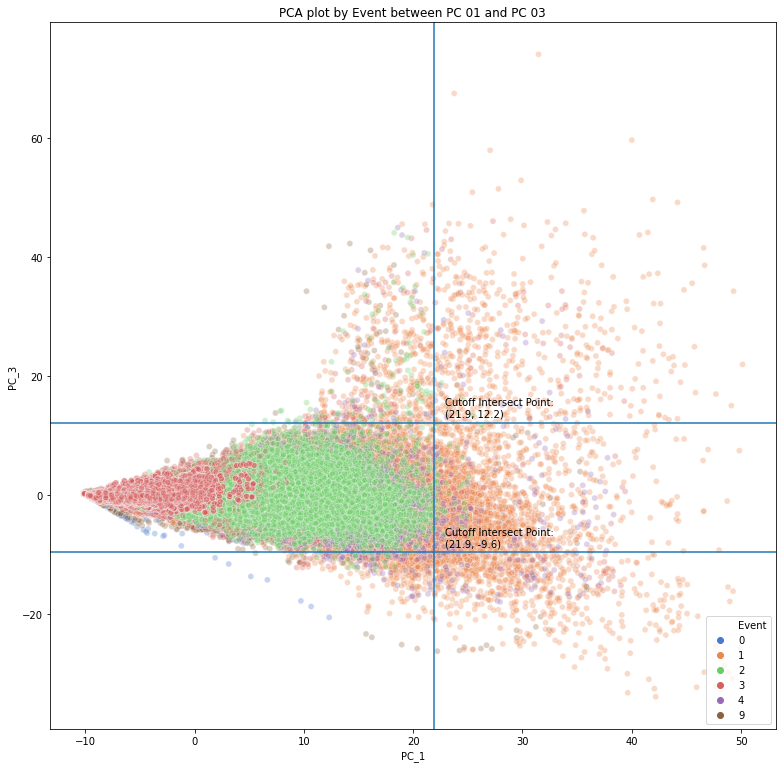

In [ ]:
# PCA plot by Event between PC 01 and PC 03
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[2], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 03')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC03a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[2]], pcCutoff_TopTail)
cutoff_PC03b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[2]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC03a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC03a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC03b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC03b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC03a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC03b,0) # Draw horizontal cutoff point

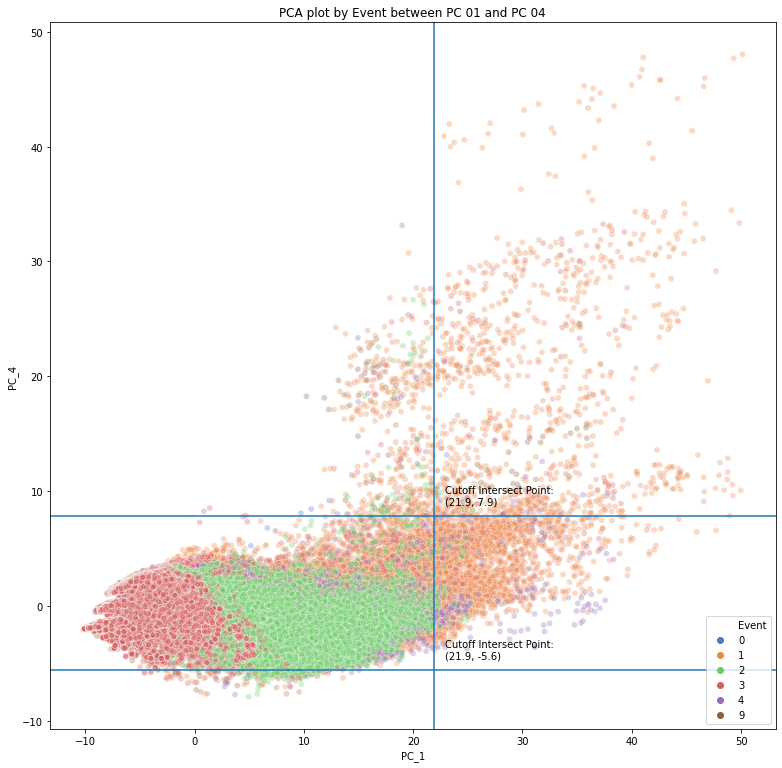

In [ ]:
# PCA plot by Event between PC 01 and PC 04
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[3], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 04')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC04a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[3]], pcCutoff_TopTail)
cutoff_PC04b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[3]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC04a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC04a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC04b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC04b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC04a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC04b,0) # Draw horizontal cutoff point

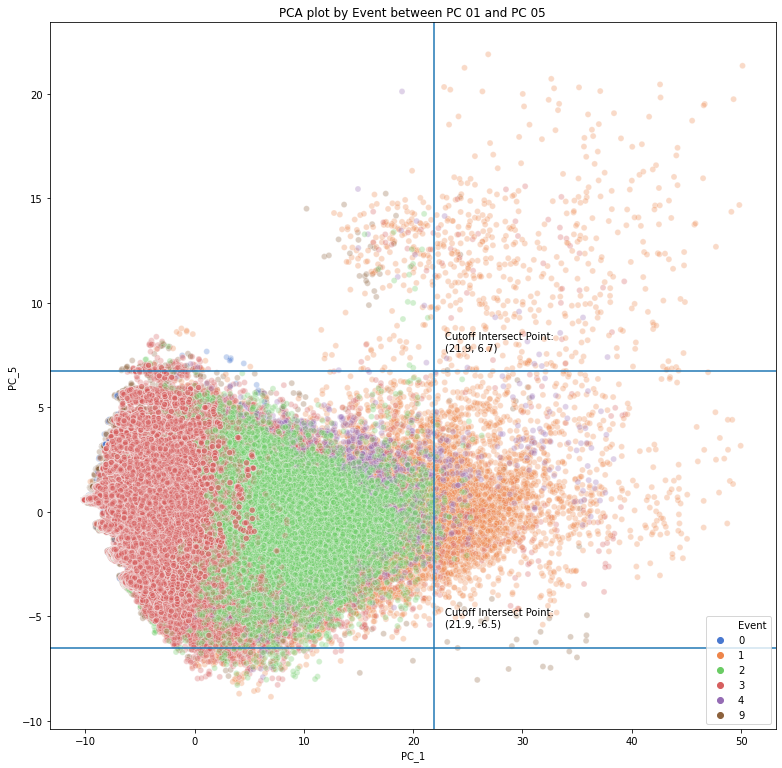

In [ ]:
# PCA plot by Event between PC 01 and PC 05
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[4], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 05')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC05a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[4]], pcCutoff_TopTail)
cutoff_PC05b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[4]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC05a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC05a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC05b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC05b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC05a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC05b,0) # Draw horizontal cutoff point

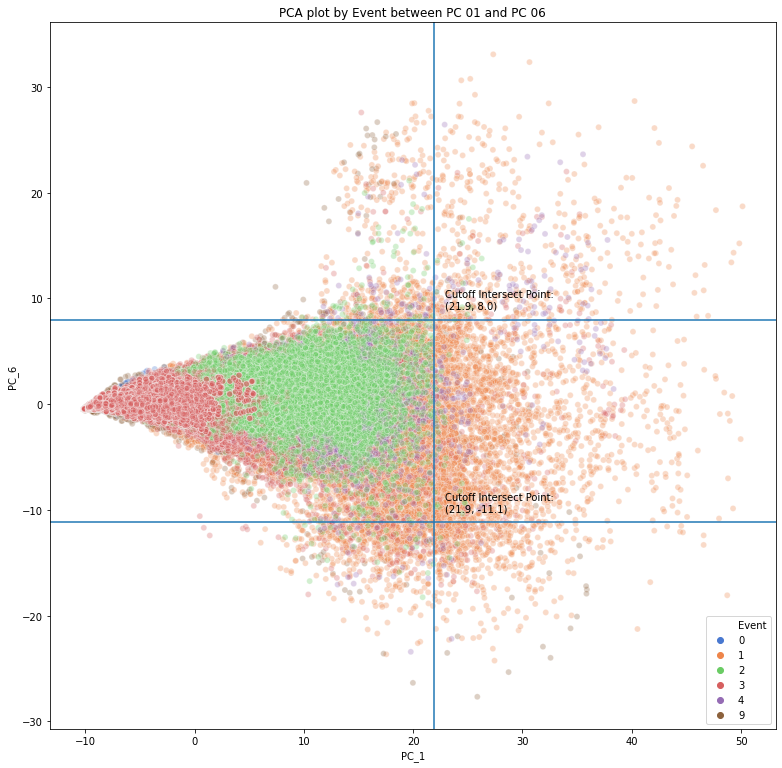

In [ ]:
# PCA plot by Event between PC 01 and PC 06
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[5], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 06')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC06a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[5]], pcCutoff_TopTail)
cutoff_PC06b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[5]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC06a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC06a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC06b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC06b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC06a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC06b,0) # Draw horizontal cutoff point

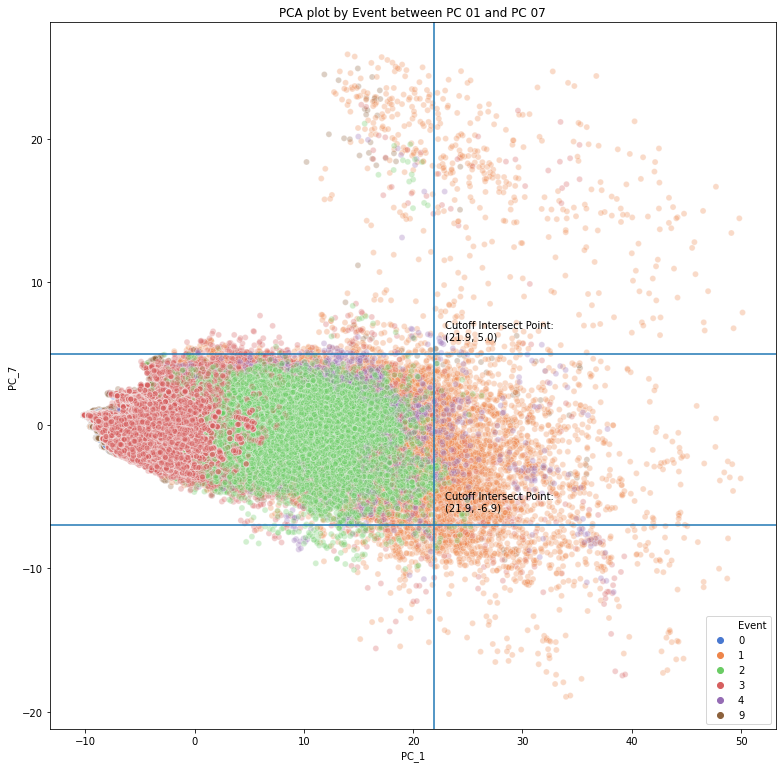

In [ ]:
# PCA plot by Event between PC 01 and PC 07
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[6], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 07')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC07a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[6]], pcCutoff_TopTail)
cutoff_PC07b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[6]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC07a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC07a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC07b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC07b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC07a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC07b,0) # Draw horizontal cutoff point

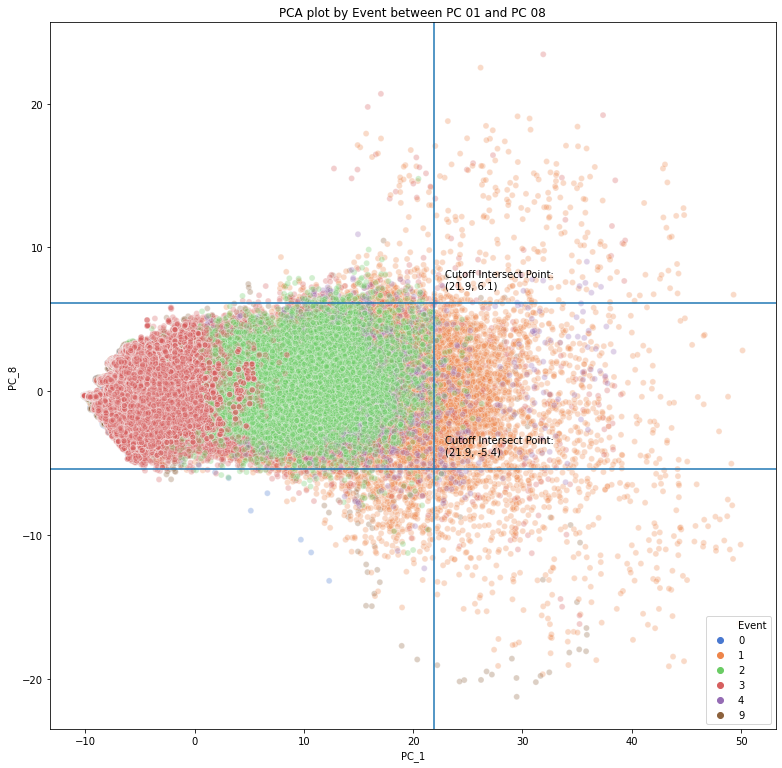

In [ ]:
# PCA plot by Event between PC 01 and PC 08
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[7], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 08')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC08a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[7]], pcCutoff_TopTail)
cutoff_PC08b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[7]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC08a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC08a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC08b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC08b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC08a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC08b,0) # Draw horizontal cutoff point

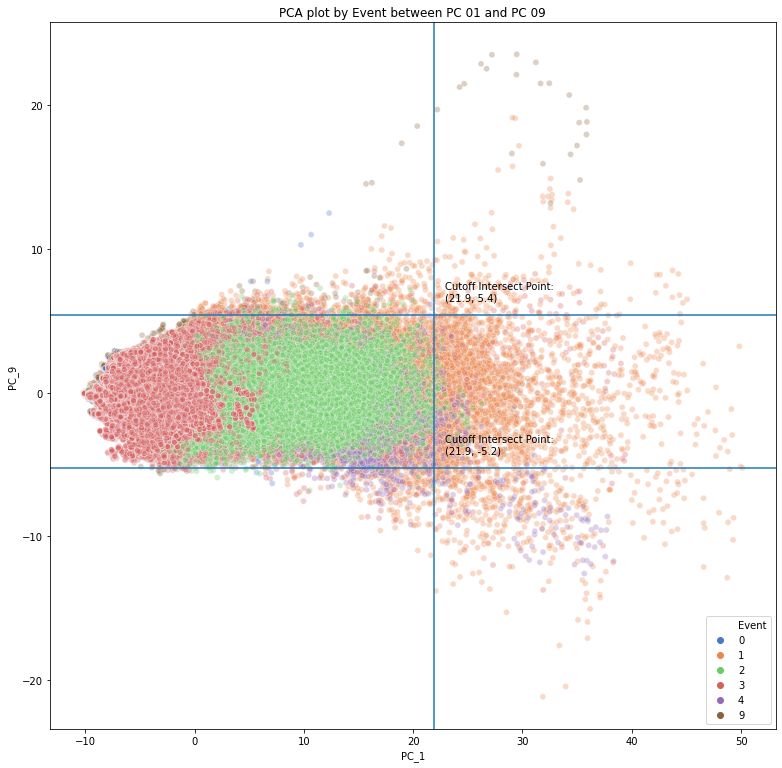

In [ ]:
# PCA plot by Event between PC 01 and PC 09
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[8], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 09')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC09a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[8]], pcCutoff_TopTail)
cutoff_PC09b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[8]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC09a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC09a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC09b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC09b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC09a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC09b,0) # Draw horizontal cutoff point

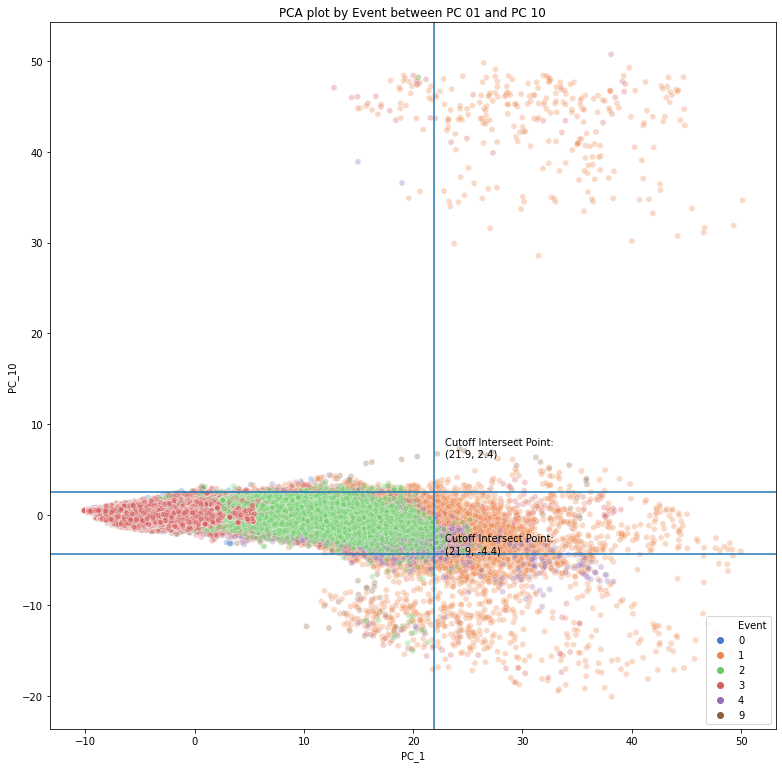

In [ ]:
# PCA plot by Event between PC 01 and PC 10
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[9], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 10')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC10a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[9]], pcCutoff_TopTail)
cutoff_PC10b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[9]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC09a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC10a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC09b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC10b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC10a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC10b,0) # Draw horizontal cutoff point

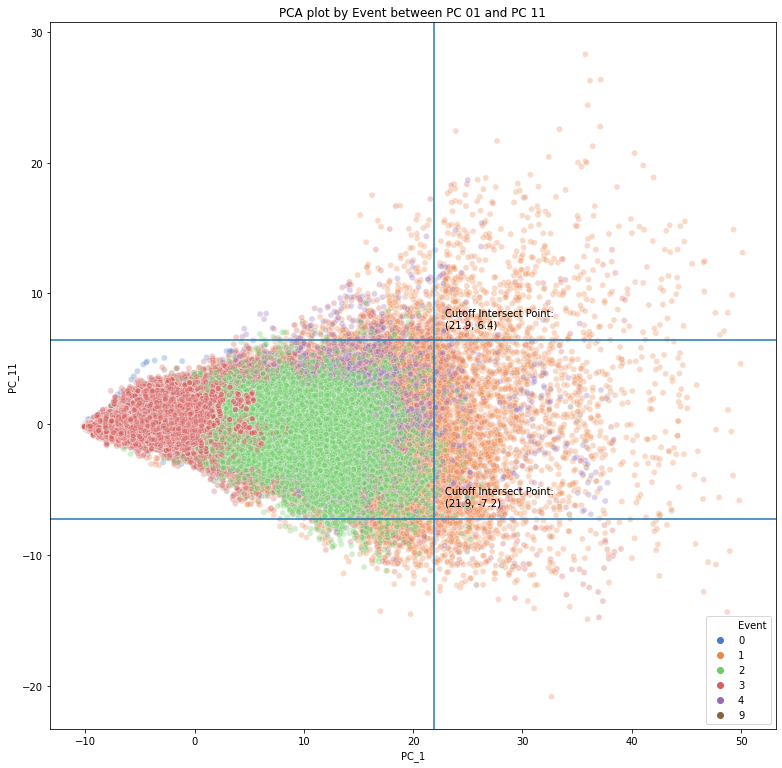

In [ ]:
# PCA plot by Event between PC 01 and PC 11
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[10], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 11')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC11a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[10]], pcCutoff_TopTail)
cutoff_PC11b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[10]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC11a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC11a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC11b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC11b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC11a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC11b,0) # Draw horizontal cutoff point

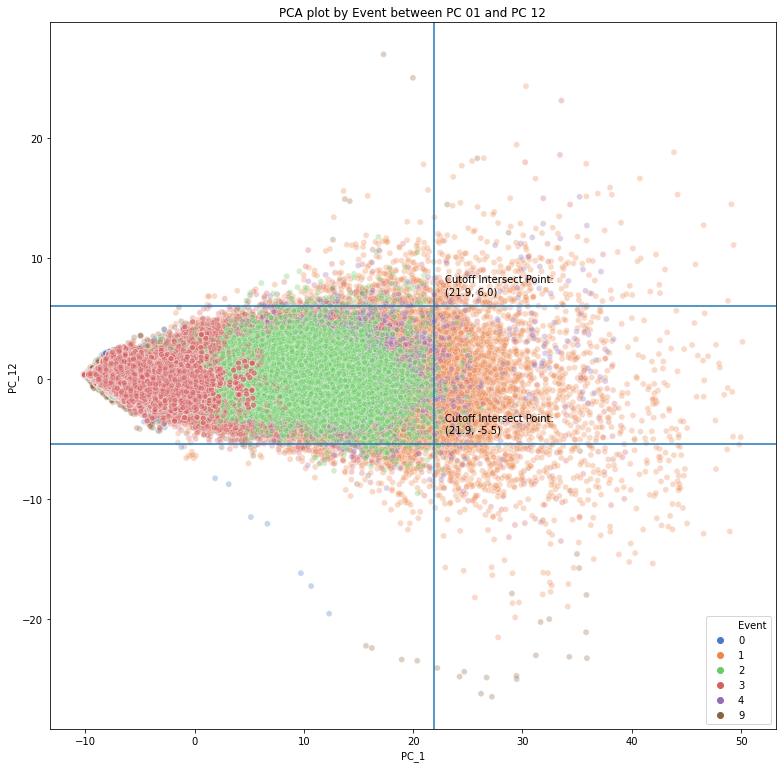

In [ ]:
# PCA plot by Event between PC 01 and PC 12
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[11], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 12')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC12a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[11]], pcCutoff_TopTail)
cutoff_PC12b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[11]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC12a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC12a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC12b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC12b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC12a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC12b,0) # Draw horizontal cutoff point

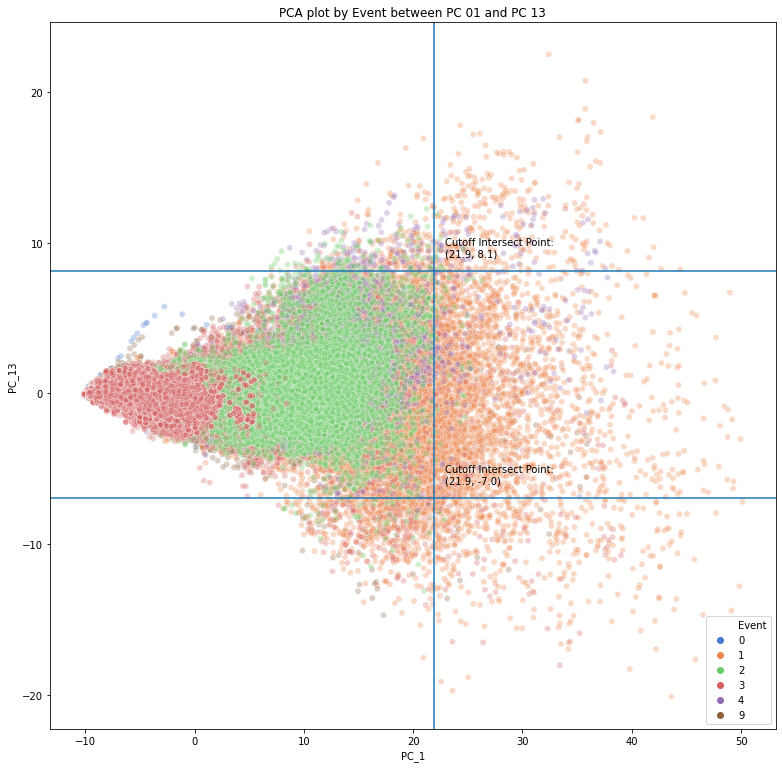

In [ ]:
# PCA plot by Event between PC 01 and PC 13
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[12], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 13')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC13a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[12]], pcCutoff_TopTail)
cutoff_PC13b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[12]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC13a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC13a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC13b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC13b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC13a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC13b,0) # Draw horizontal cutoff point

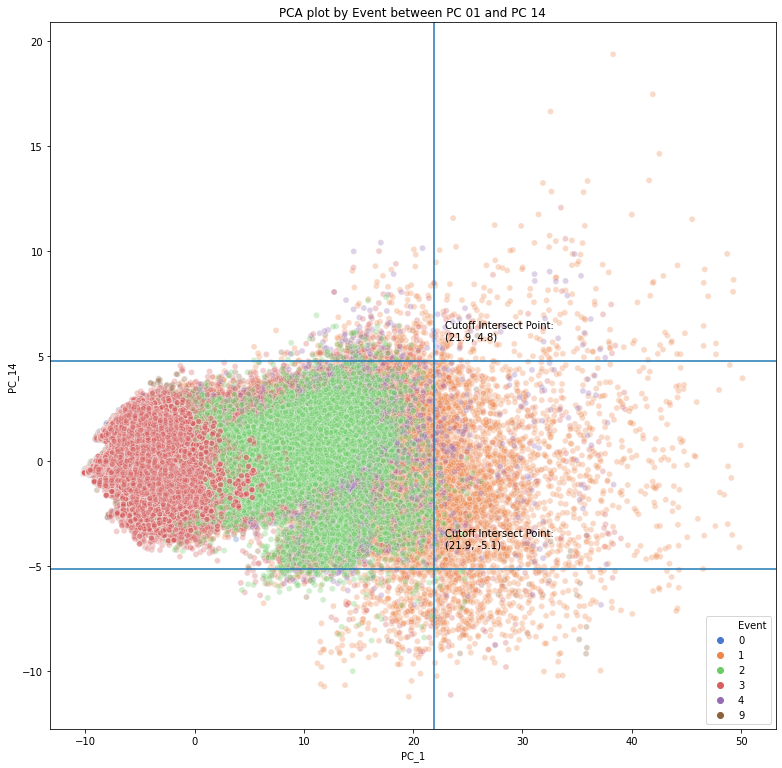

In [ ]:
# PCA plot by Event between PC 01 and PC 14
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[13], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 14')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC14a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[13]], pcCutoff_TopTail)
cutoff_PC14b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[13]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC14a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC14a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC14b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC14b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC14a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC14b,0) # Draw horizontal cutoff point

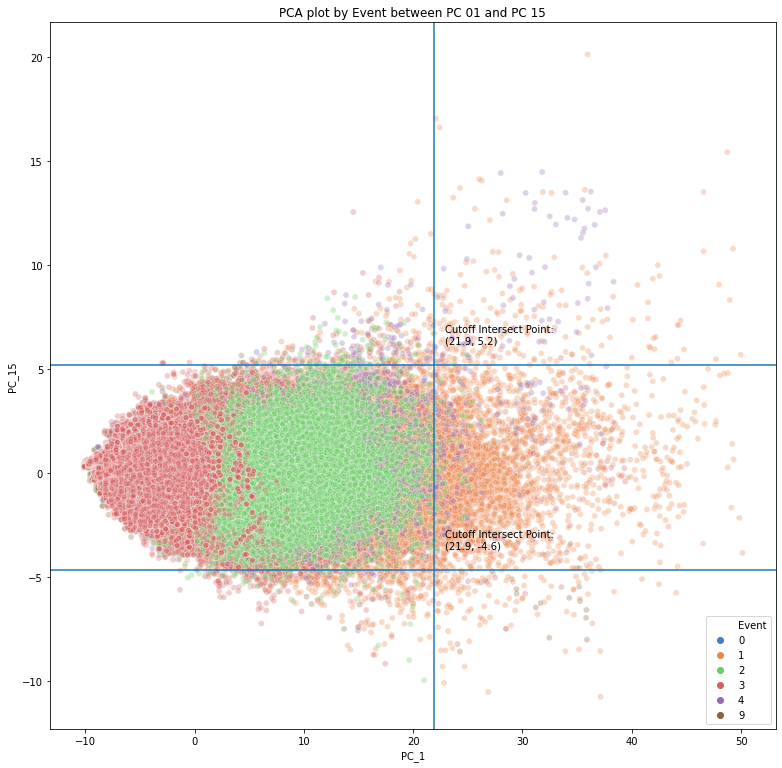

In [ ]:
# PCA plot by Event between PC 01 and PC 15
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[14], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 15')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC15a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[14]], pcCutoff_TopTail)
cutoff_PC15b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[14]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC15a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC15a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC15b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC15b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC15a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC15b,0) # Draw horizontal cutoff point

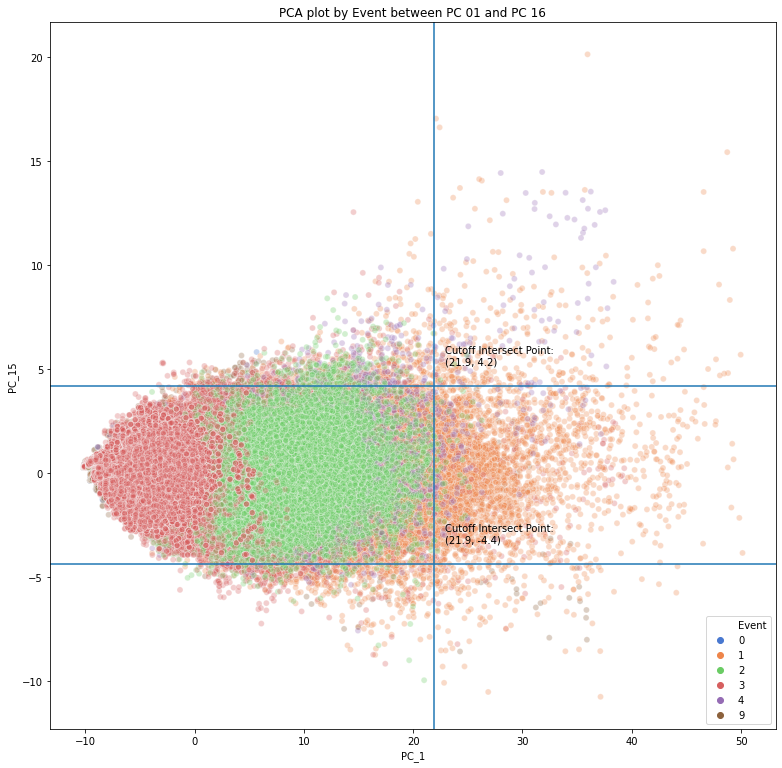

In [ ]:
# PCA plot by Event between PC 01 and PC 16
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[14], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 16')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC16a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[15]], pcCutoff_TopTail)
cutoff_PC16b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[15]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC16a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC16a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC16b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC16b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC16a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC16b,0) # Draw horizontal cutoff point

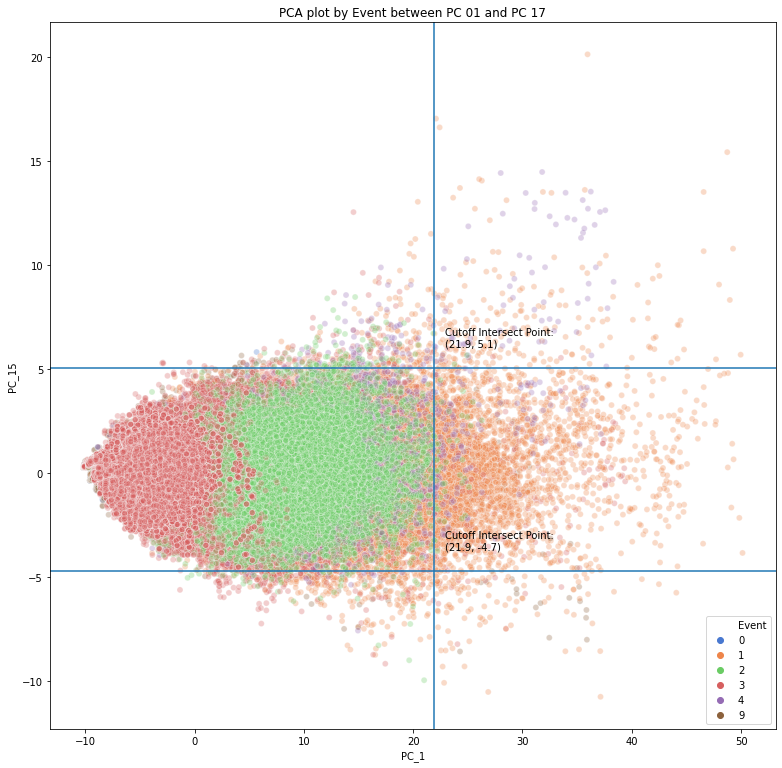

In [ ]:
# PCA plot by Event between PC 01 and PC 17
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[14], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 17')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC17a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[16]], pcCutoff_TopTail)
cutoff_PC17b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[16]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC17a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC17a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC17b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC17b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC17a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC17b,0) # Draw horizontal cutoff point

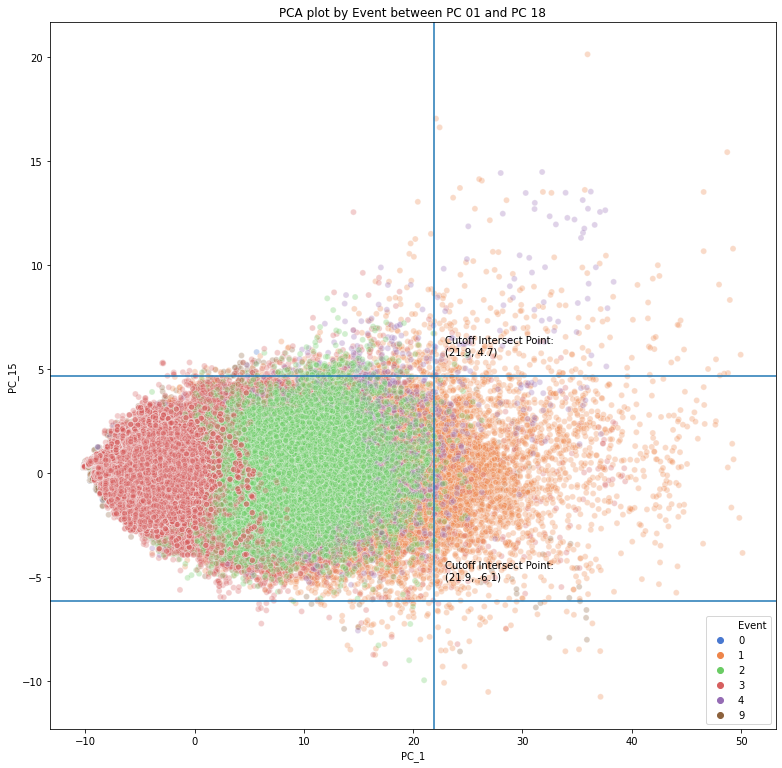

In [ ]:
# PCA plot by Event between PC 01 and PC 18
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[14], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 18')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC18a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[17]], pcCutoff_TopTail)
cutoff_PC18b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[17]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC18a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC18a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC18b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC18b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC18a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC18b,0) # Draw horizontal cutoff point

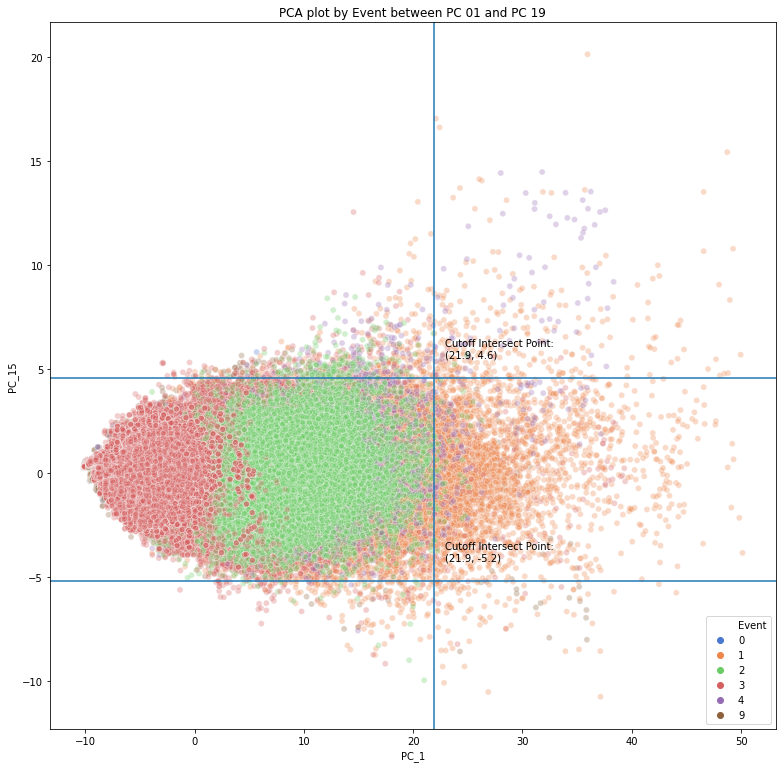

In [ ]:
# PCA plot by Event between PC 01 and PC 19
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[14], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 19')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC19a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[18]], pcCutoff_TopTail)
cutoff_PC19b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[18]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC19a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC19a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC19b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC19b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC19a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC19b,0) # Draw horizontal cutoff point

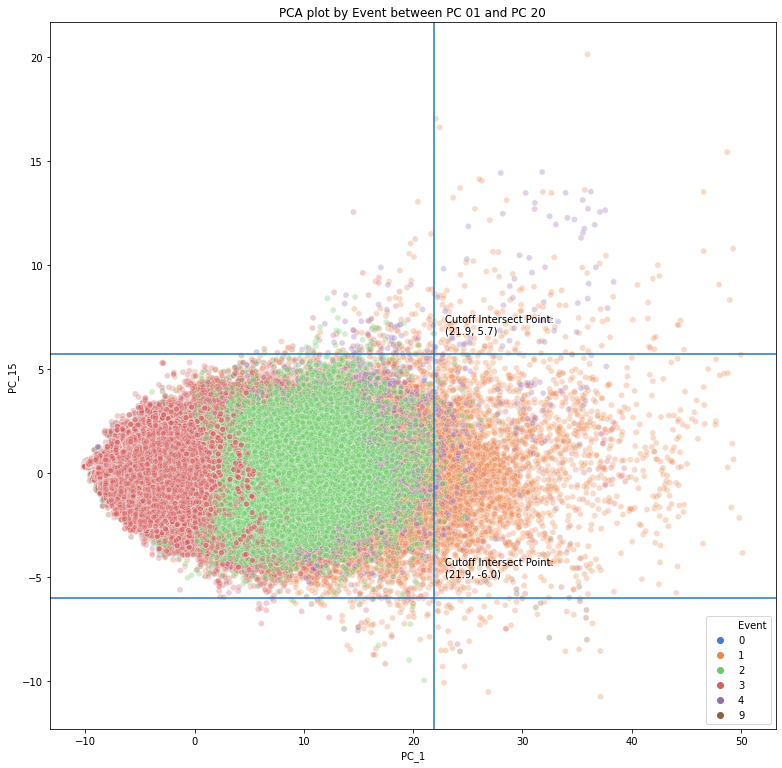

In [ ]:
# PCA plot by Event between PC 01 and PC 20
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[14], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 20')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC20a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[19]], pcCutoff_TopTail)
cutoff_PC20b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[19]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC20a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC20a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC20b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC20b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC20a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC20b,0) # Draw horizontal cutoff point

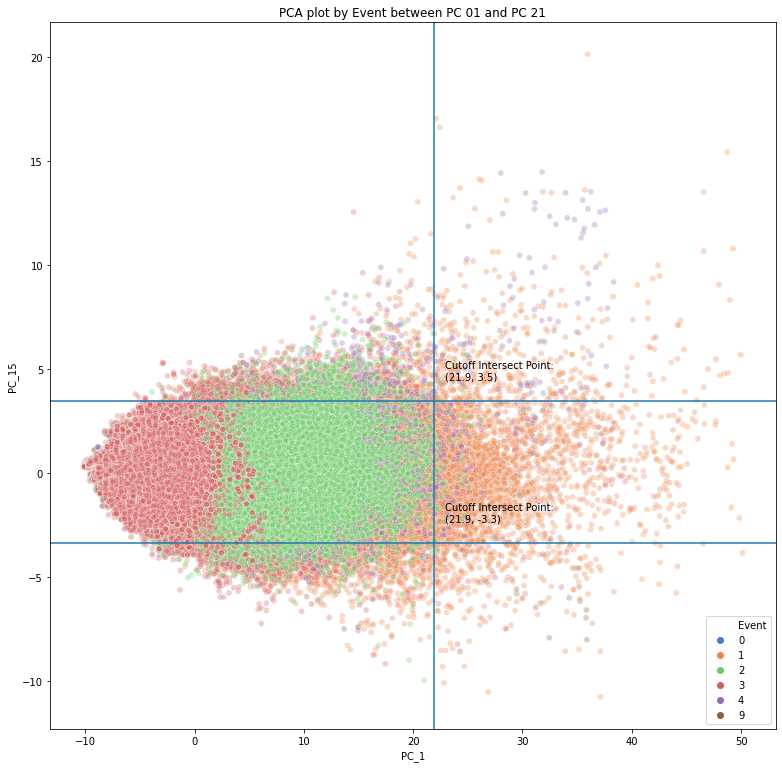

In [ ]:
# PCA plot by Event between PC 01 and PC 21
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[14], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 21')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC21a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[20]], pcCutoff_TopTail)
cutoff_PC21b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[20]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC21a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC21a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC21b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC21b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC21a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC21b,0) # Draw horizontal cutoff point

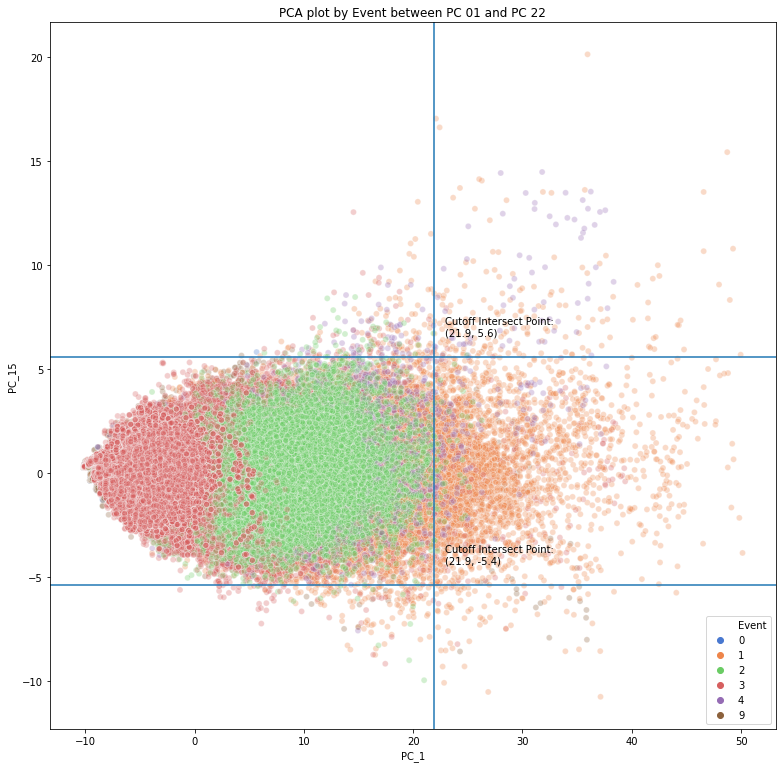

In [ ]:
# PCA plot by Event between PC 01 and PC 22
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[14], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 22')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC22a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[21]], pcCutoff_TopTail)
cutoff_PC22b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[21]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC22a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC22a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC22b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC22b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC22a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC22b,0) # Draw horizontal cutoff point

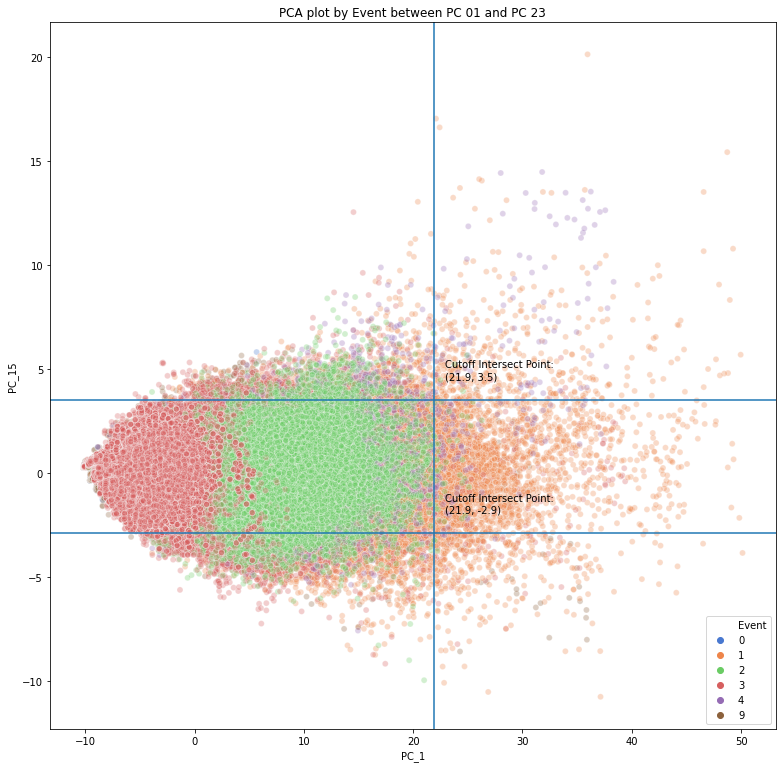

In [ ]:
# PCA plot by Event between PC 01 and PC 23
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[14], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 23')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC23a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[22]], pcCutoff_TopTail)
cutoff_PC23b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[22]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC23a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC23a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC23b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC23b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC23a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC23b,0) # Draw horizontal cutoff point

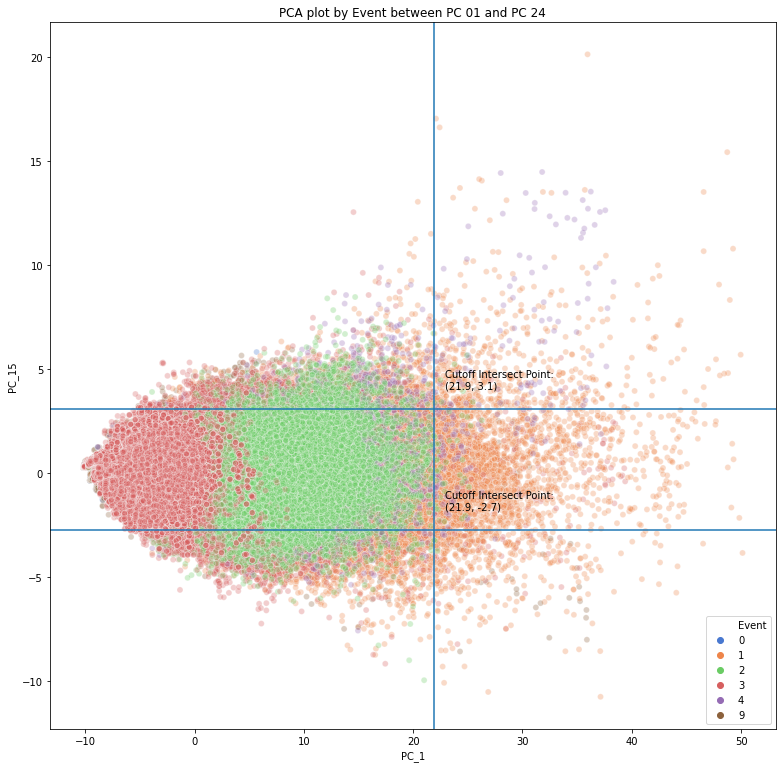

In [ ]:
# PCA plot by Event between PC 01 and PC 24
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[14], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 24')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC24a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[23]], pcCutoff_TopTail)
cutoff_PC24b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[23]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC24a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC24a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC24b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC24b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC24a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC24b,0) # Draw horizontal cutoff point

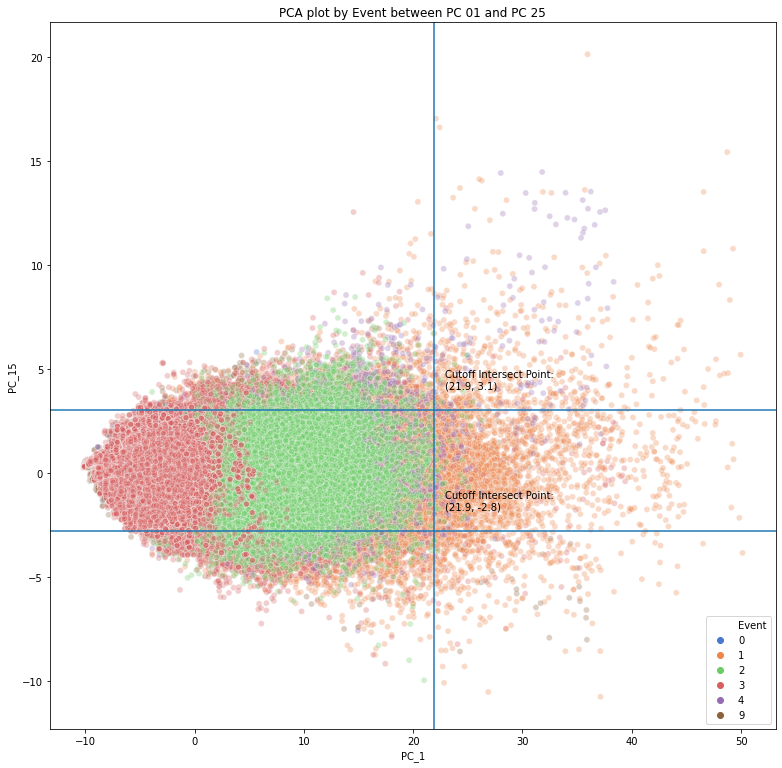

In [ ]:
# PCA plot by Event between PC 01 and PC 25
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[14], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 25')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC25a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[24]], pcCutoff_TopTail)
cutoff_PC25b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[24]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC25a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC25a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC25b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC25b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC25a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC25b,0) # Draw horizontal cutoff point

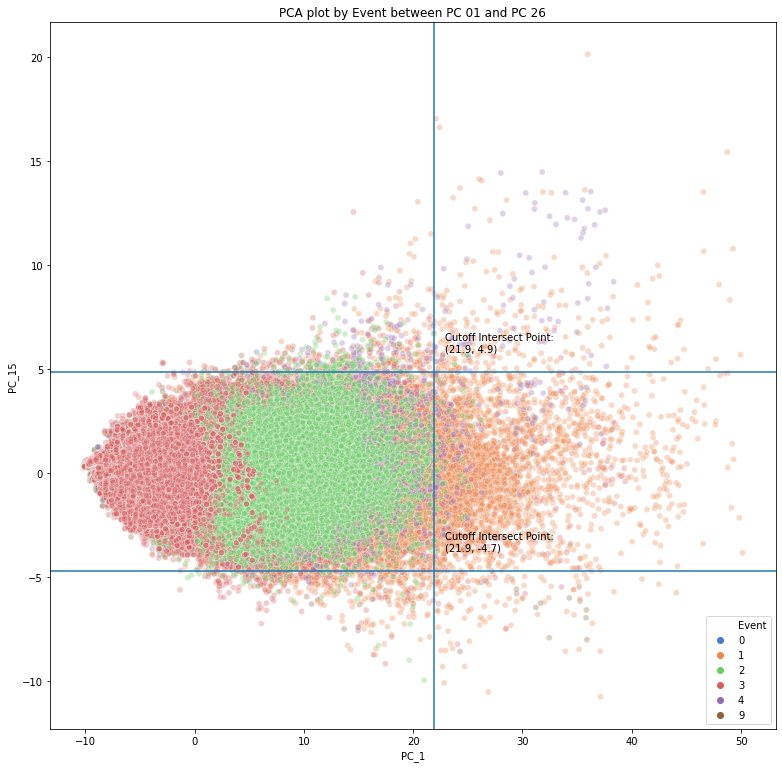

In [ ]:
# PCA plot by Event between PC 01 and PC 26
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[14], data = df3, hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 26')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define cutoff points
cutoff_PC26a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[25]], pcCutoff_TopTail)
cutoff_PC26b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[25]], pcCutoff_LowTail)

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 1, cutoff_PC26a + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC26a,1)) + ")"))
plt.text(cutoff_PC01 + 1, cutoff_PC26b + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC26b,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC26a,0) # Draw horizontal cutoff point
plt.axhline(cutoff_PC26b,0) # Draw horizontal cutoff point

### Perform thresholding

A weighted threshold is performed to determine whether an observation is a pothole or not. The weights are determined by the explained variance of each PC generated during the PCA step. The closer the value is to 1, the more likely that the observation is a pothole.

In [ ]:
# List of PC thresholds
pcThresholdList = [cutoff_PC01, cutoff_PC02,
                   cutoff_PC03a, cutoff_PC03b, 
                   cutoff_PC04a, cutoff_PC04b, 
                   cutoff_PC05a, cutoff_PC05b, 
                   cutoff_PC06a, cutoff_PC06b,
                   cutoff_PC07a, cutoff_PC07b,
                   cutoff_PC08a, cutoff_PC08b,
                   cutoff_PC09a, cutoff_PC09b,
                   cutoff_PC10a, cutoff_PC10b,
                   cutoff_PC11a, cutoff_PC11b,
                   cutoff_PC12a, cutoff_PC12b,
                   cutoff_PC13a, cutoff_PC13b,
                   cutoff_PC14a, cutoff_PC14b,
                   cutoff_PC15a, cutoff_PC15b,
                   cutoff_PC16a, cutoff_PC16b,
                   cutoff_PC17a, cutoff_PC17b,
                   cutoff_PC18a, cutoff_PC18b,
                   cutoff_PC19a, cutoff_PC19b,
                   cutoff_PC20a, cutoff_PC20b,
                   cutoff_PC21a, cutoff_PC21b,
                   cutoff_PC22a, cutoff_PC22b,
                   cutoff_PC23a, cutoff_PC23b,
                   cutoff_PC24a, cutoff_PC24b,
                   cutoff_PC25a, cutoff_PC25b,
                   cutoff_PC26a, cutoff_PC26b
                   ]

# inspect list
pcThresholdList[0:5]

[21.893745318386742,
 10.007793701455345,
 12.185205294077658,
 -9.584301871311515,
 7.8519806399086]

In [ ]:
# inspect list
len(pcThresholdList)

50

In [ ]:
# Define thresholding code
df3["probThres_pc"] = (
((df3[pcNameList[0]] >= pcThresholdList[0]) * 1) * pca.explained_variance_ratio_[0] + 
((df3[pcNameList[1]] >= pcThresholdList[1]) * 1) * pca.explained_variance_ratio_[1] + 
((df3[pcNameList[2]] >= pcThresholdList[2]) * 1) * pca.explained_variance_ratio_[2] + 
((df3[pcNameList[2]] <= pcThresholdList[3]) * 1) * pca.explained_variance_ratio_[2] + 
((df3[pcNameList[3]] >= pcThresholdList[4]) * 1) * pca.explained_variance_ratio_[3] + 
((df3[pcNameList[3]] <= pcThresholdList[5]) * 1) * pca.explained_variance_ratio_[3] + 
((df3[pcNameList[4]] >= pcThresholdList[6]) * 1) * pca.explained_variance_ratio_[4] + 
((df3[pcNameList[4]] <= pcThresholdList[7]) * 1) * pca.explained_variance_ratio_[4] + 
((df3[pcNameList[5]] >= pcThresholdList[8]) * 1) * pca.explained_variance_ratio_[5] + 
((df3[pcNameList[5]] <= pcThresholdList[9]) * 1) * pca.explained_variance_ratio_[5] +

((df3[pcNameList[6]] >= pcThresholdList[10]) * 1) * pca.explained_variance_ratio_[6] + 
((df3[pcNameList[6]] <= pcThresholdList[11]) * 1) * pca.explained_variance_ratio_[6] + 
((df3[pcNameList[7]] >= pcThresholdList[12]) * 1) * pca.explained_variance_ratio_[7] + 
((df3[pcNameList[7]] <= pcThresholdList[13]) * 1) * pca.explained_variance_ratio_[7] + 
((df3[pcNameList[8]] >= pcThresholdList[14]) * 1) * pca.explained_variance_ratio_[8] + 
((df3[pcNameList[8]] <= pcThresholdList[15]) * 1) * pca.explained_variance_ratio_[8] + 
((df3[pcNameList[9]] >= pcThresholdList[16]) * 1) * pca.explained_variance_ratio_[9] + 
((df3[pcNameList[9]] <= pcThresholdList[17]) * 1) * pca.explained_variance_ratio_[9] + 
((df3[pcNameList[10]] >= pcThresholdList[18]) * 1) * pca.explained_variance_ratio_[10] + 
((df3[pcNameList[10]] <= pcThresholdList[19]) * 1) * pca.explained_variance_ratio_[10] + 

((df3[pcNameList[11]] >= pcThresholdList[20]) * 1) * pca.explained_variance_ratio_[11] + 
((df3[pcNameList[11]] <= pcThresholdList[21]) * 1) * pca.explained_variance_ratio_[11] + 
((df3[pcNameList[12]] >= pcThresholdList[22]) * 1) * pca.explained_variance_ratio_[12] + 
((df3[pcNameList[12]] <= pcThresholdList[23]) * 1) * pca.explained_variance_ratio_[12] + 
((df3[pcNameList[13]] >= pcThresholdList[24]) * 1) * pca.explained_variance_ratio_[13] + 
((df3[pcNameList[13]] <= pcThresholdList[25]) * 1) * pca.explained_variance_ratio_[13] + 
((df3[pcNameList[14]] >= pcThresholdList[26]) * 1) * pca.explained_variance_ratio_[14] + 
((df3[pcNameList[14]] <= pcThresholdList[27]) * 1) * pca.explained_variance_ratio_[14] + 
((df3[pcNameList[15]] >= pcThresholdList[28]) * 1) * pca.explained_variance_ratio_[15] + 
((df3[pcNameList[15]] <= pcThresholdList[29]) * 1) * pca.explained_variance_ratio_[15] +

((df3[pcNameList[16]] >= pcThresholdList[30]) * 1) * pca.explained_variance_ratio_[16] + 
((df3[pcNameList[16]] <= pcThresholdList[31]) * 1) * pca.explained_variance_ratio_[16] +
((df3[pcNameList[17]] >= pcThresholdList[32]) * 1) * pca.explained_variance_ratio_[17] + 
((df3[pcNameList[17]] <= pcThresholdList[33]) * 1) * pca.explained_variance_ratio_[17] +
((df3[pcNameList[18]] >= pcThresholdList[34]) * 1) * pca.explained_variance_ratio_[18] + 
((df3[pcNameList[18]] <= pcThresholdList[35]) * 1) * pca.explained_variance_ratio_[18] +
((df3[pcNameList[19]] >= pcThresholdList[36]) * 1) * pca.explained_variance_ratio_[19] + 
((df3[pcNameList[19]] <= pcThresholdList[37]) * 1) * pca.explained_variance_ratio_[19] +
((df3[pcNameList[20]] >= pcThresholdList[38]) * 1) * pca.explained_variance_ratio_[20] + 
((df3[pcNameList[20]] <= pcThresholdList[39]) * 1) * pca.explained_variance_ratio_[20] +

((df3[pcNameList[21]] >= pcThresholdList[40]) * 1) * pca.explained_variance_ratio_[21] + 
((df3[pcNameList[21]] <= pcThresholdList[41]) * 1) * pca.explained_variance_ratio_[21] +
((df3[pcNameList[22]] >= pcThresholdList[42]) * 1) * pca.explained_variance_ratio_[22] + 
((df3[pcNameList[22]] <= pcThresholdList[43]) * 1) * pca.explained_variance_ratio_[22] +
((df3[pcNameList[23]] >= pcThresholdList[44]) * 1) * pca.explained_variance_ratio_[23] + 
((df3[pcNameList[23]] <= pcThresholdList[45]) * 1) * pca.explained_variance_ratio_[23] +
((df3[pcNameList[24]] >= pcThresholdList[46]) * 1) * pca.explained_variance_ratio_[24] + 
((df3[pcNameList[24]] <= pcThresholdList[47]) * 1) * pca.explained_variance_ratio_[24] +
((df3[pcNameList[25]] >= pcThresholdList[48]) * 1) * pca.explained_variance_ratio_[25] + 
((df3[pcNameList[25]] <= pcThresholdList[49]) * 1) * pca.explained_variance_ratio_[25]
)

# Inspect results
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0.0,0.0,5.0,0.0,0.0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0.0,0.0,5.0,0.0,1.0,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0.0,0.0,5.0,0.0,2.0,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0.0,0.0,5.0,0.0,3.0,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0.0,0.0,5.0,0.0,4.0,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0


In [ ]:
# Check if probabilities are calculated properly
max(df3["probThres_pc"])

0.8701249180638301

### Find optimum probability from thresholding

Aim to reduce the amount of contamination from other event types in the plots. Based on our test splots, a threshold of around 0.73 to 0.75 would be sufficient to make a good guess of the existence of potholes. Do note that since there are less event types in the filtered data, the colour codes may have changed.

In [ ]:
# Set Threshold probability values
pcSumThresholdProb = sum(pca.explained_variance_ratio_[0:9]).round(3)
meetsThresholdProb1 =  df3['probThres_pc'] >= pcSumThresholdProb
meetsThresholdProb2 =  df3['probThres_pc'] >= 0.8

# Inspect variable
pcSumThresholdProb

0.714

In [ ]:
# Get Count of observations that meets threshold
print(df3[meetsThresholdProb1].shape[0])
print(df3[meetsThresholdProb2].shape[0])

488
71


In [ ]:
# Get % count of potential contamination from non-tagged pothole events that met threshold
nonTaggedPH1 = (df3["Event"] != 1) & (meetsThresholdProb1)
nonTaggedPH2 = (df3["Event"] != 1) & (meetsThresholdProb2)
print(round(((df3[nonTaggedPH1].shape[0] / df3[meetsThresholdProb1].shape[0]) * 100), 3))
print(round(((df3[nonTaggedPH2].shape[0] / df3[meetsThresholdProb2].shape[0]) * 100), 3))

11.27
14.085


In [ ]:
# Get a % Count of observations that met threshold
print(round(((df3[meetsThresholdProb1].shape[0] / df3.shape[0]) * 100), 3))
print(round(((df3[meetsThresholdProb2].shape[0] / df3.shape[0]) * 100), 3))

0.143
0.021


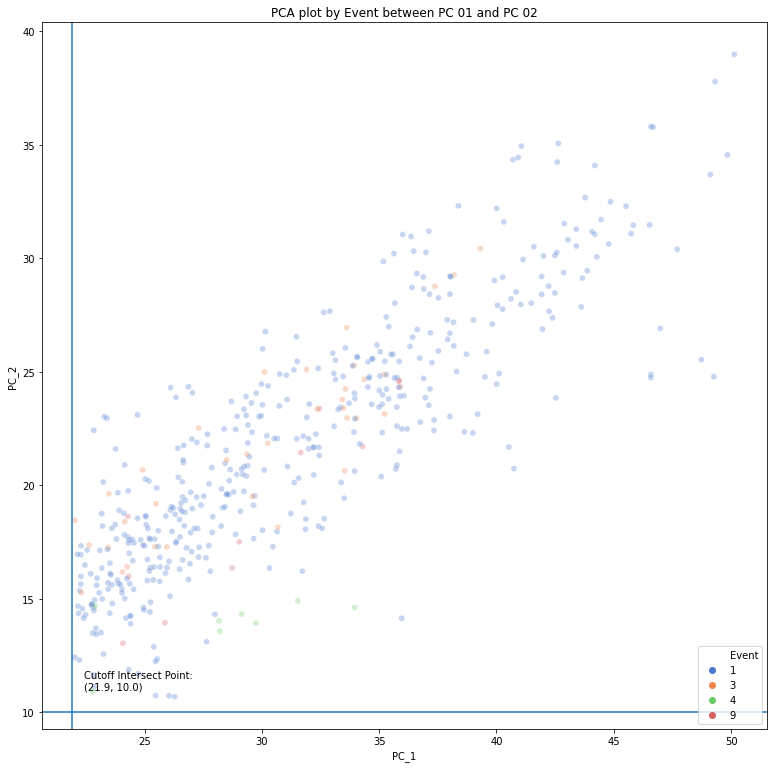

In [ ]:
# PCA plot by Event between PC 01 and PC 02
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[1], data = df3[meetsThresholdProb1], hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 02')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 0.5, cutoff_PC02 + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC02,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC02,0) # Draw horizontal cutoff point

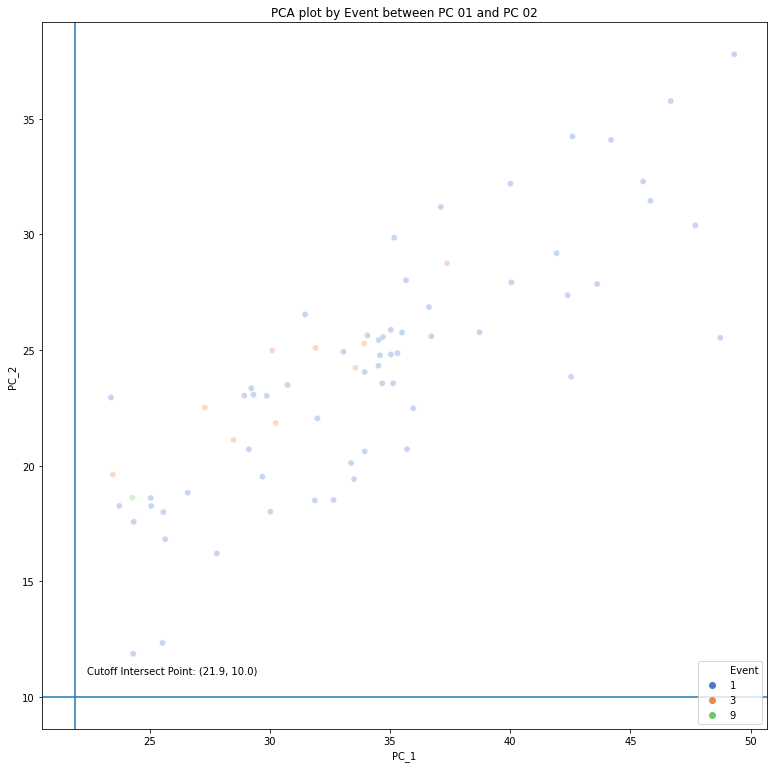

In [ ]:
# PCA plot by Event between PC 01 and PC 02
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[1], data = df3[meetsThresholdProb2], hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 02')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 0.5, cutoff_PC02 + 1, ("Cutoff Intersect Point: (" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC02,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC02,0) # Draw horizontal cutoff point

## Thresholding of PC Eigenvectors II (Less Aggressive)

Thresholding of Principal Components to Separate Pothole Events. Less aggressive thresholds used to filter eigenvectors of principal components.


### Set Parameters

In [ ]:
# Define global thresholhold points
pcCutoff = 0.01
pcCutoff_Normal = 1 - pcCutoff
pcCutoff_TopTail = 1 - (pcCutoff / 2)
pcCutoff_LowTail = (pcCutoff / 2)

In [ ]:
# Define cutoff points

cutoff_PC01 = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[0]], pcCutoff_Normal)
cutoff_PC02 = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[1]], pcCutoff_Normal)
cutoff_PC03a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[2]], pcCutoff_TopTail)
cutoff_PC03b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[2]], pcCutoff_LowTail)
cutoff_PC04a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[3]], pcCutoff_TopTail)
cutoff_PC04b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[3]], pcCutoff_LowTail)
cutoff_PC05a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[4]], pcCutoff_TopTail)
cutoff_PC05b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[4]], pcCutoff_LowTail)

cutoff_PC06a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[5]], pcCutoff_TopTail)
cutoff_PC06b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[5]], pcCutoff_LowTail)
cutoff_PC07a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[6]], pcCutoff_TopTail)
cutoff_PC07b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[6]], pcCutoff_LowTail)
cutoff_PC08a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[7]], pcCutoff_TopTail)
cutoff_PC08b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[7]], pcCutoff_LowTail)
cutoff_PC09a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[8]], pcCutoff_TopTail)
cutoff_PC09b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[8]], pcCutoff_LowTail)
cutoff_PC10a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[9]], pcCutoff_TopTail)
cutoff_PC10b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[9]], pcCutoff_LowTail)

cutoff_PC11a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[10]], pcCutoff_TopTail)
cutoff_PC11b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[10]], pcCutoff_LowTail)
cutoff_PC12a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[11]], pcCutoff_TopTail)
cutoff_PC12b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[11]], pcCutoff_LowTail)
cutoff_PC13a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[12]], pcCutoff_TopTail)
cutoff_PC13b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[12]], pcCutoff_LowTail)
cutoff_PC14a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[13]], pcCutoff_TopTail)
cutoff_PC14b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[13]], pcCutoff_LowTail)
cutoff_PC15a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[14]], pcCutoff_TopTail)
cutoff_PC15b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[14]], pcCutoff_LowTail)

cutoff_PC16a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[15]], pcCutoff_TopTail)
cutoff_PC16b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[15]], pcCutoff_LowTail)
cutoff_PC17a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[16]], pcCutoff_TopTail)
cutoff_PC17b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[16]], pcCutoff_LowTail)
cutoff_PC18a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[17]], pcCutoff_TopTail)
cutoff_PC18b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[17]], pcCutoff_LowTail)
cutoff_PC19a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[18]], pcCutoff_TopTail)
cutoff_PC19b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[18]], pcCutoff_LowTail)
cutoff_PC20a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[19]], pcCutoff_TopTail)
cutoff_PC20b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[19]], pcCutoff_LowTail)

cutoff_PC21a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[20]], pcCutoff_TopTail)
cutoff_PC21b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[20]], pcCutoff_LowTail)
cutoff_PC22a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[21]], pcCutoff_TopTail)
cutoff_PC22b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[21]], pcCutoff_LowTail)
cutoff_PC23a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[22]], pcCutoff_TopTail)
cutoff_PC23b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[22]], pcCutoff_LowTail)
cutoff_PC24a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[23]], pcCutoff_TopTail)
cutoff_PC24b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[23]], pcCutoff_LowTail)
cutoff_PC25a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[24]], pcCutoff_TopTail)
cutoff_PC25b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[24]], pcCutoff_LowTail)

cutoff_PC26a = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[25]], pcCutoff_TopTail)
cutoff_PC26b = np.quantile(df3.loc[df3["Event"] != 1][pcNameList[25]], pcCutoff_LowTail)



In [ ]:
# List of PC thresholds
pcThresholdList = [cutoff_PC01, cutoff_PC02,
                   cutoff_PC03a, cutoff_PC03b, 
                   cutoff_PC04a, cutoff_PC04b, 
                   cutoff_PC05a, cutoff_PC05b, 
                   cutoff_PC06a, cutoff_PC06b,
                   cutoff_PC07a, cutoff_PC07b,
                   cutoff_PC08a, cutoff_PC08b,
                   cutoff_PC09a, cutoff_PC09b,
                   cutoff_PC10a, cutoff_PC10b,
                   cutoff_PC11a, cutoff_PC11b,
                   cutoff_PC12a, cutoff_PC12b,
                   cutoff_PC13a, cutoff_PC13b,
                   cutoff_PC14a, cutoff_PC14b,
                   cutoff_PC15a, cutoff_PC15b,
                   cutoff_PC16a, cutoff_PC16b,
                   cutoff_PC17a, cutoff_PC17b,
                   cutoff_PC18a, cutoff_PC18b,
                   cutoff_PC19a, cutoff_PC19b,
                   cutoff_PC20a, cutoff_PC20b,
                   cutoff_PC21a, cutoff_PC21b,
                   cutoff_PC22a, cutoff_PC22b,
                   cutoff_PC23a, cutoff_PC23b,
                   cutoff_PC24a, cutoff_PC24b,
                   cutoff_PC25a, cutoff_PC25b,
                   cutoff_PC26a, cutoff_PC26b
                   ]

# inspect list
pcThresholdList[0:5]

[16.11200828436086,
 6.254386711024861,
 6.740741986602696,
 -6.279094450471785,
 3.315963206499794]

In [ ]:
# Define thresholding code
df3["probThres_pc2"] = (
((df3[pcNameList[0]] >= pcThresholdList[0]) * 1) * pca.explained_variance_ratio_[0] + 
((df3[pcNameList[1]] >= pcThresholdList[1]) * 1) * pca.explained_variance_ratio_[1] + 
((df3[pcNameList[2]] >= pcThresholdList[2]) * 1) * pca.explained_variance_ratio_[2] + 
((df3[pcNameList[2]] <= pcThresholdList[3]) * 1) * pca.explained_variance_ratio_[2] + 
((df3[pcNameList[3]] >= pcThresholdList[4]) * 1) * pca.explained_variance_ratio_[3] + 
((df3[pcNameList[3]] <= pcThresholdList[5]) * 1) * pca.explained_variance_ratio_[3] + 
((df3[pcNameList[4]] >= pcThresholdList[6]) * 1) * pca.explained_variance_ratio_[4] + 
((df3[pcNameList[4]] <= pcThresholdList[7]) * 1) * pca.explained_variance_ratio_[4] + 
((df3[pcNameList[5]] >= pcThresholdList[8]) * 1) * pca.explained_variance_ratio_[5] + 
((df3[pcNameList[5]] <= pcThresholdList[9]) * 1) * pca.explained_variance_ratio_[5] +

((df3[pcNameList[6]] >= pcThresholdList[10]) * 1) * pca.explained_variance_ratio_[6] + 
((df3[pcNameList[6]] <= pcThresholdList[11]) * 1) * pca.explained_variance_ratio_[6] + 
((df3[pcNameList[7]] >= pcThresholdList[12]) * 1) * pca.explained_variance_ratio_[7] + 
((df3[pcNameList[7]] <= pcThresholdList[13]) * 1) * pca.explained_variance_ratio_[7] + 
((df3[pcNameList[8]] >= pcThresholdList[14]) * 1) * pca.explained_variance_ratio_[8] + 
((df3[pcNameList[8]] <= pcThresholdList[15]) * 1) * pca.explained_variance_ratio_[8] + 
((df3[pcNameList[9]] >= pcThresholdList[16]) * 1) * pca.explained_variance_ratio_[9] + 
((df3[pcNameList[9]] <= pcThresholdList[17]) * 1) * pca.explained_variance_ratio_[9] + 
((df3[pcNameList[10]] >= pcThresholdList[18]) * 1) * pca.explained_variance_ratio_[10] + 
((df3[pcNameList[10]] <= pcThresholdList[19]) * 1) * pca.explained_variance_ratio_[10] + 

((df3[pcNameList[11]] >= pcThresholdList[20]) * 1) * pca.explained_variance_ratio_[11] + 
((df3[pcNameList[11]] <= pcThresholdList[21]) * 1) * pca.explained_variance_ratio_[11] + 
((df3[pcNameList[12]] >= pcThresholdList[22]) * 1) * pca.explained_variance_ratio_[12] + 
((df3[pcNameList[12]] <= pcThresholdList[23]) * 1) * pca.explained_variance_ratio_[12] + 
((df3[pcNameList[13]] >= pcThresholdList[24]) * 1) * pca.explained_variance_ratio_[13] + 
((df3[pcNameList[13]] <= pcThresholdList[25]) * 1) * pca.explained_variance_ratio_[13] + 
((df3[pcNameList[14]] >= pcThresholdList[26]) * 1) * pca.explained_variance_ratio_[14] + 
((df3[pcNameList[14]] <= pcThresholdList[27]) * 1) * pca.explained_variance_ratio_[14] + 
((df3[pcNameList[15]] >= pcThresholdList[28]) * 1) * pca.explained_variance_ratio_[15] + 
((df3[pcNameList[15]] <= pcThresholdList[29]) * 1) * pca.explained_variance_ratio_[15] +

((df3[pcNameList[16]] >= pcThresholdList[30]) * 1) * pca.explained_variance_ratio_[16] + 
((df3[pcNameList[16]] <= pcThresholdList[31]) * 1) * pca.explained_variance_ratio_[16] +
((df3[pcNameList[17]] >= pcThresholdList[32]) * 1) * pca.explained_variance_ratio_[17] + 
((df3[pcNameList[17]] <= pcThresholdList[33]) * 1) * pca.explained_variance_ratio_[17] +
((df3[pcNameList[18]] >= pcThresholdList[34]) * 1) * pca.explained_variance_ratio_[18] + 
((df3[pcNameList[18]] <= pcThresholdList[35]) * 1) * pca.explained_variance_ratio_[18] +
((df3[pcNameList[19]] >= pcThresholdList[36]) * 1) * pca.explained_variance_ratio_[19] + 
((df3[pcNameList[19]] <= pcThresholdList[37]) * 1) * pca.explained_variance_ratio_[19] +
((df3[pcNameList[20]] >= pcThresholdList[38]) * 1) * pca.explained_variance_ratio_[20] + 
((df3[pcNameList[20]] <= pcThresholdList[39]) * 1) * pca.explained_variance_ratio_[20] +

((df3[pcNameList[21]] >= pcThresholdList[40]) * 1) * pca.explained_variance_ratio_[21] + 
((df3[pcNameList[21]] <= pcThresholdList[41]) * 1) * pca.explained_variance_ratio_[21] +
((df3[pcNameList[22]] >= pcThresholdList[42]) * 1) * pca.explained_variance_ratio_[22] + 
((df3[pcNameList[22]] <= pcThresholdList[43]) * 1) * pca.explained_variance_ratio_[22] +
((df3[pcNameList[23]] >= pcThresholdList[44]) * 1) * pca.explained_variance_ratio_[23] + 
((df3[pcNameList[23]] <= pcThresholdList[45]) * 1) * pca.explained_variance_ratio_[23] +
((df3[pcNameList[24]] >= pcThresholdList[46]) * 1) * pca.explained_variance_ratio_[24] + 
((df3[pcNameList[24]] <= pcThresholdList[47]) * 1) * pca.explained_variance_ratio_[24] +
((df3[pcNameList[25]] >= pcThresholdList[48]) * 1) * pca.explained_variance_ratio_[25] + 
((df3[pcNameList[25]] <= pcThresholdList[49]) * 1) * pca.explained_variance_ratio_[25]
)


# Inspect results
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,probThres_pc2
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0.0,0.0,5.0,0.0,0.0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,0.0
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0.0,0.0,5.0,0.0,1.0,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,0.0
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0.0,0.0,5.0,0.0,2.0,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,0.0
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0.0,0.0,5.0,0.0,3.0,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,0.0
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0.0,0.0,5.0,0.0,4.0,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,0.0


### Find optimum probability threshold

In [ ]:
# Set Threshold probability values
pcSumThresholdProb = sum(pca.explained_variance_ratio_[0:9]).round(3)
meetsThresholdProb1 =  df3['probThres_pc2'] >= pcSumThresholdProb
meetsThresholdProb2 =  df3['probThres_pc2'] >= 0.8

# Inspect variable
pcSumThresholdProb

0.714

In [ ]:
# Get Count of observations that meets threshold
print(df3[meetsThresholdProb1].shape[0])
print(df3[meetsThresholdProb2].shape[0])

1474
432


In [ ]:
# Get % count of potential contamination from non-tagged pothole events that met threshold
nonTaggedPH1 = (df3["Event"] != 1) & (meetsThresholdProb1)
nonTaggedPH2 = (df3["Event"] != 1) & (meetsThresholdProb2)
print(round(((df3[nonTaggedPH1].shape[0] / df3[meetsThresholdProb1].shape[0]) * 100), 3))
print(round(((df3[nonTaggedPH2].shape[0] / df3[meetsThresholdProb2].shape[0]) * 100), 3))

16.554
16.898


In [ ]:
# Get a % Count of observations that met threshold
print(round(((df3[meetsThresholdProb1].shape[0] / df3.shape[0]) * 100), 3))
print(round(((df3[meetsThresholdProb2].shape[0] / df3.shape[0]) * 100), 3))

0.433
0.127


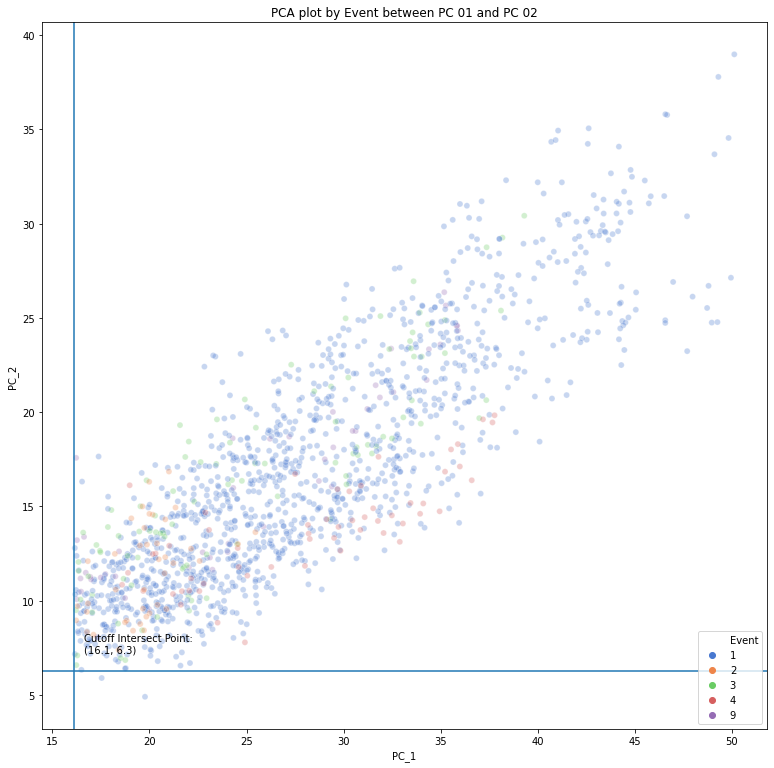

In [ ]:
# PCA plot by Event between PC 01 and PC 02
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[1], data = df3[meetsThresholdProb1], hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 02')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 0.5, cutoff_PC02 + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC02,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC02,0) # Draw horizontal cutoff point

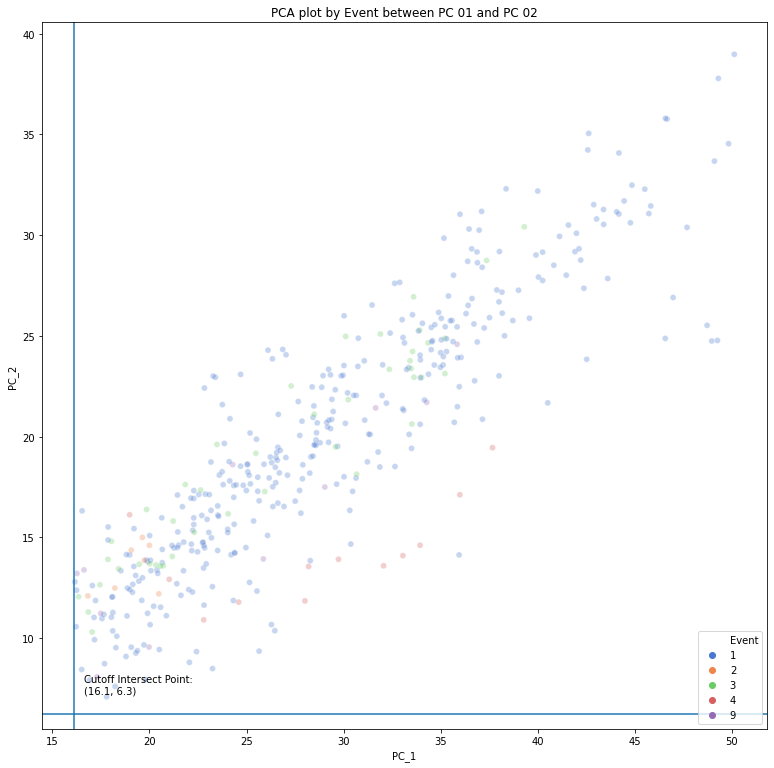

In [ ]:
# PCA plot by Event between PC 01 and PC 02
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (13,13))
sns.scatterplot(x = pcNameList[0], y = pcNameList[1], data = df3[meetsThresholdProb2], hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 02')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(cutoff_PC01 + 0.5, cutoff_PC02 + 1, ("Cutoff Intersect Point:\n(" + str(round(cutoff_PC01,1)) + ", " + str (round(cutoff_PC02,1)) + ")"))

# Draw cut off points
plt.axvline(cutoff_PC01,0) # Draw vertical cutoff point
plt.axhline(cutoff_PC02,0) # Draw horizontal cutoff point

## Break Point A: Save and Reload Data (Baseline with Threshold probabilities)

This step is to save time, since it takes a very long time to process the data to get to this stage

### Initialise conditions

In [ ]:
# Initialise save / load conditions
xlsfile = "../MainData/pothole_records_20200316_bike/AndroSensor_Consolidated/processedPCData_A4.xlsx"
ws = 'Data'

### Save data

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# save dataframe as excel file
df3.to_excel(xlsfile, sheet_name=ws)

# Print Execution time
print("%s" % (time.time() - start_time))

### Load data

In [ ]:
# Load Data
df3 = pd.read_excel(io = xlsfile, sheet_name = ws)

# Inspect Data
df3.head()

,Unnamed: 0,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,probThres_pc2
0,0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,0.0
1,1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,0.0
2,2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,0.0
3,3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,0.0
4,4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,0.0


In [ ]:
# Drop additional index column created
df3 = df3.loc[:, "SN": "probThres_pc2"]

# Inspect Data
df3.shape

(340105, 41)

In [ ]:
# Inspect Data
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0


## Inspect distribution of tagged pothole events

There is quite a bit of overlap in the non-pothole events with pothole events. Hence, retagging may be needed.

In [ ]:
# Set filters
supervisedFilter0 =  df3['Event'] != 1
supervisedFilter1 =  df3['Event'] == 1

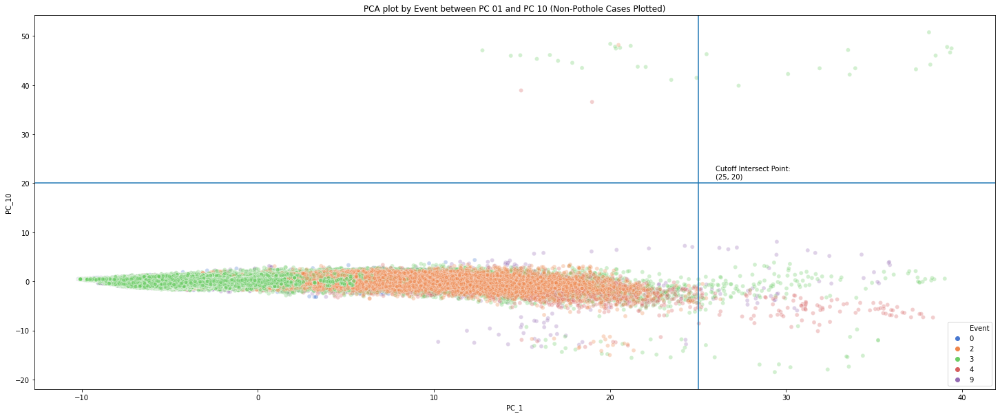

In [ ]:
# PCA plot by Event between PC 01 and PC 010
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (25,10))
sns.scatterplot(x = "PC_1", y = "PC_10", data = df3[supervisedFilter0], hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 10 (Non-Pothole Cases Plotted)')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(25 + 1, 20 + 1, ("Cutoff Intersect Point:\n(" + str(25) + ", " + str (20) + ")"))

# Draw cut off points
plt.axvline(25,0) # Draw vertical cutoff point
plt.axhline(20,0) # Draw horizontal cutoff point

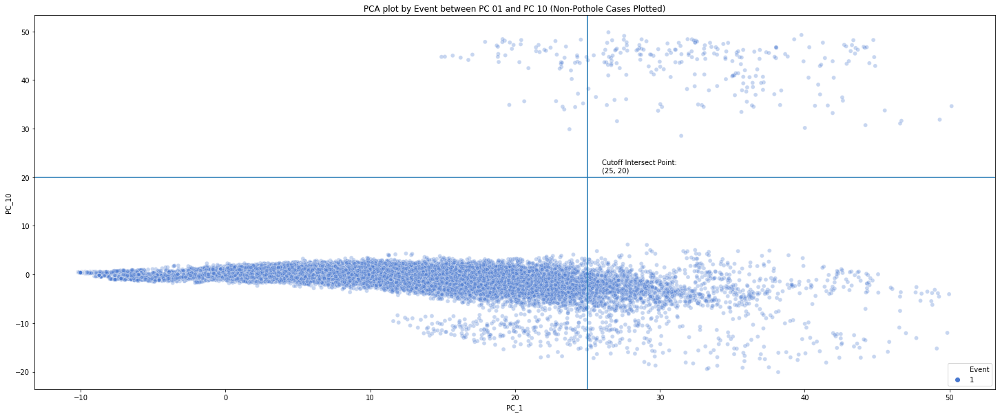

In [ ]:
# PCA plot by Event between PC 01 and PC 10
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (25,10))
sns.scatterplot(x = "PC_1", y = "PC_10", data = df3[supervisedFilter1], hue='Event', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 10 (Non-Pothole Cases Plotted)')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(25 + 1, 20 + 1, ("Cutoff Intersect Point:\n(" + str(25) + ", " + str (20) + ")"))

# Draw cut off points
plt.axvline(25,0) # Draw vertical cutoff point
plt.axhline(20,0) # Draw horizontal cutoff point

## Local Outlier Factor (LOF) Clustering of PC Eigenvectors (PC 1-10)

Preliminary results don't look very good as there is poor separation of the variables.

### Perform LOF Clustering

In [ ]:
# Define a selection PC for clustering
pcSelection = df3.loc[:, "PC_1":"PC_10"]
pcSelection.head()

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10
0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426
1,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015
2,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336
3,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946
4,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045


In [ ]:
# fit the model for outlier detection (default)
clf = LocalOutlierFactor(n_neighbors=100, contamination=0.1)

# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# use fit_predict to compute the predicted labels of the training samples
# (when LOF is used for outlier detection, the estimator has no predict,
# decision_function and score_samples methods).

y_pred = clf.fit_predict(pcSelection) # predicted outcomes of outliers (-1) and non-outliers (1)
X_scores = clf.negative_outlier_factor_ # predicted score of outliers: more -ve the value, the more likely the observation to be an outlier

# Print Execution time
print("%s" % (time.time() - start_time))

113.5828332901001


In [ ]:
# Clean up outputs and append data
df3["LOF_pred"] = pd.Series(y_pred).replace([-1,1],[1,0]) # reclassed: 1 = outlier; 0 = non-outlier
df3["LOF_score"] = pd.Series(1 - (X_scores - min(X_scores)) / (max(X_scores) - min(X_scores))) # rescaled using min-max scaling; the close the value tends to 1, the more likely that it is an outlier

# inspect data
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,LOF_pred,LOF_score
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,1,0.230193
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,1,0.170472
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,1,0.169825
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,1,0.212789
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,1,0.175732


In [ ]:
#min(df3["LOF_pred"] )
#(df3["LOF_pred"] == 0)

print(df3.shape[0])
print(len(df3[(df3["LOF_pred"] == 0)]))
print(len(df3[(df3["LOF_pred"] == 1)]))
print(len(df3[(df3["LOF_pred"] == 0)]) + len(df3[(df3["LOF_pred"] == 1)]))

340105
306094
34011
340105


### Inspect clusters

In [ ]:
# Set filters
supervisedFilter0 =  df3['Event'] != 1
supervisedFilter1 =  df3['Event'] == 1

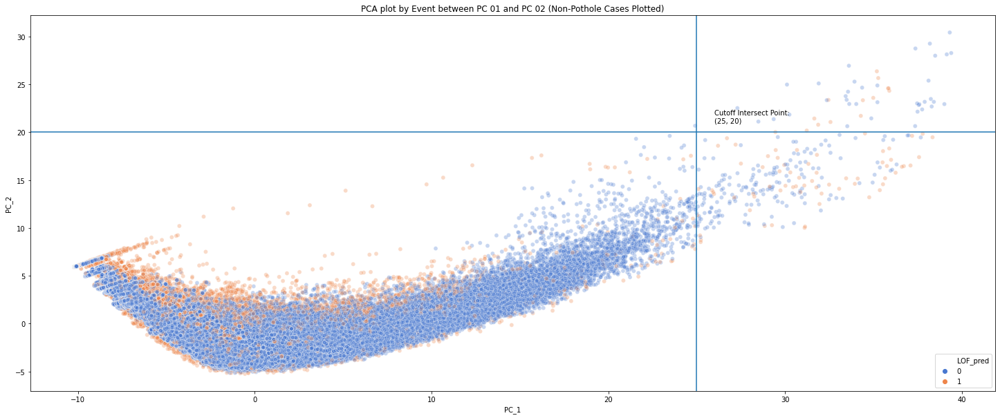

In [ ]:
# PCA plot by Event between PC 01 and PC 02
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (25,10))
sns.scatterplot(x = "PC_1", y = "PC_2", data = df3[supervisedFilter0], hue='LOF_pred', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 02 (Non-Pothole Cases Plotted)')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(25 + 1, 20 + 1, ("Cutoff Intersect Point:\n(" + str(25) + ", " + str (20) + ")"))

# Draw cut off points
plt.axvline(25,0) # Draw vertical cutoff point
plt.axhline(20,0) # Draw horizontal cutoff point

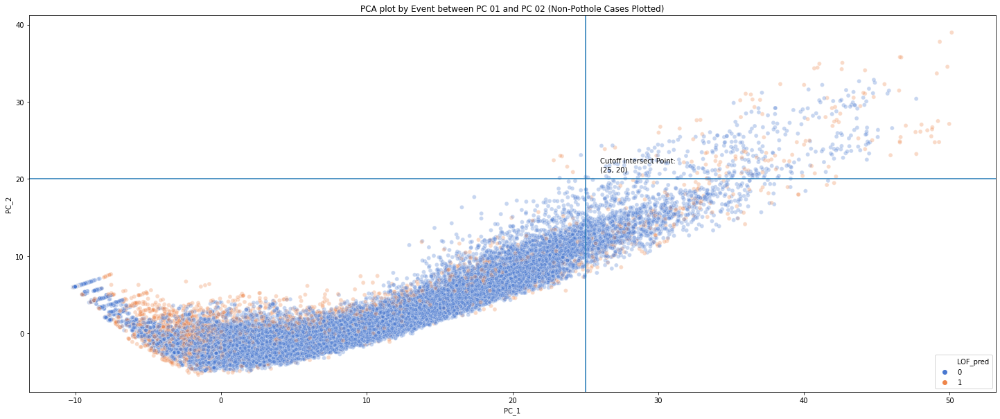

In [ ]:
# PCA plot by Event between PC 01 and PC 02
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (25,10))
sns.scatterplot(x = "PC_1", y = "PC_2", data = df3[supervisedFilter1], hue='LOF_pred', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 02 (Non-Pothole Cases Plotted)')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(25 + 1, 20 + 1, ("Cutoff Intersect Point:\n(" + str(25) + ", " + str (20) + ")"))

# Draw cut off points
plt.axvline(25,0) # Draw vertical cutoff point
plt.axhline(20,0) # Draw horizontal cutoff point

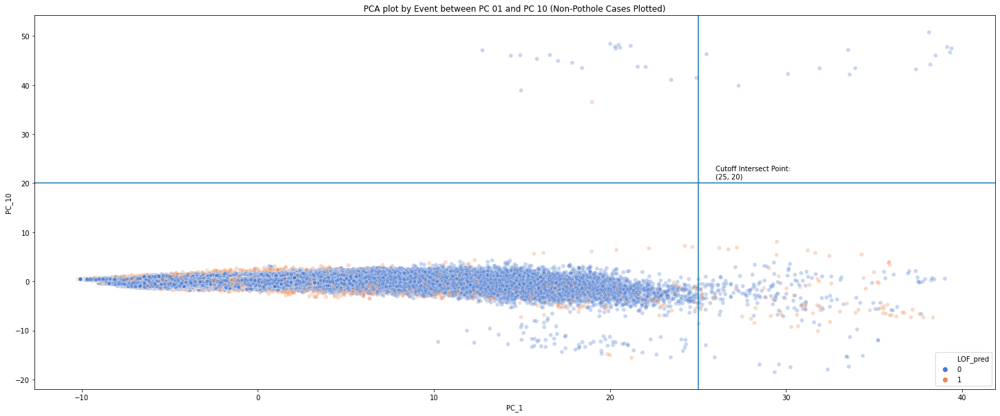

In [ ]:
# PCA plot by Event between PC 01 and PC 10
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (25,10))
sns.scatterplot(x = "PC_1", y = "PC_10", data = df3[supervisedFilter0], hue='LOF_pred', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 10 (Non-Pothole Cases Plotted)')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(25 + 1, 20 + 1, ("Cutoff Intersect Point:\n(" + str(25) + ", " + str (20) + ")"))

# Draw cut off points
plt.axvline(25,0) # Draw vertical cutoff point
plt.axhline(20,0) # Draw horizontal cutoff point

## Break Point B: Save and Reload Data (with LOF Clusters)

This step is to save time, since it takes a very long time to process the data to get to this stage

### Initialise conditions

In [ ]:
# Initialise save / load conditions
xlsfile = "../MainData/pothole_records_20200316_bike/AndroSensor_Consolidated/processedPCData_A5b.xlsx" # a file variant with the LOF cluster data is loaded instead
ws = 'Data'

### Save data

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# save dataframe as excel file
df3.to_excel(xlsfile, sheet_name=ws)

# Print Execution time
print("%s" % (time.time() - start_time))

280.7926368713379


### Load data

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# Load Data
df3 = pd.read_excel(io = xlsfile, sheet_name = ws)

# Inspect Data
df3.head()

# Print Execution time
print("%s" % (time.time() - start_time))

118.73282623291016


In [ ]:
# Drop additional index column created
df3 = df3.loc[:, "SN": "LOF_score"]

# Inspect Data
df3.shape

(340105, 43)

In [ ]:
# Inspect Data
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,LOF_pred,LOF_score
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,1,0.230193
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,1,0.170472
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,1,0.169825
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,1,0.212789
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,1,0.175732


## HDBSCAN Clustering of PC Eigenvectors (PC 1-10)

References:

*   https://pypi.org/project/hdbscan/ 
*   https://hdbscan.readthedocs.io/en/latest/faq.html 
*   https://nbviewer.jupyter.org/github/scikit-learn-contrib/hdbscan/blob/master/notebooks/How%20HDBSCAN%20Works.ipynb 


### Inspect Data

In [ ]:
# Inspect Data
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,LOF_pred,LOF_score
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,1,0.230193
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,1,0.170472
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,1,0.169825
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,1,0.212789
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,1,0.175732


In [ ]:
# Inspect Selection
cluster_data = df3.loc[::, "PC_1": "PC_10"]
cluster_data

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10
0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426
1,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015
2,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336
3,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946
4,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045
...,...,...,...,...,...,...,...,...,...,...
340100,-1.720327,-0.271699,-0.784162,1.479896,-1.216113,-1.832380,2.567013,1.078506,2.991466,0.755245
340101,-1.460815,1.543866,-0.482957,2.813971,-2.223719,-3.950836,1.790430,1.638368,2.231347,-0.604236
340102,0.841112,4.284766,0.272827,8.228412,-0.641946,-11.692796,-3.034787,1.481222,1.483960,-2.141641
340103,0.475695,3.513277,0.370571,7.269694,-0.857727,-10.593081,-2.521473,1.401654,1.449877,-2.034436


### HDBSCAN
Maximum number of clusters generated = 4

Speculation: Could be due to the lack of samples of other events such as speed stripes, humps and stationary.

#### Run 1: Min Cluster Size = 1000

Number of clusters generated: 15+1

WARNING: This takes around 20min to run

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# Perform HDBSCAN on selected data
clusterer = hdbscan.HDBSCAN(min_cluster_size=1000, gen_min_span_tree=True)
clusterer.fit(cluster_data)

# Print Execution time
print("%s" % (time.time() - start_time))

334.383047580719


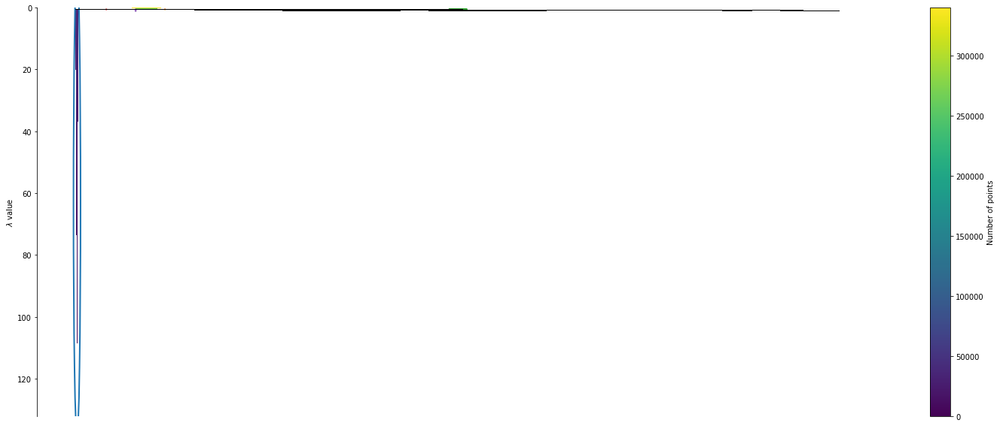

In [ ]:
# Extract clusters
plt.figure(figsize = (25,10)) # Control figure size
clusterer.condensed_tree_.plot(select_clusters=True, selection_palette=sns.color_palette())

In [ ]:
clusterLabels = clusterer.labels_
clusterLabels_Prob = clusterer.probabilities_

print(max(clusterLabels))
print(min(clusterLabels))

4
-1


#### Append Clusters to Dataset

Clustering is not giving very good results, misclassifying a fair bit of the data is outliers.

Potential work around solution:

*   Collect more data of other events (stationary, speed stripes, normal cycling, humps) --> this can be difficult due to the ongoing CB lockdown
*   Combine cluster result with thresholding of PCA results, as outliers (-1) are more likely to be potholes than other zones.
*   Weighted average of thresholding results based on the amount of explainable variance by each PC could be used (eigenvalues can be used as a proxy for selecting weights)



In [ ]:
# Append cluster data to main dataset
df3["HDBSCAN_label"] = clusterLabels
df3["HDBSCAN_prob"] = clusterLabels_Prob

# Inspect data
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,LOF_pred,LOF_score,HDBSCAN_label,HDBSCAN_prob
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,1,0.230193,0,0.205220
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,1,0.170472,0,0.203801
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,1,0.169825,0,0.206051
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,1,0.212789,0,0.211460
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,1,0.175732,0,0.211383


### Compare Generated Clusters with Tagged Events

In [ ]:
# Set filters
supervisedFilter10 =  df3['HDBSCAN_label'] != -1
supervisedFilter11 =  df3['HDBSCAN_label'] == -1

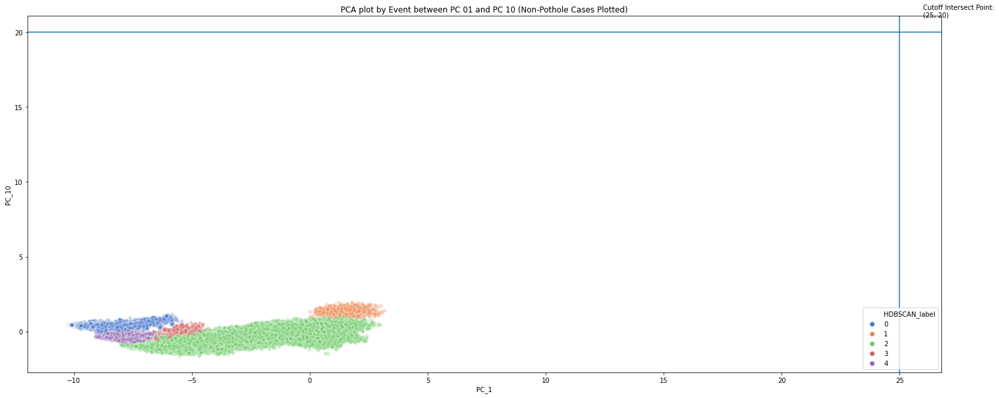

In [ ]:
# PCA plot by Event between PC 01 and PC 02
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (25,10))
sns.scatterplot(x = "PC_1", y = "PC_10", data = df3[supervisedFilter10], hue='HDBSCAN_label', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 10 (Non-Pothole Cases Plotted)')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(25 + 1, 20 + 1, ("Cutoff Intersect Point:\n(" + str(25) + ", " + str (20) + ")"))

# Draw cut off points
plt.axvline(25,0) # Draw vertical cutoff point
plt.axhline(20,0) # Draw horizontal cutoff point

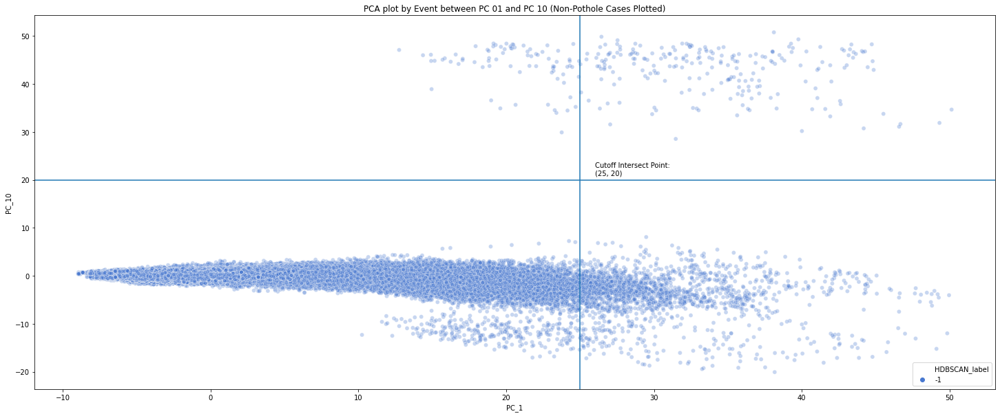

In [ ]:
# PCA plot by Event between PC 01 and PC 02
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (25,10))
sns.scatterplot(x = "PC_1", y = "PC_10", data = df3[supervisedFilter11], hue='HDBSCAN_label', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 10 (Non-Pothole Cases Plotted)')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(25 + 1, 20 + 1, ("Cutoff Intersect Point:\n(" + str(25) + ", " + str (20) + ")"))

# Draw cut off points
plt.axvline(25,0) # Draw vertical cutoff point
plt.axhline(20,0) # Draw horizontal cutoff point

## Break Point C: Save and Reload Data (with HDBSCAN Clusters)

This step is to save time, since it takes a very long time to process the data to get to this stage

### Initialise conditions

In [ ]:
# Initialise save / load conditions
xlsfile = "../MainData/pothole_records_20200316_bike/AndroSensor_Consolidated/processedPCData_A5c.xlsx" # a file variant with the LOF cluster data is loaded instead
ws = 'Data'

### Save data

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# save dataframe as excel file
df3.to_excel(xlsfile, sheet_name=ws)

# Print Execution time
print("%s" % (time.time() - start_time))

295.6792149543762


### Load data

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# Load Data
df3 = pd.read_excel(io = xlsfile, sheet_name = ws)

# Print Execution time
print("%s" % (time.time() - start_time))


124.06560587882996


In [ ]:
# Inspect Data
df3.head()

,Unnamed: 0,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,LOF_pred,LOF_score,HDBSCAN_label,HDBSCAN_prob
0,0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,1,0.230193,0,0.205220
1,1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,1,0.170472,0,0.203801
2,2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,1,0.169825,0,0.206051
3,3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,1,0.212789,0,0.211460
4,4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,1,0.175732,0,0.211383


In [ ]:
# Drop additional index column created
df3 = df3.loc[:, "SN": "HDBSCAN_prob"]

# Inspect Data
df3.shape

(340105, 45)

In [ ]:
# Inspect Data
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,LOF_pred,LOF_score,HDBSCAN_label,HDBSCAN_prob
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,1,0.230193,0,0.205220
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,1,0.170472,0,0.203801
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,1,0.169825,0,0.206051
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,1,0.212789,0,0.211460
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,1,0.175732,0,0.211383


## K Means Clustering of PC Eigenvectors (PC 1-10)


### Main Run

In [ ]:
# Inspect Selection
cluster_data = df3.loc[::, "PC_1": "PC_10"]
cluster_data

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10
0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426
1,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015
2,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336
3,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946
4,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045
...,...,...,...,...,...,...,...,...,...,...
340100,-1.720327,-0.271699,-0.784162,1.479896,-1.216113,-1.832380,2.567013,1.078506,2.991466,0.755245
340101,-1.460815,1.543866,-0.482957,2.813971,-2.223719,-3.950836,1.790430,1.638368,2.231347,-0.604236
340102,0.841112,4.284766,0.272827,8.228412,-0.641946,-11.692796,-3.034787,1.481222,1.483960,-2.141641
340103,0.475695,3.513277,0.370571,7.269694,-0.857727,-10.593081,-2.521473,1.401654,1.449877,-2.034436


In [ ]:
# Finding optimum number of clusters using the elbow plot
Sum_of_squared_distances = []
K = range(1,10)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(cluster_data)
    Sum_of_squared_distances.append(km.inertia_)

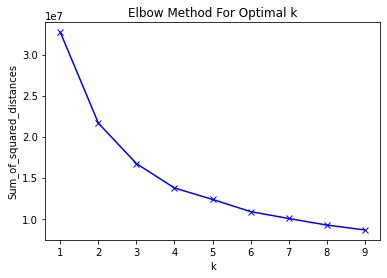

In [ ]:
# Plot elbow plot
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

In [ ]:
# Generate Silhouette plots
# Ideally the values should be positive and tending towards 1 for a good split
# This step takes VERY long if your dataset is large
kmeans = KMeans(n_clusters = 5, random_state = 20200504, max_iter = 500)
kmeans_preds = kmeans.fit_predict(cluster_data)
score = silhouette_score(cluster_data, kmeans_preds)
score

0.3480646754648233

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# Perform k means clustering
kmeans = KMeans(n_clusters = 5, random_state = 20200504, max_iter = 500)
kmeans.fit(cluster_data)

# Print Execution time
print("%s" % (time.time() - start_time))

8.666648626327515


In [ ]:
kmeans_labels = kmeans.labels_
print(min(kmeans_labels))
print(max(kmeans_labels))

0
4


In [ ]:
# Append cluster data to main dataset
df3["KMeans_label"] = kmeans_labels

# Inspect data
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,LOF_pred,LOF_score,HDBSCAN_label,HDBSCAN_prob,KMeans_label
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,1,0.230193,0,0.205220,0
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,1,0.170472,0,0.203801,0
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,1,0.169825,0,0.206051,0
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,1,0.212789,0,0.211460,0
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,1,0.175732,0,0.211383,0


In [ ]:
# Set filters
supervisedFilter0 =  df3['Event'] != 1
supervisedFilter1 =  df3['Event'] == 1

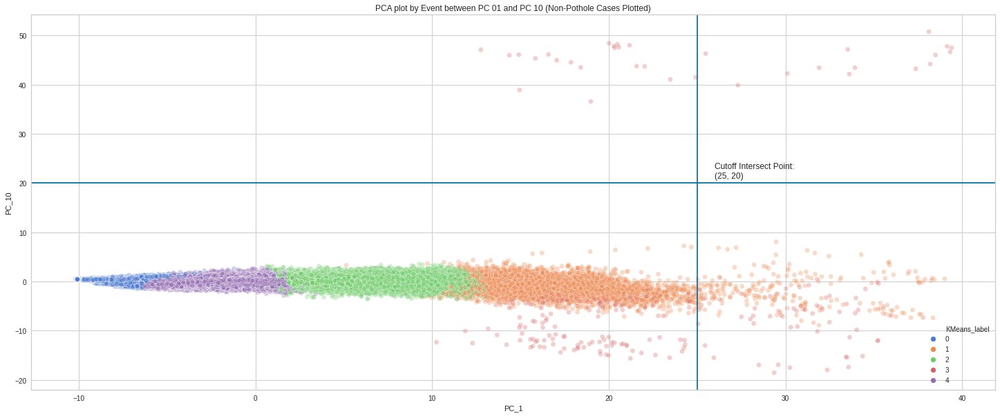

In [ ]:
# PCA plot by Event between PC 01 and PC 10
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (25,10))
sns.scatterplot(x = "PC_1", y = "PC_10", data = df3[supervisedFilter0], hue='KMeans_label', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 10 (Non-Pothole Cases Plotted)')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(25 + 1, 20 + 1, ("Cutoff Intersect Point:\n(" + str(25) + ", " + str (20) + ")"))

# Draw cut off points
plt.axvline(25,0) # Draw vertical cutoff point
plt.axhline(20,0) # Draw horizontal cutoff point

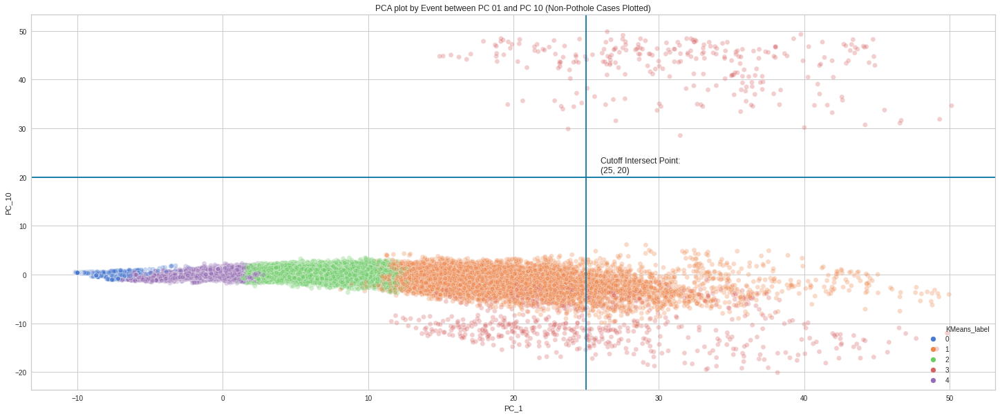

In [ ]:
# PCA plot by Event between PC 01 and PC 10
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (25,10))
sns.scatterplot(x = "PC_1", y = "PC_10", data = df3[supervisedFilter1], hue='KMeans_label', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 10 (Non-Pothole Cases Plotted)')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(25 + 1, 20 + 1, ("Cutoff Intersect Point:\n(" + str(25) + ", " + str (20) + ")"))

# Draw cut off points
plt.axvline(25,0) # Draw vertical cutoff point
plt.axhline(20,0) # Draw horizontal cutoff point

### Train-Test Validation of Clusters

Results of the clustering are consistent. Validation passed.

In [ ]:
train_data, test_data = train_test_split(df3,  test_size=0.3, random_state=20200504)

print(train_data.shape)
print(test_data.shape)

(238073, 47)
(102032, 47)


In [ ]:
# Train Data
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# Perform k means clustering
kmeans_train = KMeans(n_clusters = 5, random_state = 20200504, max_iter = 500)
kmeans_train.fit(train_data.loc[::, "PC_1": "PC_10"])

# Print Execution time
print("%s" % (time.time() - start_time))

8.357218980789185


In [ ]:
# Test Data
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# Perform k means clustering
kmeans_test = KMeans(n_clusters = 5, random_state = 20200504, max_iter = 500)
kmeans_test.fit(test_data.loc[::, "PC_1": "PC_10"])

# Print Execution time
print("%s" % (time.time() - start_time))

4.01482629776001


In [ ]:
# Train Data

kmeans_labels_train = kmeans_train.labels_
print("Number of clusters from train data:")
print(min(kmeans_labels_train))
print(max(kmeans_labels_train))

# Test Data

kmeans_labels_test = kmeans_test.labels_
print("Number of clusters from test data:")
print(min(kmeans_labels_test))
print(max(kmeans_labels_test))

Number of clusters from train data:
0
4
Number of clusters from test data:
0
4


In [ ]:
# Append cluster data to main dataset
train_data["KMeans_label_train"] = kmeans_labels_train

# Inspect data
train_data.head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,LOF_pred,probThres_pc2,LOF_score,HDBSCAN_label,HDBSCAN_prob,KMeans_label,KMeans_label_train
54124,54124,1.322045,103.673706,0.04,3.0,80.315,223018,2020-03-16 13:07:44:487,29,29,8,0,0,0,-10.148245,5.953815,0.261287,-2.019598,0.562844,-0.445226,0.705674,-0.300789,-0.029501,0.455798,-0.184156,0.318954,-0.092953,-0.579523,0.274083,0.106597,0.057012,-0.208605,0.059956,0.138185,0.020319,-0.006204,-0.101557,-0.027259,-0.012490,-0.014850,0.0,0,0.0,0.012905,0,0.594199,0,2
83454,83454,1.405570,103.821550,3.40,4.0,137.600,17453,2020-04-01 16:33:24:999,22,25,12,0,0,3,-0.325846,-2.314797,-0.992911,1.769188,-0.637808,-1.073112,1.604282,-0.651085,2.474654,0.978481,-0.963200,1.838269,1.905419,-0.017819,0.158280,0.997412,-0.678112,1.152612,-0.257637,-0.990956,1.290368,0.136106,0.523033,-0.777030,1.564893,-0.441556,0.0,0,0.0,0.011098,-1,0.000000,4,1
161444,161444,1.406598,103.821380,4.13,3.0,118.710,107877,2020-04-01 17:41:06:365,23,29,19,2,775,4,-3.197277,-0.847313,0.879038,1.968239,-4.006800,0.385035,0.366521,1.381948,-0.648697,-0.771221,1.276538,-0.419134,-0.302568,0.213672,1.066378,0.392666,-0.390309,-0.511602,-0.697888,0.884981,1.606069,-0.021513,1.225094,0.061256,0.732558,0.088984,0.0,0,0.0,0.020257,-1,0.000000,4,1
314128,314128,1.407027,103.828700,3.74,4.0,24.770,38394,2020-04-13 22:16:42:207,25,33,21,1,7677,3,-3.480496,-2.588945,-0.202169,2.439153,-0.826563,0.096032,-0.751141,0.470000,0.755468,-0.348415,-0.167289,0.507005,0.460480,-0.227461,0.082623,1.873627,-0.422225,-0.674679,0.217369,0.143657,1.615711,0.251502,0.824387,-0.051144,0.502249,-0.000551,0.0,0,0.0,0.006244,2,1.000000,4,1
3504,3504,0.000000,0.000000,0.00,0.0,0.000,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.165006,5.943108,0.289764,-2.022348,0.556733,-0.467239,0.709352,-0.305299,-0.023350,0.455687,-0.184460,0.311424,-0.089916,-0.575825,0.274356,0.107451,0.060664,-0.209223,0.061228,0.144654,0.019158,-0.017307,-0.097779,-0.027998,-0.011428,-0.021556,0.0,0,0.0,0.011827,0,0.768774,0,2


In [ ]:
# Append cluster data to main dataset
test_data["KMeans_label_test"] = kmeans_labels_test

# Inspect data
test_data.head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,LOF_pred,probThres_pc2,LOF_score,HDBSCAN_label,HDBSCAN_prob,KMeans_label,KMeans_label_test
229807,229807,1.405167,103.828080,4.3100,4.0,15.4800,18161,2020-04-13 21:59:54:635,27,34,22,3,7375,2,15.140876,4.591623,-0.780415,-2.092950,-2.154186,2.650038,0.872785,2.656350,2.601076,-1.592566,3.632943,0.524354,2.935345,1.702858,-0.849343,-0.422185,-0.989364,-2.194153,4.298722,1.659457,-1.291202,-1.577213,3.611357,-0.746799,0.572472,1.179693,0.00871,1,0.019624,0.049295,-1,0.000000,1,1
33461,33461,1.349978,103.703700,0.5805,2.0,315.5339,253667,2020-03-16 10:44:58:987,29,29,4,0,0,0,-10.169005,5.941452,0.282646,-2.022314,0.557417,-0.464714,0.708901,-0.303667,-0.019922,0.459553,-0.190010,0.310238,-0.097692,-0.578750,0.268637,0.106384,0.057378,-0.210721,0.060295,0.141793,0.021404,-0.010871,-0.102647,-0.025209,-0.011806,-0.020467,0.00000,0,0.000000,0.014477,0,0.854671,0,2
251861,251861,1.404582,103.827950,3.8200,4.0,7.2700,1070,2020-04-13 22:10:14:837,27,33,22,0,29429,3,-1.172765,-3.657950,0.650715,1.293052,0.344108,-0.338251,-0.938184,-1.640411,-1.585787,0.254090,-1.092228,-0.196177,0.238289,-1.026064,0.378064,0.513498,0.081878,-0.556939,0.644182,-0.274931,0.067718,-0.060275,-1.066322,-0.533207,-0.219436,0.255377,0.00000,0,0.000000,0.009253,2,1.000000,4,0
57492,57492,1.323278,103.654594,2.5030,3.0,130.1860,79265,2020-03-16 14:03:38:719,27,27,9,1,325,1,0.242430,-1.628380,-0.268157,0.733760,-2.034041,1.987536,-1.725183,-0.154448,0.312030,0.352903,-0.323159,-0.219406,-1.746893,-1.178419,-1.948582,1.946668,1.095641,-0.334023,-0.051765,0.581146,-1.181636,-0.036790,1.665641,0.313182,0.088961,0.611450,0.00000,0,0.000000,0.017042,-1,0.000000,4,0
203417,203417,1.401176,103.820400,5.0500,4.0,295.8800,1984,2020-04-13 22:32:40:174,23,27,20,0,40042,3,2.780529,-2.153690,-2.688053,0.356984,4.078372,0.641947,0.588001,2.945570,-0.981814,-0.506357,-0.631834,-1.758440,-1.299752,-0.039663,0.282558,1.055511,-0.898679,-0.812718,0.225062,0.158059,-0.627663,-0.042152,1.081452,-0.455361,0.935997,0.467969,0.00000,0,0.000000,0.020294,-1,0.000000,2,3


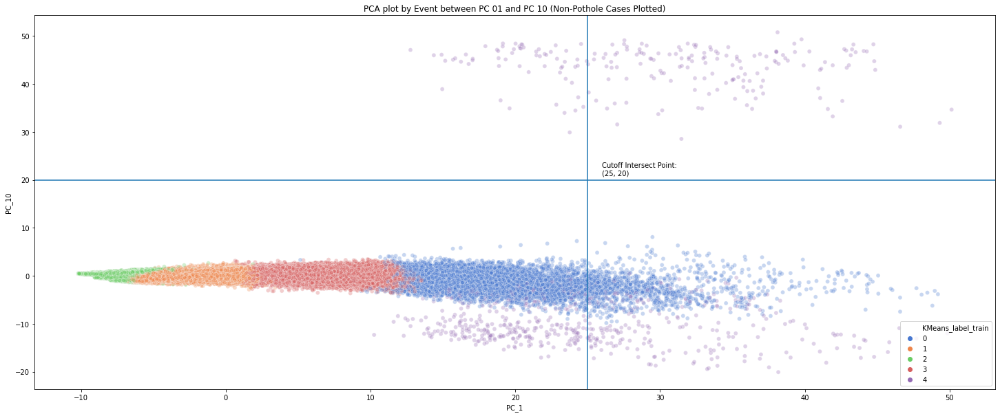

In [ ]:
# PCA plot by Event between PC 01 and PC 10
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (25,10))
sns.scatterplot(x = "PC_1", y = "PC_10", data = train_data, hue='KMeans_label_train', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 10 (Non-Pothole Cases Plotted)')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(25 + 1, 20 + 1, ("Cutoff Intersect Point:\n(" + str(25) + ", " + str (20) + ")"))

# Draw cut off points
plt.axvline(25,0) # Draw vertical cutoff point
plt.axhline(20,0) # Draw horizontal cutoff point

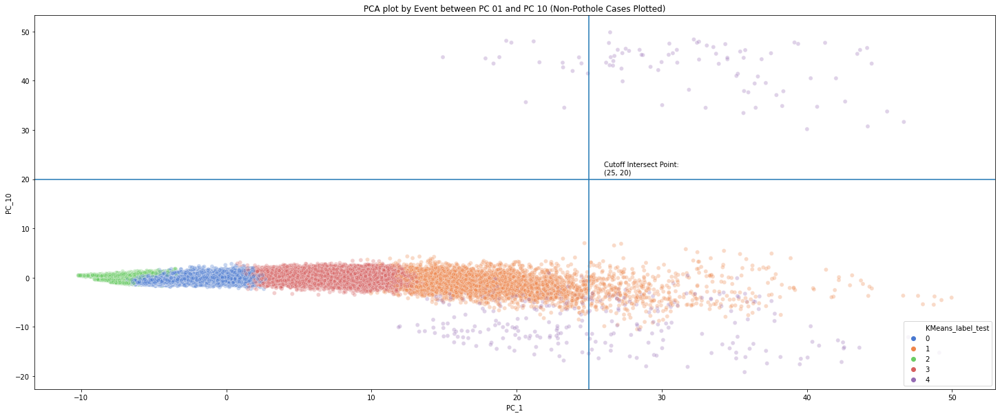

In [ ]:
# PCA plot by Event between PC 01 and PC 10
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (25,10))
sns.scatterplot(x = "PC_1", y = "PC_10", data = test_data, hue='KMeans_label_test', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 10 (Non-Pothole Cases Plotted)')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(25 + 1, 20 + 1, ("Cutoff Intersect Point:\n(" + str(25) + ", " + str (20) + ")"))

# Draw cut off points
plt.axvline(25,0) # Draw vertical cutoff point
plt.axhline(20,0) # Draw horizontal cutoff point

In [ ]:
# Remove unwanted variables

del train_data
del test_data
del kmeans_labels_train
del kmeans_labels_test

## Break Point D: Save and Reload Data (with K-Means Clusters)

This step is to save time, since it takes a very long time to process the data to get to this stage

### Initialise conditions

In [ ]:
# Initialise save / load conditions
xlsfile = "../MainData/pothole_records_20200316_bike/AndroSensor_Consolidated/processedPCData_A5d.xlsx" # a file variant with the LOF cluster data is loaded instead
ws = 'Data'

### Save data

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# save dataframe as excel file
df3.to_excel(xlsfile, sheet_name=ws)

# Print Execution time
print("%s" % (time.time() - start_time))

306.4850072860718


### Load data

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# Load Data
df3 = pd.read_excel(io = xlsfile, sheet_name = ws)

# Print Execution time
print("%s" % (time.time() - start_time))


120.14682483673096


In [ ]:
# Inspect Data
df3.head()

,Unnamed: 0,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,LOF_pred,probThres_pc2,LOF_score,HDBSCAN_label,HDBSCAN_prob,KMeans_label
0,0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,1,0.0,0.230193,0,0.205220,0
1,1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,1,0.0,0.170472,0,0.203801,0
2,2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,1,0.0,0.169825,0,0.206051,0
3,3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,1,0.0,0.212789,0,0.211460,0
4,4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,1,0.0,0.175732,0,0.211383,0


In [ ]:
# Drop additional index column created
df3 = df3.loc[:, "SN": "KMeans_label"]

# Inspect Data
df3.shape

(340105, 47)

In [ ]:
# Inspect Data
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,LOF_pred,probThres_pc2,LOF_score,HDBSCAN_label,HDBSCAN_prob,KMeans_label
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,1,0.0,0.230193,0,0.205220,0
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,1,0.0,0.170472,0,0.203801,0
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,1,0.0,0.169825,0,0.206051,0
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,1,0.0,0.212789,0,0.211460,0
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,1,0.0,0.175732,0,0.211383,0


## DBSCAN Clustering of PC Eigenvectors (PC 1-10)

In [ ]:
# Inspect Selection
cluster_data = df3.loc[::, "PC_1": "PC_10"]
cluster_data

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10
0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426
1,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015
2,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336
3,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946
4,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045
...,...,...,...,...,...,...,...,...,...,...
340100,-1.720327,-0.271699,-0.784162,1.479896,-1.216113,-1.832380,2.567013,1.078506,2.991466,0.755245
340101,-1.460815,1.543866,-0.482957,2.813971,-2.223719,-3.950836,1.790430,1.638368,2.231347,-0.604236
340102,0.841112,4.284766,0.272827,8.228412,-0.641946,-11.692796,-3.034787,1.481222,1.483960,-2.141641
340103,0.475695,3.513277,0.370571,7.269694,-0.857727,-10.593081,-2.521473,1.401654,1.449877,-2.034436


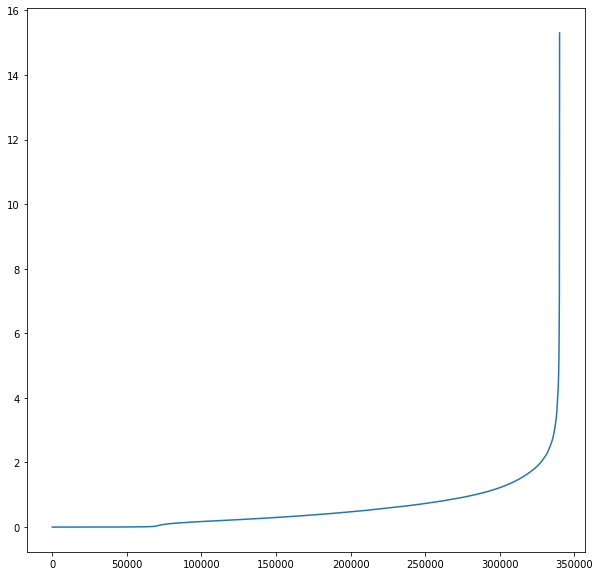

In [ ]:
# Find ideal epsilon value
neigh = NearestNeighbors(n_neighbors=10)
nbrs = neigh.fit(cluster_data)
distances, indices = nbrs.kneighbors(cluster_data)

# plot elbow plot to find inflexion point
plt.figure(figsize = (10,10))
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

#DBSCAN
DBSCAN_clustering = DBSCAN(eps=2, min_samples=100).fit(cluster_data)
DBSCAN_label = DBSCAN_clustering.labels_

# Print Execution time
print("%s" % (time.time() - start_time))

332.9003098011017


In [ ]:
max(DBSCAN_label)+2

3

In [ ]:
# Append cluster data to main dataset
df3["DBSCAN_label"] = DBSCAN_label

# Inspect data
df3.head()

,Unnamed: 0,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,LOF_pred,LOF_score,HDBSCAN_label,HDBSCAN_prob,KMeans_label,DBSCAN_label
0,0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,1,0.230193,0,0.205220,0,0
1,1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,1,0.170472,0,0.203801,0,0
2,2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,1,0.169825,0,0.206051,0,0
3,3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,1,0.212789,0,0.211460,0,0
4,4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,1,0.175732,0,0.211383,0,0


In [ ]:
# Set filters
supervisedFilter0 =  df3['Event'] != 1
supervisedFilter1 =  df3['Event'] == 1

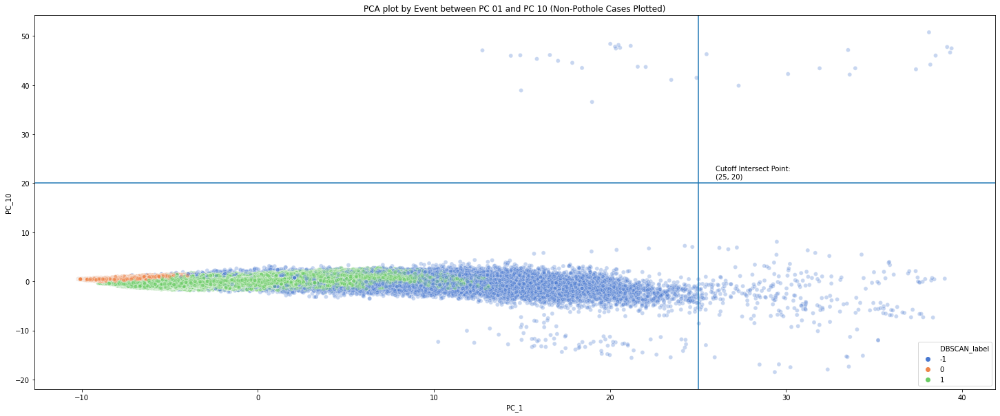

In [ ]:
# PCA plot by Event between PC 01 and PC 10
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (25,10))
sns.scatterplot(x = "PC_1", y = "PC_10", data = df3[supervisedFilter0], hue='DBSCAN_label', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 10 (Non-Pothole Cases Plotted)')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(25 + 1, 20 + 1, ("Cutoff Intersect Point:\n(" + str(25) + ", " + str (20) + ")"))

# Draw cut off points
plt.axvline(25,0) # Draw vertical cutoff point
plt.axhline(20,0) # Draw horizontal cutoff point

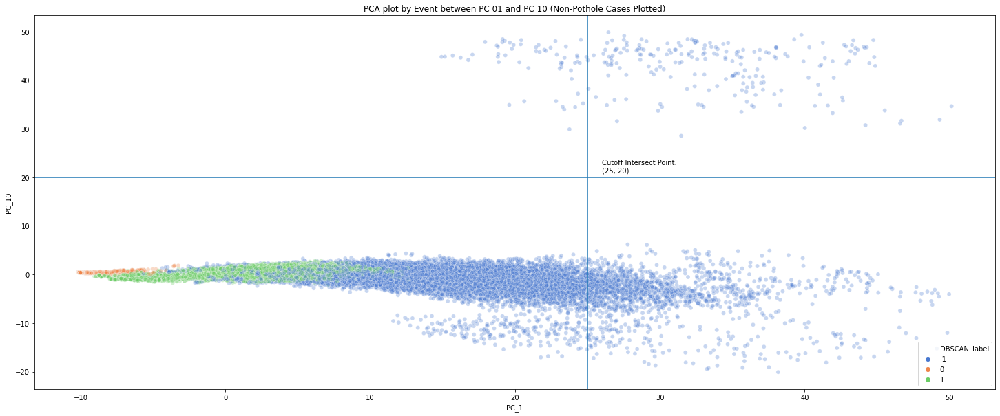

In [ ]:
# PCA plot by Event between PC 01 and PC 10
# Colour coded by event labels

# Use the 'hue' argument to provide a factor variable
plt.figure(figsize = (25,10))
sns.scatterplot(x = "PC_1", y = "PC_10", data = df3[supervisedFilter1], hue='DBSCAN_label', alpha=0.3, palette = "muted").set_title('PCA plot by Event between PC 01 and PC 10 (Non-Pothole Cases Plotted)')
 
# Move the legend to an empty part of the plot
plt.legend(loc='lower right')

# Define text of intersect point(s)
plt.text(25 + 1, 20 + 1, ("Cutoff Intersect Point:\n(" + str(25) + ", " + str (20) + ")"))

# Draw cut off points
plt.axvline(25,0) # Draw vertical cutoff point
plt.axhline(20,0) # Draw horizontal cutoff point

## Break Point E: Save and Reload Data (with DBSCAN Clusters)

This step is to save time, since it takes a very long time to process the data to get to this stage

### Initialise conditions

In [ ]:
# Initialise save / load conditions
xlsfile = "../MainData/pothole_records_20200316_bike/AndroSensor_Consolidated/processedPCData_A5e.xlsx" # a file variant with the LOF cluster data is loaded instead
ws = 'Data'

### Save data

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# save dataframe as excel file
df3.to_excel(xlsfile, sheet_name=ws)

# Print Execution time
print("%s" % (time.time() - start_time))

313.30012345314026


### Load data

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# Load Data
df3 = pd.read_excel(io = xlsfile, sheet_name = ws)

# Print Execution time
print("%s" % (time.time() - start_time))


120.76383137702942


In [ ]:
# Inspect Data
df3.head()

,Unnamed: 0,Unnamed: 0.1,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,probThres_pc2,LOF_pred,LOF_score,HDBSCAN_label,HDBSCAN_prob,KMeans_label,DBSCAN_label
0,0,0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,0.0,1,0.230193,0,0.205220,0,0
1,1,1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,0.0,1,0.170472,0,0.203801,0,0
2,2,2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,0.0,1,0.169825,0,0.206051,0,0
3,3,3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,0.0,1,0.212789,0,0.211460,0,0
4,4,4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,0.0,1,0.175732,0,0.211383,0,0


In [ ]:
# Drop additional index column created
df3 = df3.loc[:, "SN": "DBSCAN_label"]

# Inspect Data
df3.shape

(340105, 48)

In [ ]:
# Inspect Data
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,probThres_pc2,LOF_pred,LOF_score,HDBSCAN_label,HDBSCAN_prob,KMeans_label,DBSCAN_label
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,0.0,1,0.230193,0,0.205220,0,0
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,0.0,1,0.170472,0,0.203801,0,0
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,0.0,1,0.169825,0,0.206051,0,0
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,0.0,1,0.212789,0,0.211460,0,0
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,0.0,1,0.175732,0,0.211383,0,0


# Putting this all together...

So for K-means clustering and thresholding methods produces the best results, so we will be using them as an ensemble voting system to identify potholes. The 3 methods have been sorted in descending order of filter aggressiveness.

1.   Thresholding I (99.8% PC cutoff; 2 tails)
2.   Thresholding II (99% PC cutoff; 2 tails)
3.   K-Means Clustering

For both thresholding methods, we will set the cut off weighted probability to be 70% to be considered as a potential pothole. The minimum combined votes needed to be considered a pothole would be taken as between 2-3. These results would then be pushed to a HDBSCAN + DBSCAN algorithmn to cluster them on a geospatial map.



## Ensemble Voting
We will apply a voting method of the best 3 methods to determine the possibility of a pothole

In [ ]:
# Define cutoff points
thresholdCutoffProb = 0.7
thresholdCutoffProb2 = 0.8
keyCluster_kmeans = 3

In [ ]:
# Voting formula
df3["Vote"] = ((df3["probThres_pc"] >= thresholdCutoffProb) * 1) + ((df3["probThres_pc2"] >= thresholdCutoffProb2) * 1) + ((df3["KMeans_label"] == keyCluster_kmeans) * 1)

# Inspect results
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,probThres_pc2,LOF_pred,LOF_score,HDBSCAN_label,HDBSCAN_prob,KMeans_label,DBSCAN_label,Vote
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,0.0,1,0.230193,0,0.205220,0,0,0
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,0.0,1,0.170472,0,0.203801,0,0,0
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,0.0,1,0.169825,0,0.206051,0,0,0
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,0.0,1,0.212789,0,0.211460,0,0,0
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,0.0,1,0.175732,0,0.211383,0,0,0


In [ ]:
# filter observations by votes
voteFilter = df3['Vote'] >= 2

# Inspect data
print(df3[voteFilter].shape[0]) # total count
print(str(round(df3[voteFilter].shape[0] / df3.shape[0] * 100, 3))+"%") # Total % of data


622
0.183%


In [ ]:
# filter observations by votes
voteFilter2 = df3['Vote'] >= 3

# Inspect data
print(df3[voteFilter2].shape[0]) # total count
print(str(round(df3[voteFilter2].shape[0] / df3.shape[0] * 100, 3))+"%") # Total % of data

298
0.088%


## Apply HDBSCAN + DBSCAN Geospatially

This would serve as the crowdsensing module. Run this as one continuous block.

### Convert GPS Coordinates from degrees to radians

In [ ]:
# Convert GPS Coordindates to radians
df3["Latitude_rad"] = np.radians(df3["LOCATION Latitude : "])
df3["Longitude_rad"] = np.radians(df3["LOCATION Longitude : "])

# Inspect results
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,probThres_pc2,LOF_pred,LOF_score,HDBSCAN_label,HDBSCAN_prob,KMeans_label,DBSCAN_label,Vote,Latitude_rad,Longitude_rad
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,0.0,1,0.230193,0,0.205220,0,0,0,0.0,0.0
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,0.0,1,0.170472,0,0.203801,0,0,0,0.0,0.0
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,0.0,1,0.169825,0,0.206051,0,0,0,0.0,0.0
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,0.0,1,0.212789,0,0.211460,0,0,0,0.0,0.0
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,0.0,1,0.175732,0,0.211383,0,0,0,0.0,0.0


### Define Selections and parameters

In [ ]:
# Find median GPS Accuracy of observations with 2 or more votes (in m)
GPS_accuracy = df3[df3["Vote"] >= 2].loc[::, "LOCATION Accuracy ( m)"].quantile(.5)
earth_radius = 6378 # earth's radius at the equator in km (SG very near to the equator so I'll peg my results to it)
epsilon = GPS_accuracy / 1000 / earth_radius #calculate 5 meter epsilon threshold
min_cluster_size = 5

In [ ]:
# Define selection
df_geo1 = df3[df3["Vote"] >= 2]
df_geo1 = df_geo1[["SN", "LOCATION Latitude : ", "LOCATION Longitude : ", "Latitude_rad", "Longitude_rad", "Vote"]]

# Inspect results
df_geo1

,SN,LOCATION Latitude :,LOCATION Longitude :,Latitude_rad,Longitude_rad,Vote
12496,12496,1.379940,103.731510,0.024084,1.810456,2
12497,12497,1.379940,103.731510,0.024084,1.810456,2
12566,12566,1.379904,103.731460,0.024084,1.810456,2
13942,13942,1.379956,103.731490,0.024085,1.810456,2
13945,13945,1.379956,103.731490,0.024085,1.810456,2
...,...,...,...,...,...,...
230559,230559,1.405317,103.828125,0.024527,1.812143,2
230561,230561,1.405317,103.828125,0.024527,1.812143,2
230562,230562,1.405317,103.828125,0.024527,1.812143,2
246618,246618,1.404070,103.827896,0.024506,1.812139,2


In [ ]:
# Define selection
df_geo2 = df3[df3["Vote"] == 3]
df_geo2 = df_geo2[["SN", "LOCATION Latitude : ", "LOCATION Longitude : ", "Latitude_rad", "Longitude_rad", "Vote"]]

# Inspect results
df_geo2

,SN,LOCATION Latitude :,LOCATION Longitude :,Latitude_rad,Longitude_rad,Vote
20988,20988,1.357374,103.695080,0.023691,1.809821,3
20991,20991,1.357374,103.695080,0.023691,1.809821,3
20992,20992,1.357374,103.695080,0.023691,1.809821,3
21310,21310,1.356904,103.695595,0.023682,1.809830,3
33913,33913,1.349657,103.703860,0.023556,1.809974,3
...,...,...,...,...,...,...
188442,188442,1.405656,103.822464,0.024533,1.812044,3
188445,188445,1.405656,103.822464,0.024533,1.812044,3
188448,188448,1.405656,103.822464,0.024533,1.812044,3
202568,202568,1.406569,103.821370,0.024549,1.812025,3


### Apply Clustering 1

In [ ]:
# Apply clustering
clusterer1 = hdbscan.HDBSCAN(min_cluster_size = min_cluster_size, metric='haversine', cluster_selection_epsilon=epsilon, cluster_selection_method = 'eom')
predictions1 = clusterer.fit_predict(df_geo1.loc[::, "Latitude_rad":"Longitude_rad"])

# Number of clusters
print(max(predictions1) + 2)

52


In [ ]:
# Append results to dataframe
df_geo1["Cluster1"] = predictions1

# Inspect results
df_geo1

,SN,LOCATION Latitude :,LOCATION Longitude :,Latitude_rad,Longitude_rad,Vote,Cluster1
12496,12496,1.379940,103.731510,0.024084,1.810456,2,0
12497,12497,1.379940,103.731510,0.024084,1.810456,2,0
12566,12566,1.379904,103.731460,0.024084,1.810456,2,0
13942,13942,1.379956,103.731490,0.024085,1.810456,2,0
13945,13945,1.379956,103.731490,0.024085,1.810456,2,0
...,...,...,...,...,...,...,...
230559,230559,1.405317,103.828125,0.024527,1.812143,2,2
230561,230561,1.405317,103.828125,0.024527,1.812143,2,2
230562,230562,1.405317,103.828125,0.024527,1.812143,2,2
246618,246618,1.404070,103.827896,0.024506,1.812139,2,2


### Apply Clustering 2

In [ ]:
# Apply clustering
clusterer2 = hdbscan.HDBSCAN(min_cluster_size = min_cluster_size, metric='haversine', cluster_selection_epsilon=epsilon, cluster_selection_method = 'eom')
predictions2 = clusterer.fit_predict(df_geo2.loc[::, "Latitude_rad":"Longitude_rad"])

# Number of clusters
print(max(predictions2) + 2)

29


In [ ]:
# Append results to dataframe
df_geo2["Cluster2"] = predictions2

# Inspect results
df_geo2

,SN,LOCATION Latitude :,LOCATION Longitude :,Latitude_rad,Longitude_rad,Vote,Cluster2
20988,20988,1.357374,103.695080,0.023691,1.809821,3,-1
20991,20991,1.357374,103.695080,0.023691,1.809821,3,-1
20992,20992,1.357374,103.695080,0.023691,1.809821,3,-1
21310,21310,1.356904,103.695595,0.023682,1.809830,3,-1
33913,33913,1.349657,103.703860,0.023556,1.809974,3,16
...,...,...,...,...,...,...,...
188442,188442,1.405656,103.822464,0.024533,1.812044,3,-1
188445,188445,1.405656,103.822464,0.024533,1.812044,3,-1
188448,188448,1.405656,103.822464,0.024533,1.812044,3,-1
202568,202568,1.406569,103.821370,0.024549,1.812025,3,-1


### Merge Dataframes (Geospatial)

In [ ]:
# Merge data frame
df_geo1 = pd.merge(df_geo1, df_geo2[['SN', 'Cluster2']], on='SN', how='left')

In [ ]:
# Inspect results
df_geo1

,SN,LOCATION Latitude :,LOCATION Longitude :,Latitude_rad,Longitude_rad,Vote,Cluster1,Cluster2
0,12496,1.379940,103.731510,0.024084,1.810456,2,0,NaN
1,12497,1.379940,103.731510,0.024084,1.810456,2,0,NaN
2,12566,1.379904,103.731460,0.024084,1.810456,2,0,NaN
3,13942,1.379956,103.731490,0.024085,1.810456,2,0,NaN
4,13945,1.379956,103.731490,0.024085,1.810456,2,0,NaN
...,...,...,...,...,...,...,...,...
617,230559,1.405317,103.828125,0.024527,1.812143,2,2,NaN
618,230561,1.405317,103.828125,0.024527,1.812143,2,2,NaN
619,230562,1.405317,103.828125,0.024527,1.812143,2,2,NaN
620,246618,1.404070,103.827896,0.024506,1.812139,2,2,NaN


In [ ]:
# Delete redundant variable
del df_geo2

### Compare Suspected Points Against Ground of Truth Estimates

In [ ]:
# Reformat latitude and longtiude info
df_geo1['point'] = df_geo1.apply(lambda row: Point(latitude=row["LOCATION Latitude : "], longitude=row["LOCATION Longitude : "]), axis=1)

# inspect data
df_geo1.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,Latitude_rad,Longitude_rad,Vote,Cluster1,Cluster2,point
0,12496,1.379940,103.73151,0.024084,1.810456,2,0,NaN,"1 22m 47.784s N, 103 43m 53.436s E"
1,12497,1.379940,103.73151,0.024084,1.810456,2,0,NaN,"1 22m 47.784s N, 103 43m 53.436s E"
2,12566,1.379904,103.73146,0.024084,1.810456,2,0,NaN,"1 22m 47.6544s N, 103 43m 53.256s E"
3,13942,1.379956,103.73149,0.024085,1.810456,2,0,NaN,"1 22m 47.8416s N, 103 43m 53.364s E"
4,13945,1.379956,103.73149,0.024085,1.810456,2,0,NaN,"1 22m 47.8416s N, 103 43m 53.364s E"


In [ ]:
# List of ground of truth coordinates

GOT_latitude = [1.32206,
                1.32206,
                1.32208,
                1.32209,
                1.3224,
                1.3224,
                1.3224,
                1.3224,
                1.32241,
                1.3229,
                1.32294,
                1.32297,
                1.32301,
                1.32307,
                1.32329,
                1.32582,
                1.3263,
                1.32631,
                1.32632,
                1.34958,
                1.34972,
                1.34988,
                1.35734,
                1.37995,
                1.40562,
                1.4135,
                1.41352,
                1.41478,
                1.41498,
                1.41514,
                1.41523,
                1.41539,
                1.4157              
]

GOT_longitude = [103.67308,
                 103.67311,
                 103.67309,
                 103.67338,
                 103.67826,
                 103.67821,
                 103.67823,
                 103.67825,
                 103.67855,
                 103.65484,
                 103.65459,
                 103.65464,
                 103.65486,
                 103.65462,
                 103.6546,
                 103.6564,
                 103.65608,
                 103.65637,
                 103.65608,
                 103.70386,
                 103.70384,
                 103.70375,
                 103.69518,
                 103.73146,
                 103.82144,
                 103.81522,
                 103.79288,
                 103.80462,
                 103.80455,
                 103.80405,
                 103.80384,
                 103.80391,
                 103.80059,
              
]

# Generate Points as a List
counter = 0
GOT_coordinates = []
for item in GOT_latitude:
  new_coordinates = Point(latitude = item, longitude = GOT_longitude[counter])
  counter = counter + 1
  GOT_coordinates.append(new_coordinates)

# Append results as a dataframe (Extra step for convenience)
df_GOT = pd.DataFrame({
    "latitude": GOT_latitude,
    "longitude": GOT_longitude,
    "point": GOT_coordinates
})

# Inspect ressults
df_GOT.head()

,latitude,longitude,point
0,1.32206,103.67308,"1 19m 19.416s N, 103 40m 23.088s E"
1,1.32206,103.67311,"1 19m 19.416s N, 103 40m 23.196s E"
2,1.32208,103.67309,"1 19m 19.488s N, 103 40m 23.124s E"
3,1.32209,103.67338,"1 19m 19.524s N, 103 40m 24.168s E"
4,1.32240,103.67826,"1 19m 20.64s N, 103 40m 41.736s E"


In [ ]:
len(GOT_coordinates)

33

In [ ]:
suspected_potholes = df_geo1["point"].tolist()
len(suspected_potholes)

622

In [ ]:
def more_than_zero (number):
  return number > 0

In [ ]:
# Evaluate suspected points against estimated ground of truth

# Threshold Distance 1
threshold_dist = 15 # meters
thresholdCount_list = []

for suspect in suspected_potholes:
  thresholdCounter = 0
  for truth in GOT_coordinates:
    if ((distance.distance(truth, suspect).m) <= threshold_dist):
      thresholdCounter = thresholdCounter + 1
    else:
      thresholdCounter = thresholdCounter
  
  thresholdCount_list.append(thresholdCounter)

print("Total Count:")
print(len(thresholdCount_list))
print("Total Points on Target (Cluster Set 1):")
print(len(list(filter(more_than_zero, thresholdCount_list))))
print("Percentage of Points on Target (Cluster Set 1):")
print(
    str(
        round(len(list(filter(more_than_zero, thresholdCount_list))) / len(thresholdCount_list) * 100,3)
    ) + "%"
)

Total Count:
622
Total Points on Target (Cluster Set 1):
479
Percentage of Points on Target (Cluster Set 1):
77.01%


In [ ]:
# Evaluate suspected points against estimated ground of truth

# Threshold Distance 2
threshold_dist2 = 10 # meters
thresholdCount_list2 = []

for suspect in suspected_potholes:
  thresholdCounter = 0
  for truth in GOT_coordinates:
    if ((distance.distance(truth, suspect).m) <= threshold_dist):
      thresholdCounter = thresholdCounter + 1
    else:
      thresholdCounter = thresholdCounter
  
  thresholdCount_list2.append(thresholdCounter)

print("Total Count:")
print(len(thresholdCount_list2))
print("Total Points on Target (Cluster Set 1):")
print(len(list(filter(more_than_zero, thresholdCount_list2))))
print("Percentage of Points on Target (Cluster Set 1):")
print(
    str(
        round(len(list(filter(more_than_zero, thresholdCount_list2))) / len(thresholdCount_list2) * 100,3)
    ) + "%"
)

Total Count:
622
Total Points on Target (Cluster Set 1):
407
Percentage of Points on Target (Cluster Set 1):
65.434%


In [ ]:
# Append results to dataframe
df_geo1["onTarget_0"] = pd.Series(thresholdCount_list)
df_geo1["onTarget_1"] = pd.Series(thresholdCount_list2)

# Inspect results
df_geo1.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,Latitude_rad,Longitude_rad,Vote,Cluster1,Cluster2,point,onTarget_0,onTarget_1
0,12496,1.379940,103.73151,0.024084,1.810456,2,0,NaN,"1 22m 47.784s N, 103 43m 53.436s E",1,1
1,12497,1.379940,103.73151,0.024084,1.810456,2,0,NaN,"1 22m 47.784s N, 103 43m 53.436s E",1,1
2,12566,1.379904,103.73146,0.024084,1.810456,2,0,NaN,"1 22m 47.6544s N, 103 43m 53.256s E",1,1
3,13942,1.379956,103.73149,0.024085,1.810456,2,0,NaN,"1 22m 47.8416s N, 103 43m 53.364s E",1,1
4,13945,1.379956,103.73149,0.024085,1.810456,2,0,NaN,"1 22m 47.8416s N, 103 43m 53.364s E",1,1


In [ ]:
# Select Cluster1 Points Not Deemed As Outliers
df_geo1b = df_geo1[df_geo1["Cluster1"] > -1]

# Select Cluster2 Points
df_geo2 = df_geo1[df_geo1["Cluster2"].notnull()]

# Select Cluster2 Points Not Deemed As Outliers
df_geo2b = df_geo2[df_geo2["Cluster2"] > -1]

In [ ]:
#len(df_geo1[df_geo1["onTarget_0"] > 0])
len(df_geo1[df_geo1["onTarget_1"] > 0])

407

In [ ]:
# Get breakdown of shots on target Cluster 1

print("Total Count of Cluster 1 (All):")
print(
    df_geo1.shape[0]
)
print("Perccentage of Points on Target (" + str(threshold_dist) + "m radius):")
print(
    str(
        round(len(df_geo1[df_geo1["onTarget_0"] > 0]) / df_geo1.shape[0] * 100
            ,3
        )
    ) + "%"
)


print("Perccentage of Points on Target (" + str(threshold_dist2) + "m radius):")
print(
    str(
        round(len(df_geo1[df_geo1["onTarget_1"] > 0]) / df_geo1.shape[0] * 100
            ,3
        )
    ) + "%"
)



print("\nTotal Count of Cluster 1 (Outliers Removed):")
print(
    df_geo1b.shape[0]
)
print("Perccentage of Points on Target (" + str(threshold_dist) + "m radius):")
print(
    str(
        round(len(df_geo1b[df_geo1b["onTarget_0"] > 0]) / df_geo1b.shape[0] * 100
            ,3
        )
    ) + "%"
)


print("Perccentage of Points on Target (" + str(threshold_dist2) + "m radius):")
print(
    str(
        round(len(df_geo1b[df_geo1b["onTarget_1"] > 0]) / df_geo1b.shape[0] * 100
            ,3
        )
    ) + "%"
)


Total Count of Cluster 1 (All):
622
Perccentage of Points on Target (15m radius):
77.01%
Perccentage of Points on Target (10m radius):
65.434%

Total Count of Cluster 1 (Outliers Removed):
589
Perccentage of Points on Target (15m radius):
76.74%
Perccentage of Points on Target (10m radius):
65.195%


In [ ]:
# Get breakdown of shots on target Cluster 2

print("Total Count of Cluster 2 (All):")
print(
    df_geo2.shape[0]
)
print("Perccentage of Points on Target (" + str(threshold_dist) + "m radius):")
print(
    str(
        round(len(df_geo2[df_geo2["onTarget_0"] > 0]) / df_geo2.shape[0] * 100
            ,3
        )
    ) + "%"
)


print("Perccentage of Points on Target (" + str(threshold_dist2) + "m radius):")
print(
    str(
        round(len(df_geo2[df_geo2["onTarget_1"] > 0]) / df_geo2.shape[0] * 100
            ,3
        )
    ) + "%"
)



print("\nTotal Count of Cluster 1 (Outliers Removed):")
print(
    df_geo2b.shape[0]
)
print("Perccentage of Points on Target (" + str(threshold_dist) + "m radius):")
print(
    str(
        round(len(df_geo2b[df_geo2b["onTarget_0"] > 0]) / df_geo2b.shape[0] * 100
            ,3
        )
    ) + "%"
)


print("Perccentage of Points on Target (" + str(threshold_dist2) + "m radius):")
print(
    str(
        round(len(df_geo2b[df_geo2b["onTarget_1"] > 0]) / df_geo2b.shape[0] * 100
            ,3
        )
    ) + "%"
)

Total Count of Cluster 2 (All):
298
Perccentage of Points on Target (15m radius):
80.201%
Perccentage of Points on Target (10m radius):
69.463%

Total Count of Cluster 1 (Outliers Removed):
267
Perccentage of Points on Target (15m radius):
84.27%
Perccentage of Points on Target (10m radius):
74.906%


### Break Point F1: Save and Reload Data (with Geospatial Clusters)

This step is to save time, since it takes a very long time to process the data to get to this stage

#### Initialise conditions

In [ ]:
# Initialise save / load conditions
xlsfile = "../MainData/pothole_records_20200316_bike/AndroSensor_Consolidated/processedPCData_A5f1.xlsx" # a file variant with the LOF cluster data is loaded instead
ws = 'Data'

#### Save data

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# save dataframe as excel file
df_geo1.to_excel(xlsfile, sheet_name=ws)

# Print Execution time
print("%s" % (time.time() - start_time))

0.7339632511138916


#### Load data

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# Load Data
df_geo1 = pd.read_excel(io = xlsfile, sheet_name = ws)

# Print Execution time
print("%s" % (time.time() - start_time))


0.06898784637451172


In [ ]:
# Inspect Data
df_geo1.head()

,Unnamed: 0,SN,LOCATION Latitude :,LOCATION Longitude :,Latitude_rad,Longitude_rad,Vote,Cluster1,Cluster2,point,onTarget_0,onTarget_1
0,0,12496,1.379940,103.73151,0.024084,1.810456,2,0,NaN,"1 22m 47.784s N, 103 43m 53.436s E",1,1
1,1,12497,1.379940,103.73151,0.024084,1.810456,2,0,NaN,"1 22m 47.784s N, 103 43m 53.436s E",1,1
2,2,12566,1.379904,103.73146,0.024084,1.810456,2,0,NaN,"1 22m 47.6544s N, 103 43m 53.256s E",1,1
3,3,13942,1.379956,103.73149,0.024085,1.810456,2,0,NaN,"1 22m 47.8416s N, 103 43m 53.364s E",1,1
4,4,13945,1.379956,103.73149,0.024085,1.810456,2,0,NaN,"1 22m 47.8416s N, 103 43m 53.364s E",1,1


In [ ]:
# Drop additional index column created
df_geo1 = df_geo1.loc[:, "SN": "Cluster2"]

# Inspect Data
df_geo1.shape

(622, 8)

In [ ]:
# Inspect Data
df_geo1.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,Latitude_rad,Longitude_rad,Vote,Cluster1,Cluster2
0,12496,1.379940,103.73151,0.024084,1.810456,2,0,NaN
1,12497,1.379940,103.73151,0.024084,1.810456,2,0,NaN
2,12566,1.379904,103.73146,0.024084,1.810456,2,0,NaN
3,13942,1.379956,103.73149,0.024085,1.810456,2,0,NaN
4,13945,1.379956,103.73149,0.024085,1.810456,2,0,NaN


## Merge Data

Append geospatial clustering info to main dataset

In [ ]:
# Merge data
df3 = pd.merge(df3, df_geo1[['SN', 'Cluster1', 'Cluster2']], on='SN', how='left')

# inspect data
df3.head()

,SN,LOCATION Latitude :,LOCATION Longitude :,LOCATION Speed ( m/s),LOCATION Accuracy ( m),LOCATION ORIENTATION (Â°),Time since start in ms,YYYY-MO-DD HH-MI-SS_SSS,Sat in Range,Sat Max,Zone,Run,Seq,Event,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,probThres_pc,probThres_pc2,LOF_pred,LOF_score,HDBSCAN_label,HDBSCAN_prob,KMeans_label,DBSCAN_label,Vote,Latitude_rad,Longitude_rad,Cluster1_x,Cluster2_x,Cluster1_y,Cluster2_y
0,0,0.0,0.0,0.0,0.0,0.0,115005,2020-03-16 12:35:01:128,0,0,5,0,0,0,-10.206050,5.917744,0.305353,-2.033185,0.559728,-0.460818,0.706003,-0.284762,-0.023035,0.458426,-0.186218,0.324557,-0.099668,-0.587804,0.259718,0.103074,0.048855,-0.210993,0.059176,0.128706,0.025039,-0.014501,-0.102886,-0.029236,-0.017217,-0.010844,0.0,0.0,1,0.230193,0,0.205220,0,0,0,0.0,0.0,NaN,NaN,NaN,NaN
1,1,0.0,0.0,0.0,0.0,0.0,115055,2020-03-16 12:35:01:178,0,0,5,0,1,0,-10.191819,5.924603,0.327405,-2.032104,0.555323,-0.472076,0.703099,-0.291040,-0.032646,0.452015,-0.188023,0.323969,-0.092181,-0.572103,0.279779,0.112143,0.061254,-0.205190,0.060378,0.140924,0.017490,-0.016391,-0.095856,-0.033923,-0.014505,0.012408,0.0,0.0,1,0.170472,0,0.203801,0,0,0,0.0,0.0,NaN,NaN,NaN,NaN
2,2,0.0,0.0,0.0,0.0,0.0,115104,2020-03-16 12:35:01:227,0,0,5,0,2,0,-10.192798,5.924032,0.326325,-2.032627,0.555696,-0.470663,0.703096,-0.291468,-0.032213,0.452336,-0.188153,0.322260,-0.091917,-0.573308,0.279082,0.112861,0.060308,-0.204071,0.059626,0.138180,0.017838,-0.016606,-0.095961,-0.033237,-0.014410,0.009190,0.0,0.0,1,0.169825,0,0.206051,0,0,0,0.0,0.0,NaN,NaN,NaN,NaN
3,3,0.0,0.0,0.0,0.0,0.0,115154,2020-03-16 12:35:01:277,0,0,5,0,3,0,-10.204656,5.918564,0.307079,-2.032537,0.559165,-0.462544,0.705945,-0.284297,-0.023508,0.457946,-0.185935,0.326588,-0.099808,-0.586217,0.260778,0.102165,0.050060,-0.212445,0.060135,0.132051,0.024589,-0.016066,-0.102028,-0.028900,-0.016501,-0.013839,0.0,0.0,1,0.212789,0,0.211460,0,0,0,0.0,0.0,NaN,NaN,NaN,NaN
4,4,0.0,0.0,0.0,0.0,0.0,115204,2020-03-16 12:35:01:327,0,0,5,0,4,0,-10.194987,5.922981,0.322321,-2.032436,0.556383,-0.469876,0.703858,-0.290000,-0.031085,0.453045,-0.188264,0.323901,-0.093901,-0.575197,0.275597,0.110748,0.059181,-0.206474,0.059606,0.137945,0.018878,-0.014266,-0.097182,-0.026641,-0.010928,-0.027052,0.0,0.0,1,0.175732,0,0.211383,0,0,0,0.0,0.0,NaN,NaN,NaN,NaN


In [ ]:
df3.shape

(340105, 55)

## Break Point F2: Save and Reload Data (with Geospatial Clusters)

This step is to save time, since it takes a very long time to process the data to get to this stage

### Initialise conditions

In [ ]:
# Initialise save / load conditions
xlsfile = "../MainData/pothole_records_20200316_bike/AndroSensor_Consolidated/processedPCData_A5f2.xlsx" # a file variant with the LOF cluster data is loaded instead
ws = 'Data'

### Save data

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# save dataframe as excel file
df3.to_excel(xlsfile, sheet_name=ws)

# Print Execution time
print("%s" % (time.time() - start_time))

### Load data

In [ ]:
# Measure time taken to run function so we can figure out how long to take a break
start_time = time.time()

# Load Data
df3 = pd.read_excel(io = xlsfile, sheet_name = ws)

# Print Execution time
print("%s" % (time.time() - start_time))


BadZipFile: ignored

In [ ]:
# Inspect Data
df3.head()

In [ ]:
# Drop additional index column created
df3 = df3.loc[:, "SN": "Cluster2"]

# Inspect Data
df3.shape

In [ ]:
# Inspect Data
df3.head()